In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit

import pyQEDA as pq
import load_Intensity_function as lif
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
#from tensorflow.keras import applications
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Input, Activation, Dropout

-------------------------------------------------------------------------------------------------------------------

# I. Data

1. Structure factor:

(-0.14292649544519181-0.019966400854506156j)  real: -0.14292649544519181  imag: -0.019966400854506156
5


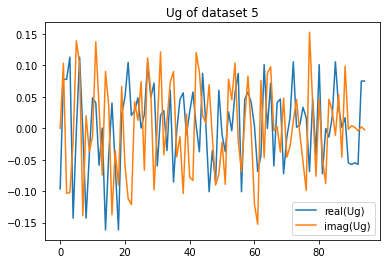

In [2]:
# load the structure vector Ug:
name =  "normalized_ZnO_r8_test_shift_200"
File = "r8_test_shift"
Nx = 70

Ug = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_labels_" + name + ".csv", dtype=complex) 

dataset = 5
print(Ug[dataset,4],' real:',np.real(Ug[dataset,4]),' imag:',np.imag(Ug[dataset,4]))
re = np.real(Ug[dataset,:])
im = np.imag(Ug[dataset,:])

plt.plot(re,label='real(Ug)')
plt.plot(im,label='imag(Ug)')
plt.legend()
plt.title('Ug of dataset '+str(dataset))
np.imag(Ug[dataset,:])-np.imag(Ug[dataset+1,:])
print(dataset)

shape of Ug_2real: (200, 95, 2)


Text(0.5, 1.0, 'first 2 sets of imag.parts of the Ug')

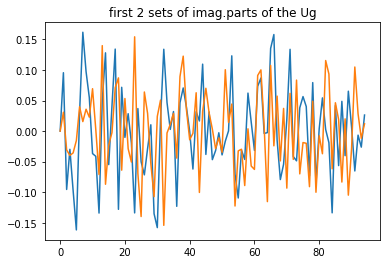

In [3]:
# Ug processing: convert complex to real
Ug_2real =[]
for i in range(0,len(Ug)):
    Ug_2real.append(np.concatenate((np.array(Ug[i].real,ndmin=2).T, np.array(Ug[i].imag,ndmin=2).T),axis=1))    
Ug_2real = np.asarray(Ug_2real)

numUg = Ug_2real.shape[1]
print('shape of Ug_2real:', Ug_2real.shape)

# Plot the first 2 sets of imaginary parts of the structure factors:
plt.plot(Ug_2real[0,:,1])
plt.plot(Ug_2real[1,:,1])
plt.title('first 2 sets of imag.parts of the Ug')

shape of Ug_2real: (200, 190)


Text(0.5, 1.0, 'Ug of dataset 5')

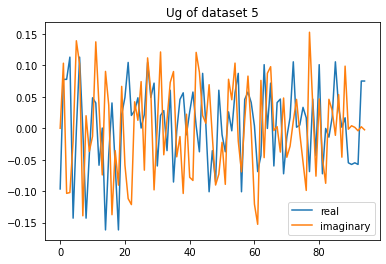

In [4]:
# combine real and imaginary numbers into one row:
# This interlaces real and imaginary numbers. 
Ug_2real = Ug_2real.reshape(-1,2*numUg)
print('shape of Ug_2real:',Ug_2real.shape)

plt.plot(Ug_2real[dataset,0:2*numUg:2],label='real')
plt.plot(Ug_2real[dataset,1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Ug of dataset '+str(dataset))

In [5]:
print(Ug_2real.max())

# Ug scaling
scaling = False
if scaling:
    scaling = Ug_2real[:,:].max()
    Ug_2real = Ug_2real/scaling
    print(scaling, Ug_2real[:,:].max(), Ug_2real[:,:].min(), Ug_2real[:,:].mean())
else:
    scaling = 1

0.19680066574215924


2. Thickness:

thickness of dataset 5: 542.0
thickness of dataset5: [0.542]


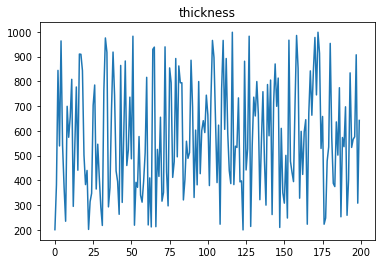

In [6]:
# load the thickness t:
t = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_thickness_" + name + ".csv", dtype=float) 
print('thickness of dataset '+str(dataset)+':', t[dataset])
plt.plot(t)
plt.title('thickness')

# normalize the thickness so that thickness belongs to (0,1)
t = t.astype('float32')
t = t/1000
t = t.reshape(-1,1)
print('thickness of dataset' +str(dataset) + ':', t[dataset])

In [7]:
# join Ug and t into Output(Y):
y = np.append(Ug_2real,t,axis=1)
print(y.dtype, y.shape)

float64 (200, 191)


3. Intensity:

Number of Tilts:  197
Number of Beams:  95
shape of exp_Intensity:  (197, 95)
shape of random_Intensity:  (200, 197, 95)
dtype and shape of X:  float64 (200, 18715)
dtype and shape of X_exp:  float64 (1, 18715)
0.9742549 0.98267344


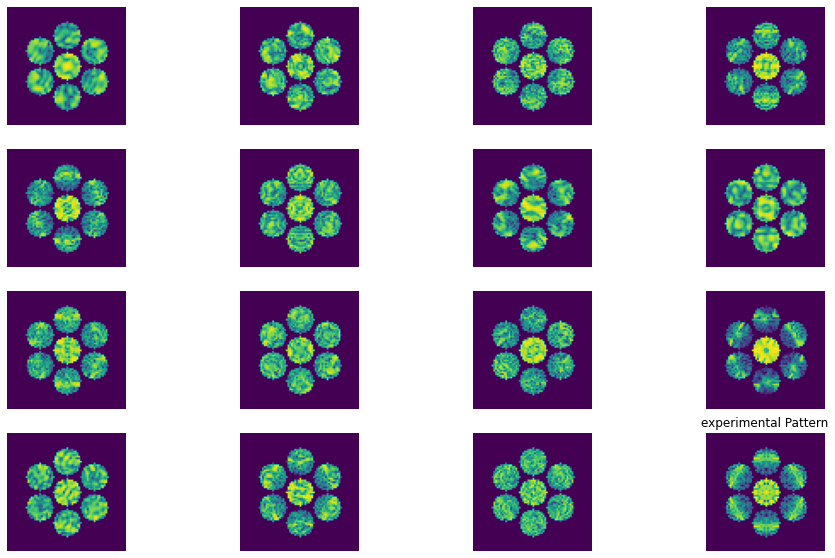

In [8]:
LoadIntensityAsInput = True  # LoadIntensityAsInput=True: load the Intensities in txt.files as Input
                              # LoadIntensityAsInput=False: use the integrated Intensities, which directly obtained from random diffraction, as Input

    
# load the intensities of experimental pattern & random diffraction pattern
# file = "ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV"
tilt_num, beam_num, exp_Intensity, random_Intensity = lif.LoadIntensity(file = File, N_training_data=200)

# load the integrated intensitis of experimental pattern & random diffraction Pattern:
random_I = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/random_diffs_" + name + ".csv", dtype=float) 
exp_I = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 

if LoadIntensityAsInput == True:    
    X = random_Intensity
    X = X.reshape(-1, tilt_num*beam_num)
    X_exp = exp_Intensity
    X_exp = X_exp.reshape(1,-1)
else:
    X = random_I
    X_exp = exp_I
    X_exp= X_exp.reshape(1,-1)
    

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)
nlogf_random_I = nlogf(random_I.reshape(-1,Nx,Nx,1))
# plot first few Diffraction Pattern:
Ncol = 4
Nrow = 4
fig,ax=plt.subplots(Nrow,Ncol,figsize=(16,10))
for j in range(Ncol*Nrow):
    plt.subplot(Nrow,Ncol,j+1)
    plt.imshow(nlogf_random_I[j])
    plt.axis('off')
        
nlogf_exp_I = nlogf(exp_I.reshape(-1,Nx,Nx,1))
plt.imshow(nlogf_exp_I[0])
plt.title('experimental Pattern')
    
print("dtype and shape of X: ", X.dtype, X.shape)    
print("dtype and shape of X_exp: ", X_exp.dtype, X_exp.shape)
print(X_exp.max(), X.max())

In [9]:
# define the size of dataset
trainsize = 100
testsize = 40
X_train = X[:trainsize,]
X_test = X[trainsize:trainsize+testsize,]
y_train = y[:trainsize,]
y_test = y[trainsize:trainsize+testsize,]

In [10]:
# check
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)
print(X_exp.shape)

(100, 18715) (100, 191)
(40, 18715) (40, 191)
(1, 18715)


---------------------------------------------------------------------------------------------------------------

# II. Neural Network

In [11]:
backend.clear_session()

target_num = y_train.shape[1]
hidden_num = int((2/3)*X_train.shape[1])

intensity_input = Input(shape=(X_train.shape[1],))
x = Dense(units=hidden_num, activation="tanh")(intensity_input)
x = Dense(units=int((1/2)*hidden_num), activation="tanh")(x)
x = Dense(units=target_num, activation="tanh")(x)
x = Dense(units=target_num, activation="tanh")(x)

model = Model(inputs=intensity_input, outputs=x)
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 18715)]           0         
_________________________________________________________________
dense (Dense)                (None, 12476)             233500816 
_________________________________________________________________
dense_1 (Dense)              (None, 6238)              77831526  
_________________________________________________________________
dense_2 (Dense)              (None, 191)               1191649   
_________________________________________________________________
dense_3 (Dense)              (None, 191)               36672     
Total params: 312,560,663
Trainable params: 312,560,663
Non-trainable params: 0
_________________________________________________________________


In [12]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name+"_ANN.h5")

_________________________________________________________________________________________________________________

# III. Replace the initial training set with new training set

>>>train the initial training set:
Epoch 1/20
5/5 [==============================] - 5s 841ms/step - loss: 0.3166 - acc: 0.2000 - val_loss: 0.3144 - val_acc: 0.0000e+00
Epoch 2/20
5/5 [==============================] - 3s 702ms/step - loss: 0.2350 - acc: 0.0000e+00 - val_loss: 0.1403 - val_acc: 0.0000e+00
Epoch 3/20
5/5 [==============================] - 3s 696ms/step - loss: 0.1111 - acc: 0.0000e+00 - val_loss: 0.0895 - val_acc: 0.0000e+00
Epoch 4/20
5/5 [==============================] - 3s 697ms/step - loss: 0.0753 - acc: 0.0000e+00 - val_loss: 0.0625 - val_acc: 0.0000e+00
Epoch 5/20
5/5 [==============================] - 3s 698ms/step - loss: 0.0559 - acc: 0.0000e+00 - val_loss: 0.0451 - val_acc: 0.0000e+00
Epoch 6/20
5/5 [==============================] - 4s 725ms/step - loss: 0.0398 - acc: 0.0000e+00 - val_loss: 0.0337 - val_acc: 0.0000e+00
Epoch 7/20
5/5 [==============================] - 4s 739ms/step - loss: 0.0299 - acc: 0.0000e+00 - val_loss: 0.0212 - val_acc: 0.0000e+00
Epo

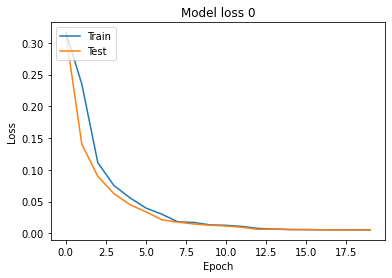

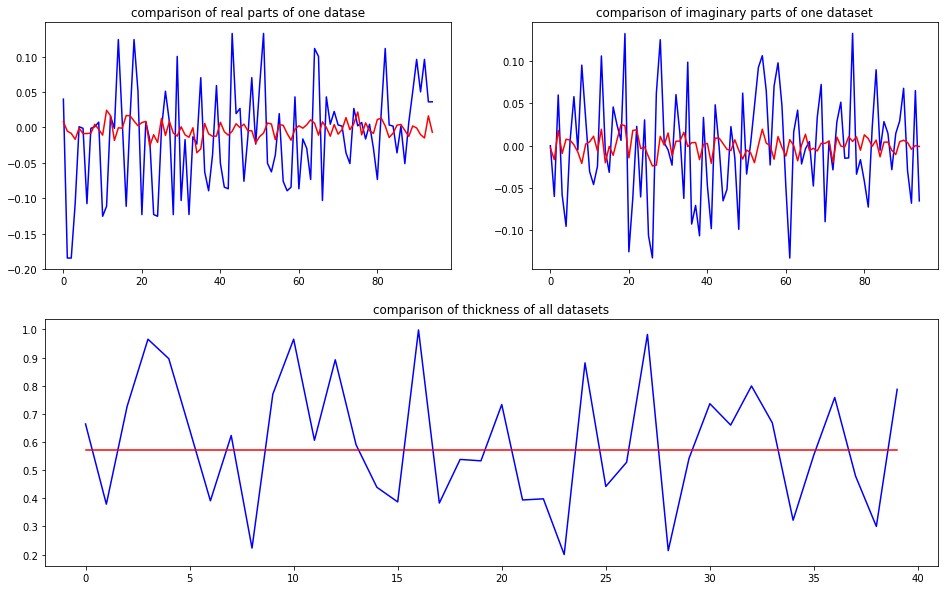

predicted thickness: 0.57309693


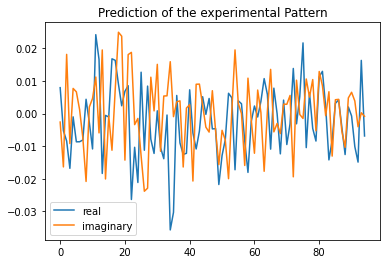

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=573.0969309806824
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00793915+0.j         -0.00683765-0.01727143j -0.00683765+0.01727143j
 -0.01273125-0.00520062j  0.00169284+0.01426129j -0.00839813+0.00705154j
 -0.01273125+0.00520062j -0.00839813-0.00

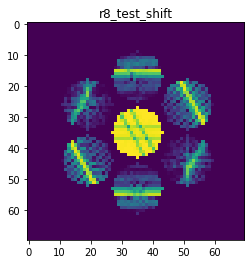

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9888206802922236
>>>replaced the 1. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 797ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 688ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000


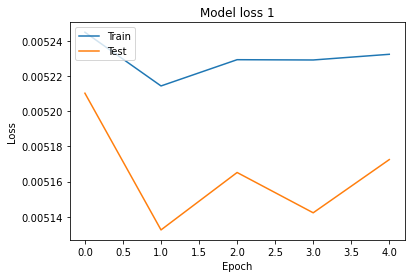

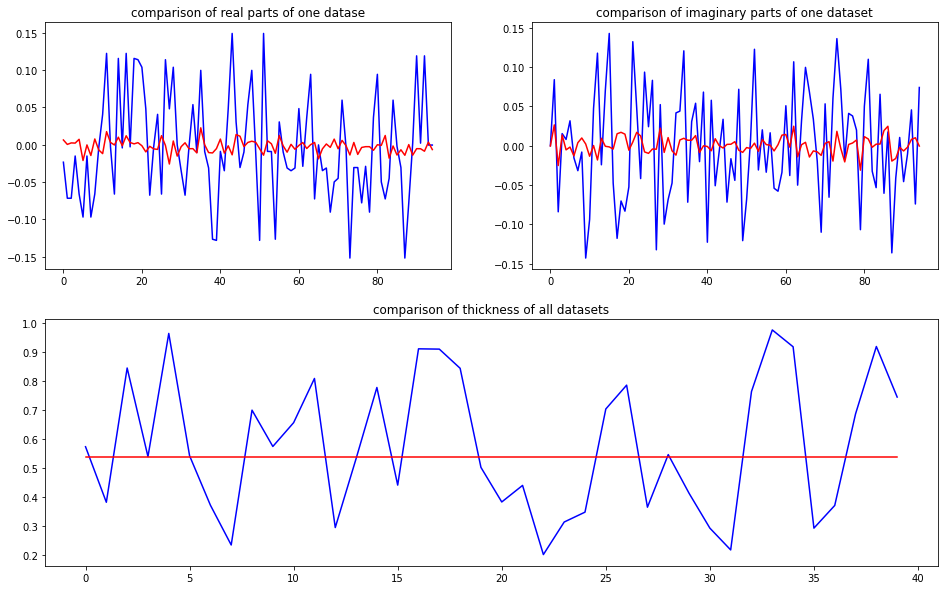

predicted thickness: 0.53834736


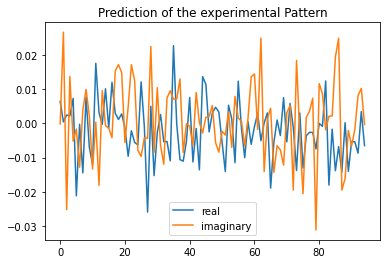

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=538.3473634719849
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 6.33462751e-03+0.j          1.33755449e-03+0.02587167j
  1.33755449e-03-0.02587167j  9.02897867e-04+0.0132358j
  7.44950306e-03-0.00755259j -1.78528503e-02-0.00280498j
  9.02897867e-04-

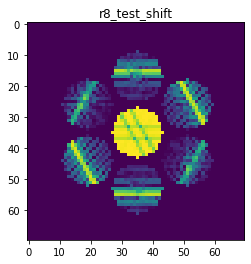

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9869457082357215
>>>replaced the 2. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 746ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000


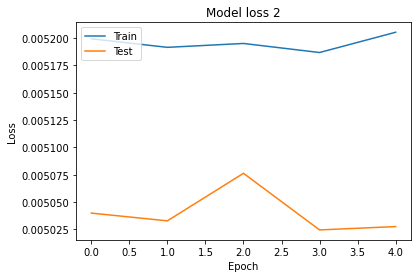

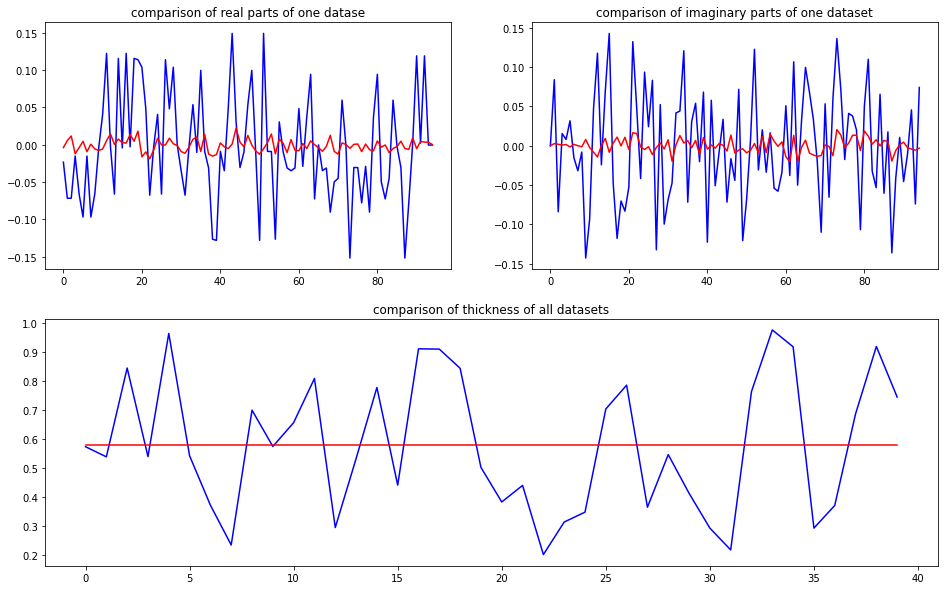

predicted thickness: 0.5804433


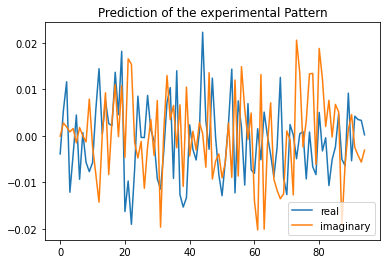

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=580.4433226585388
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-3.89045640e-03+0.j          8.56211246e-03+0.00043296j
  8.56211246e-03-0.00043296j -1.07436487e-02-0.00046785j
 -4.88266046e-03+0.00143735j  2.58286670e-03-0.00075692j
 -1.07436487e-02

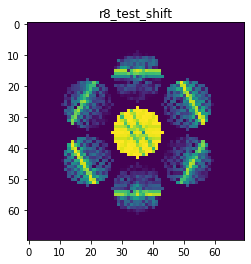

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9842872728812111
>>>replaced the 3. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 748ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


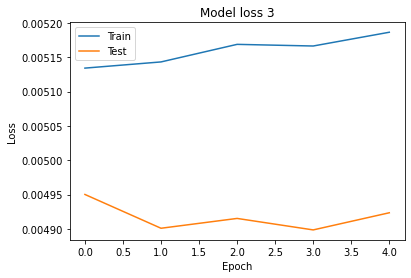

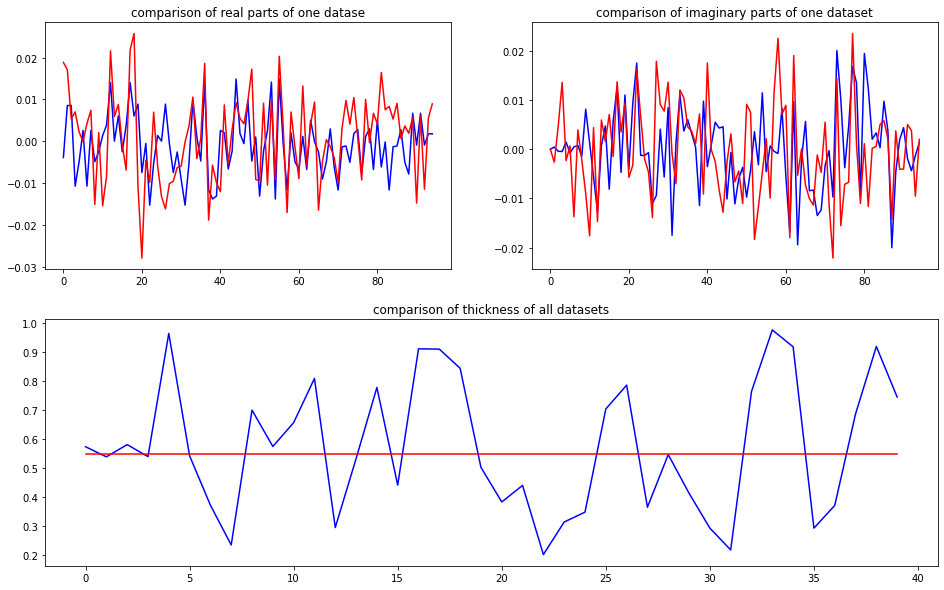

predicted thickness: 0.54913694


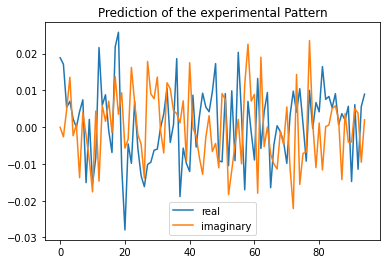

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.1369366645813
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01886158+0.00000000e+00j  0.01123409-3.67974548e-03j
  0.01123409+3.67974548e-03j  0.00563175+1.36520057e-02j
 -0.00642398-9.26262001e-05j  0.00369434-1.62854404e-03j
  0.00563175-1.3

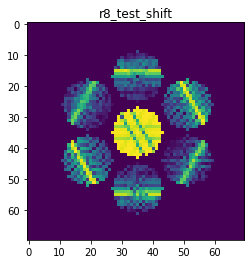

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9806711789867396
>>>replaced the 4. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 752ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 735ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000


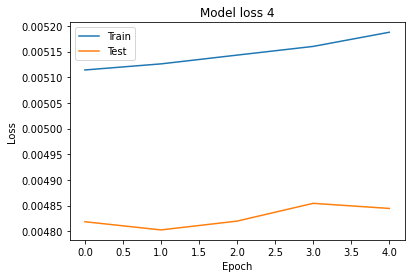

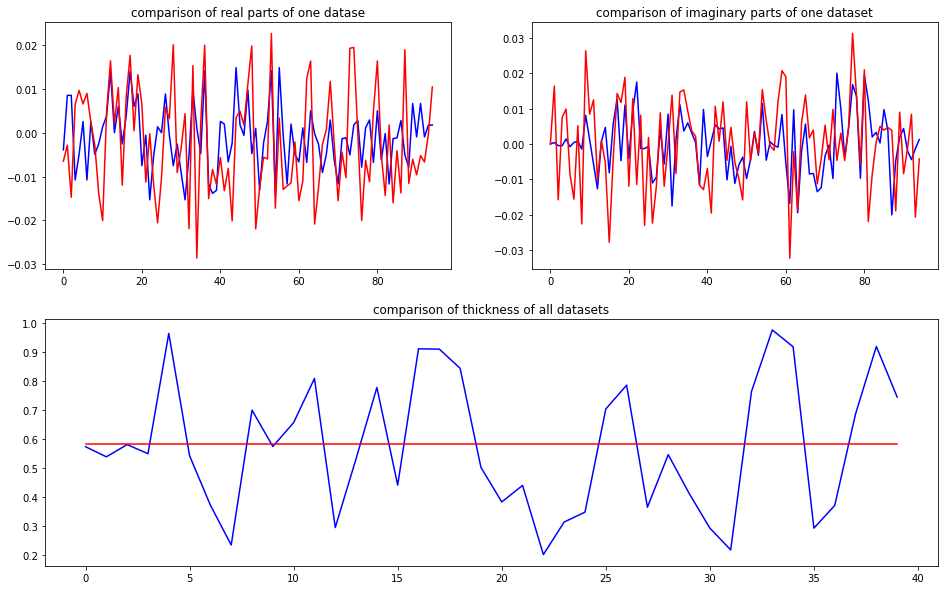

predicted thickness: 0.5807732


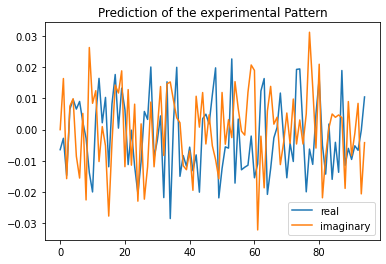

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=580.7731747627258
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00645315+0.j         -0.00872041+0.01606929j -0.00872041-0.01606929j
  0.00779501+0.01154443j  0.00350893+0.01622851j  0.00449658-0.0068743j
  0.00779501-0.01154443j  0.00449658+0.006

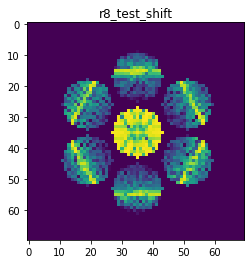

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9831581686327253
>>>replaced the 5. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 710ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000


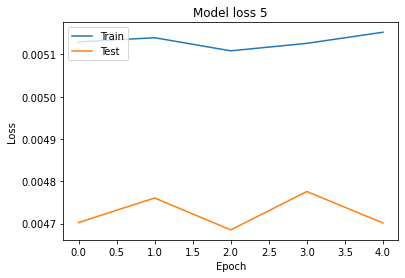

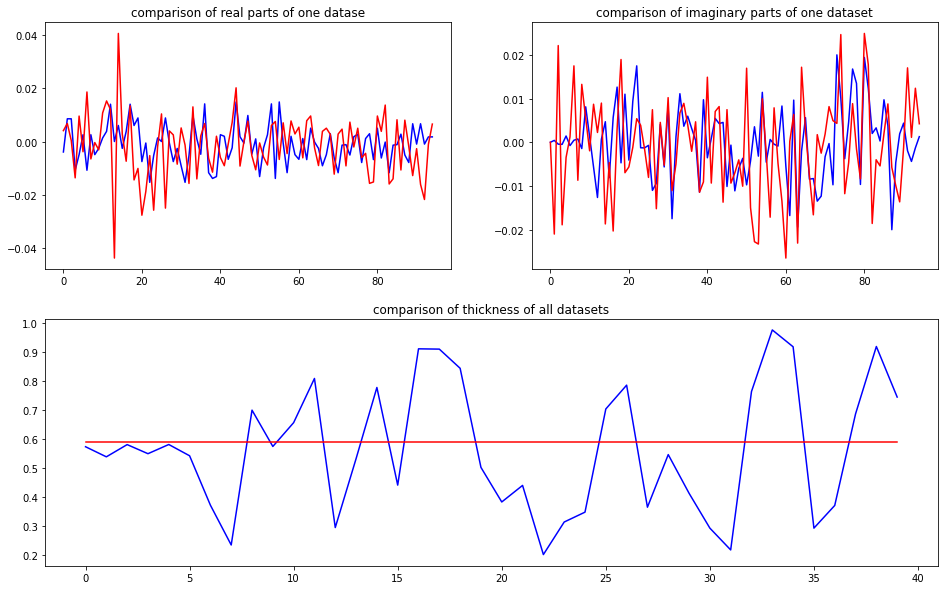

predicted thickness: 0.58871275


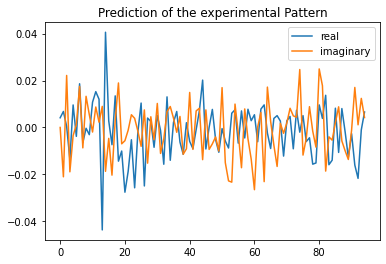

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=588.712751865387
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00412521+0.j          0.00365034-0.02160312j  0.00365034+0.02160312j
  0.00254934-0.01821903j  0.00462611-0.0083766j  -0.00514655+0.00496821j
  0.00254934+0.01821903j -0.00514655-0.004

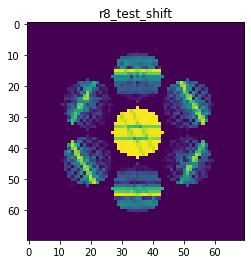

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9880181289857041
>>>replaced the 6. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 748ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 684ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000


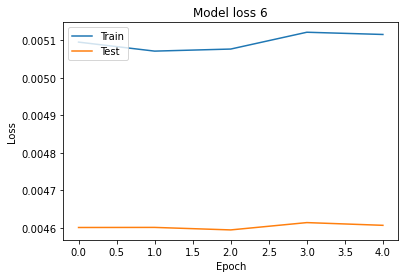

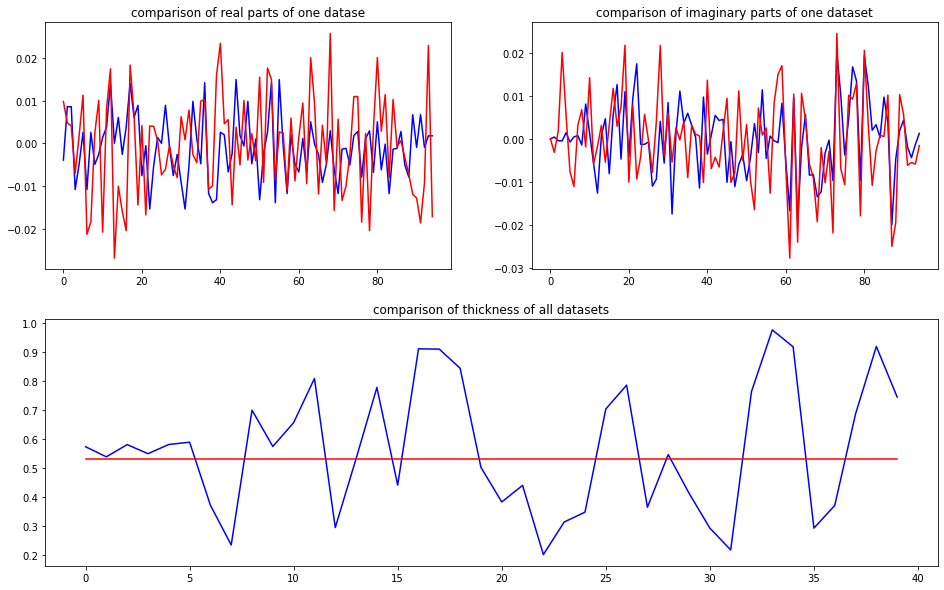

predicted thickness: 0.5317756


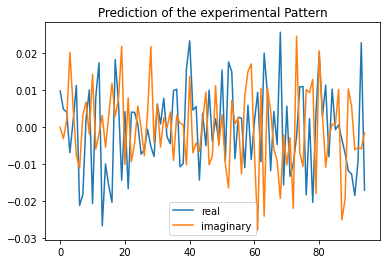

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=531.7755937576294
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00978548+0.j          0.00445521-0.00243943j  0.00445521+0.00243943j
 -0.01403848+0.01563339j  0.00201831-0.00067209j -0.00349266-0.00538796j
 -0.01403848-0.01563339j -0.00349266+0.00

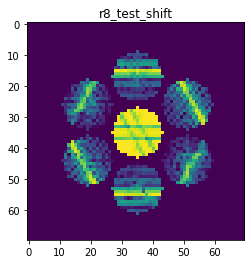

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9841492247036219
>>>replaced the 7. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 740ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000


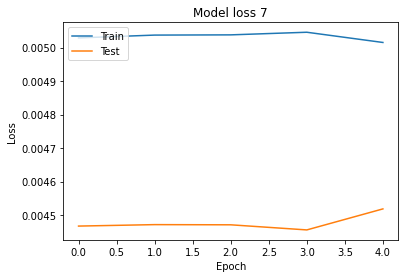

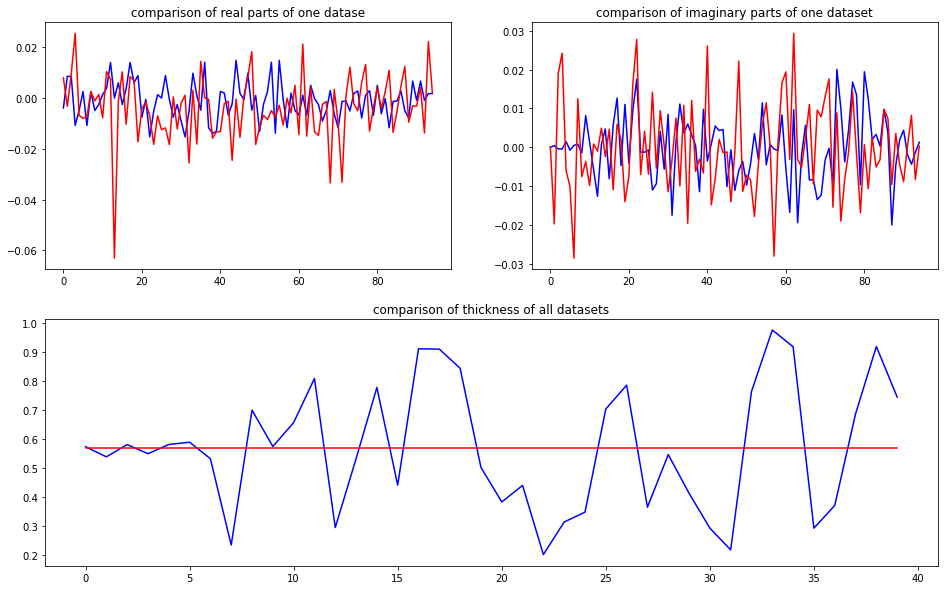

predicted thickness: 0.570409


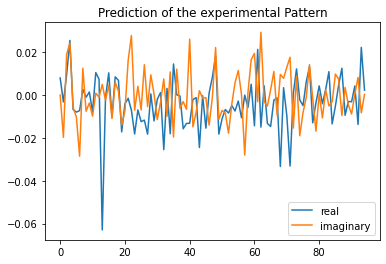

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=570.4089999198914
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 7.96988513e-03+0.j          3.11381300e-03-0.01936917j
  3.11381300e-03+0.01936917j  9.01248981e-03+0.02637332j
 -3.92569986e-03+0.00082084j -2.67966487e-03-0.01135018j
  9.01248981e-03

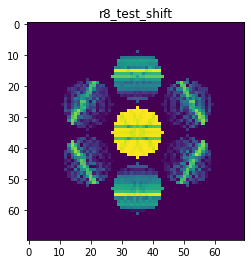

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9776385981917811
>>>replaced the 8. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 750ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 691ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


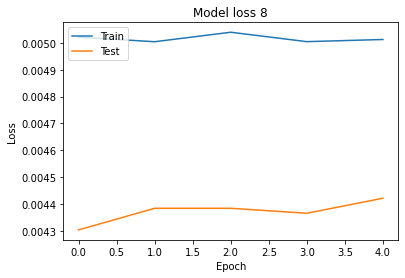

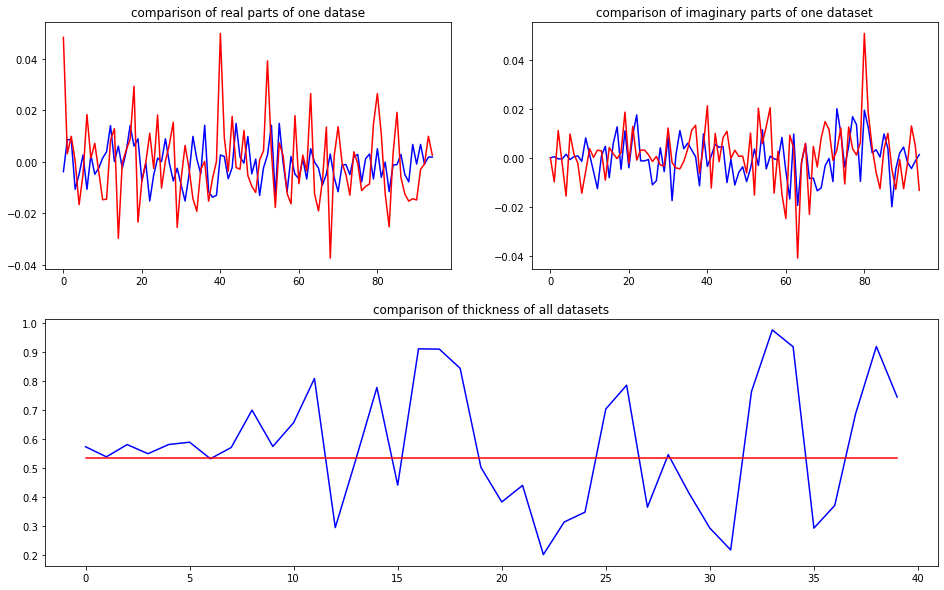

predicted thickness: 0.5345356


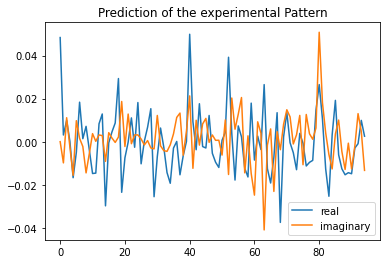

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=534.5355868339539
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.04847501+0.j          0.00648947-0.01048429j  0.00648947+0.01048429j
  0.00928096-0.00197385j -0.00478645-0.00057321j -0.00174749+0.00599948j
  0.00928096+0.00197385j -0.00174749-0.00

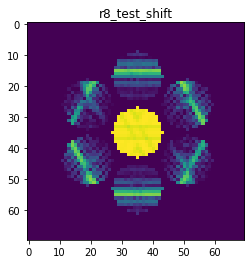

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9939951386312658
>>>replaced the 9. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 750ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000


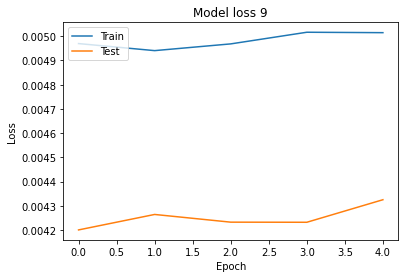

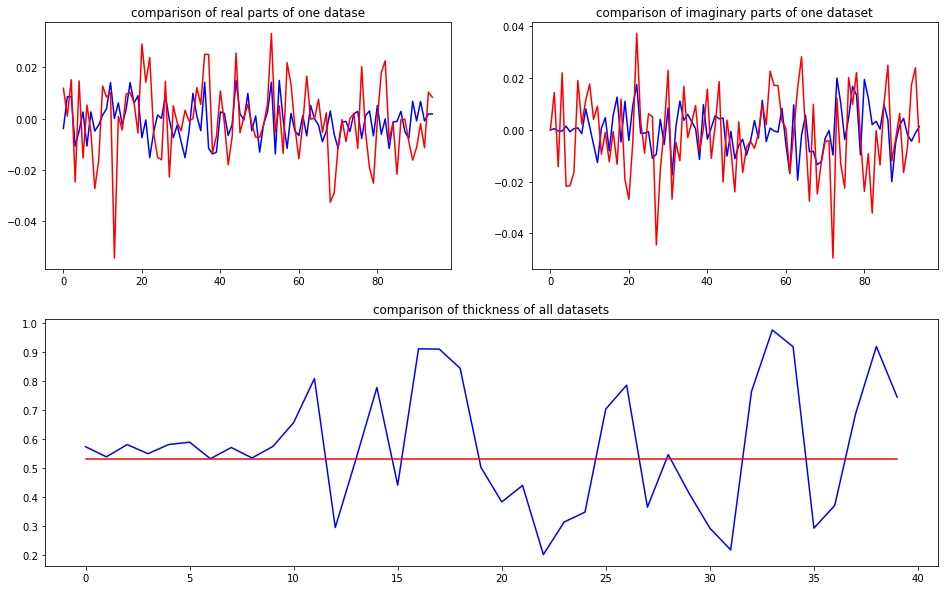

predicted thickness: 0.5315231


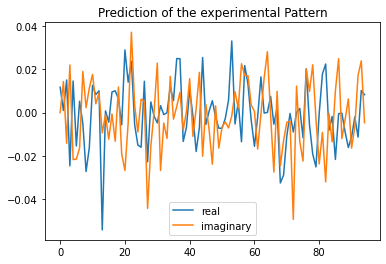

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=531.5231084823608
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01178536+0.j          0.00807265+0.01432069j  0.00807265-0.01432069j
 -0.00966975+0.0192684j  -0.0062596 -0.01205837j -0.01022572-0.02031966j
 -0.00966975-0.0192684j  -0.01022572+0.02

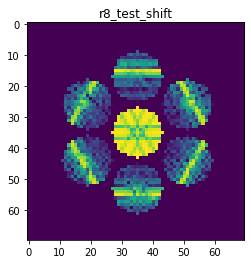

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9770959340731242
>>>replaced the 10. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 761ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 733ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 717ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000


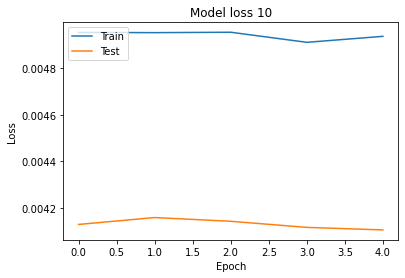

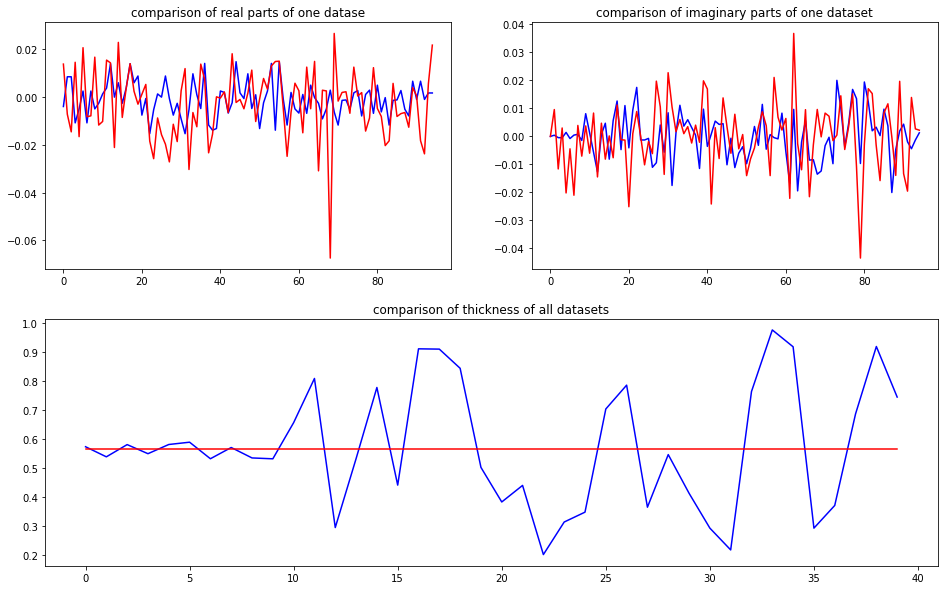

predicted thickness: 0.5636612


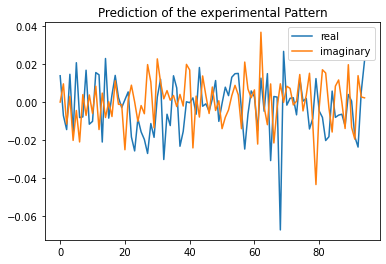

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.6612176895142
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01386866+0.00000000e+00j -0.0108185 +1.06059359e-02j
 -0.0108185 -1.06059359e-02j  0.00323658+1.20106585e-02j
  0.00013711-6.57381956e-03j  0.00647251-4.17495333e-03j
  0.00323658-1.2

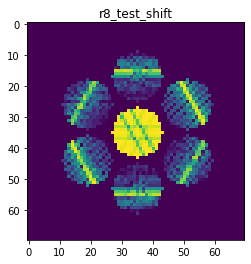

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9814587928130746
>>>replaced the 11. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 743ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


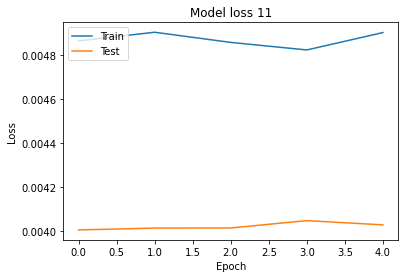

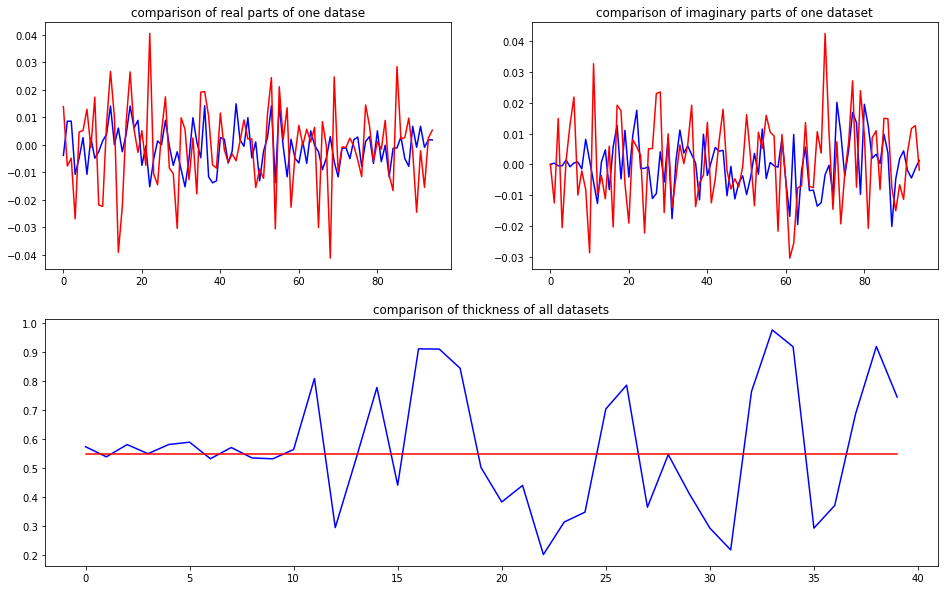

predicted thickness: 0.54973865


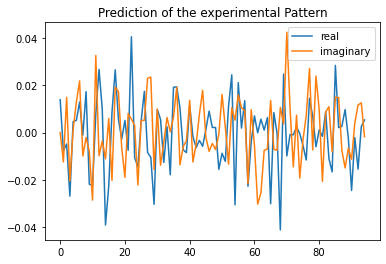

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.7386455535889
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01385543+0.j         -0.00630217-0.01365123j -0.00630217+0.01365123j
 -0.00700063-0.02111438j  0.01092362+0.00163389j  0.00205296+0.01135814j
 -0.00700063+0.02111438j  0.00205296-0.01

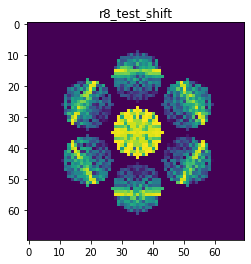

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9467266969640377
>>>replaced the 12. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


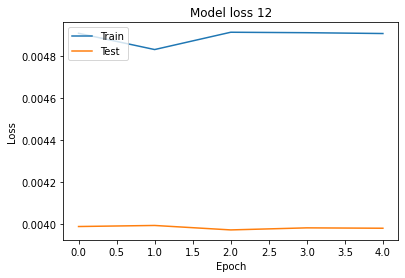

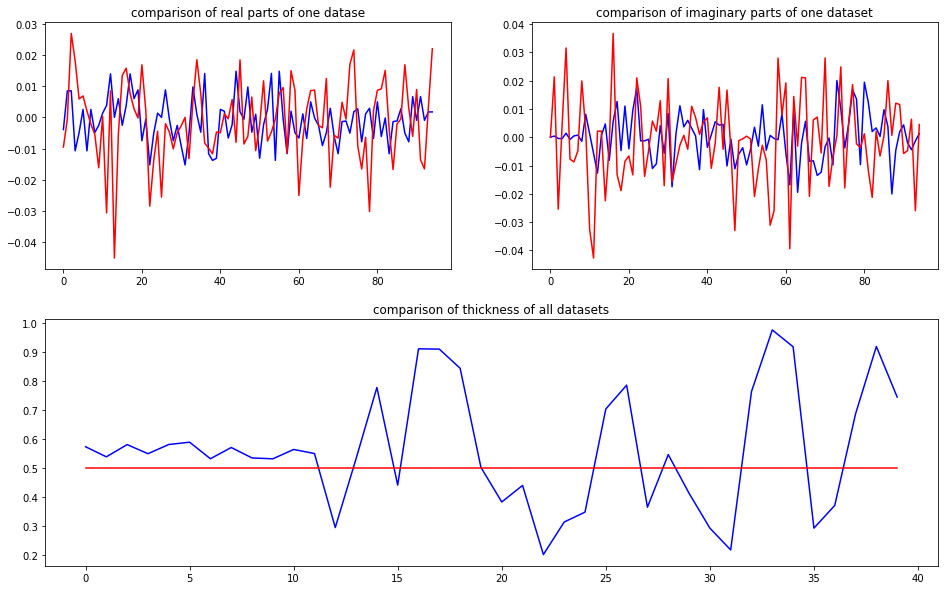

predicted thickness: 0.49830064


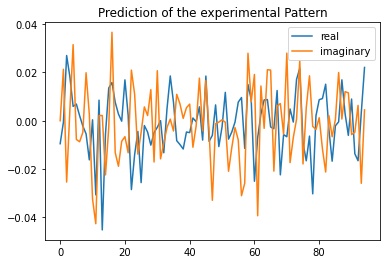

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=498.3006417751312
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00950836+0.00000000e+00j  0.01326698+2.33403072e-02j
  0.01326698-2.33403072e-02j  0.01017238+6.61967043e-03j
  0.00030528+5.84680680e-03j  0.00236988-1.45216146e-03j
  0.01017238-6.6

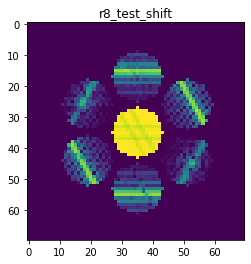

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9927534662870673
>>>replaced the 13. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 756ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 695ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000


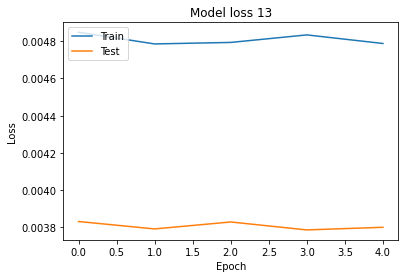

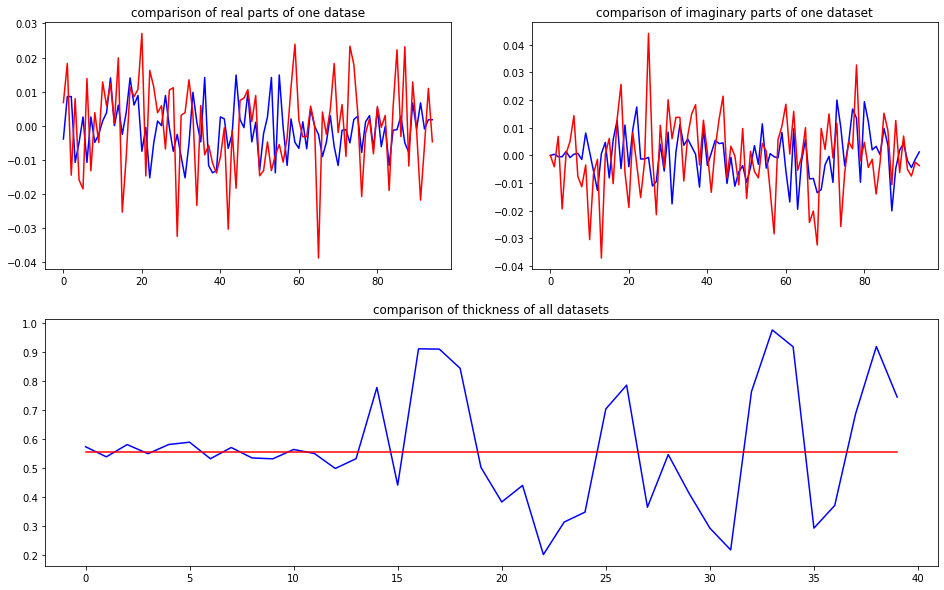

predicted thickness: 0.5535042


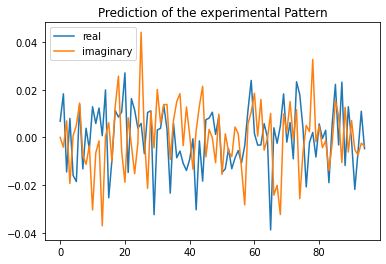

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=553.504228591919
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00680029+0.j          0.00190524-0.00550772j  0.00190524+0.00550772j
  0.01091073-0.01684545j -0.00604341+0.0059971j  -0.01586809+0.00630089j
  0.01091073+0.01684545j -0.01586809-0.006

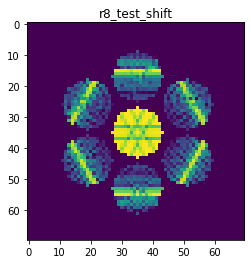

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9757104040089957
>>>replaced the 14. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 818ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 726ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 726ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000


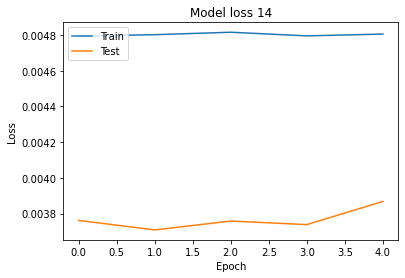

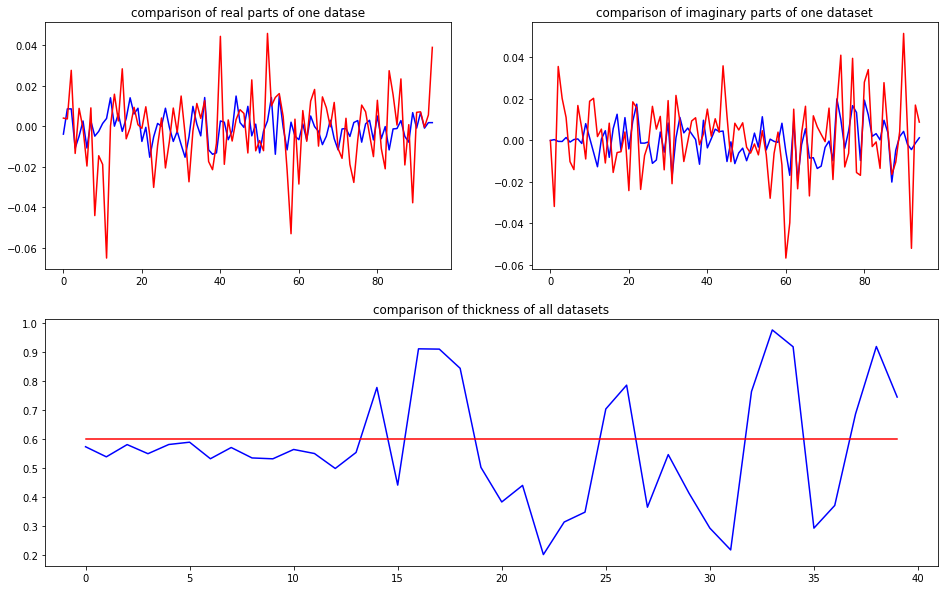

predicted thickness: 0.5998097


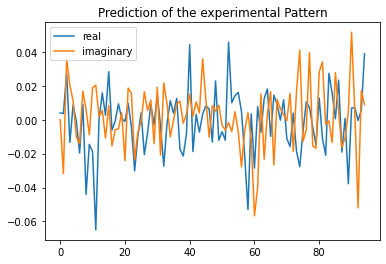

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=599.8097062110901
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00401227+0.00000000e+00j  0.01555771-3.37199327e-02j
  0.01555771+3.37199327e-02j -0.01651891+1.71534726e-02j
 -0.01763812+2.66540656e-03j  0.00404115-1.35220569e-02j
 -0.01651891-1.7

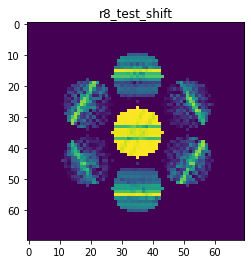

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9908753192684555
>>>replaced the 15. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 757ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000


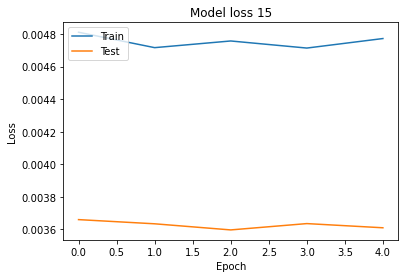

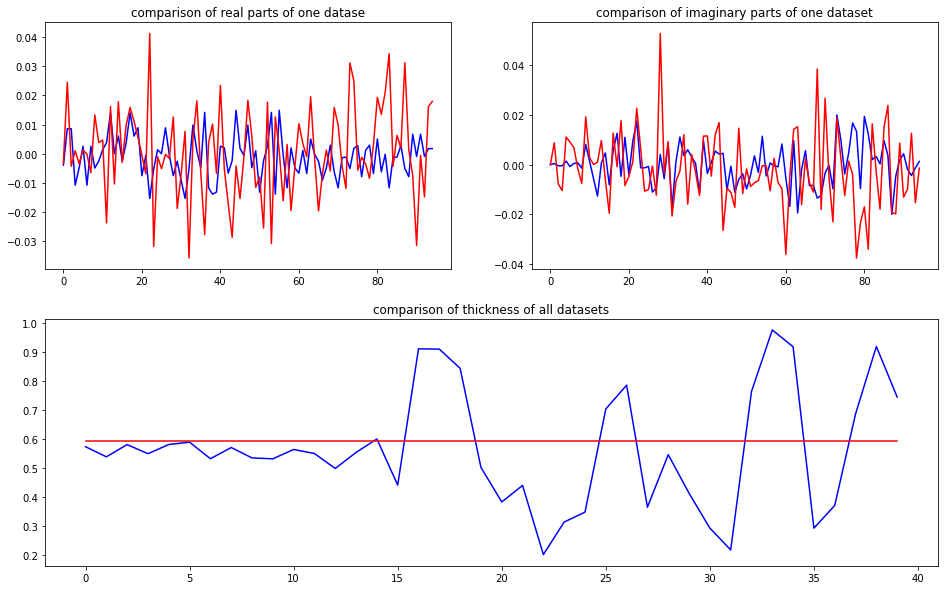

predicted thickness: 0.59150165


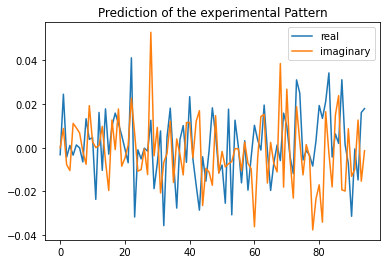

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=591.5016531944275
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-3.21569387e-03+0.j          1.00899986e-02+0.00827101j
  1.00899986e-02-0.00827101j  4.80203526e-04-0.00861881j
  4.93864564e-03+0.00937004j -2.61590752e-03+0.00537624j
  4.80203526e-04

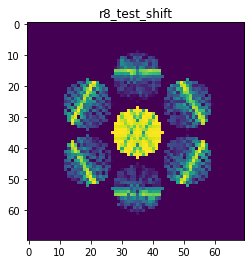

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9841336504042524
>>>replaced the 16. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 750ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000


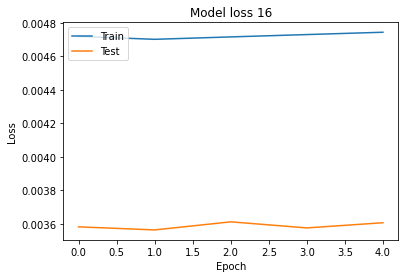

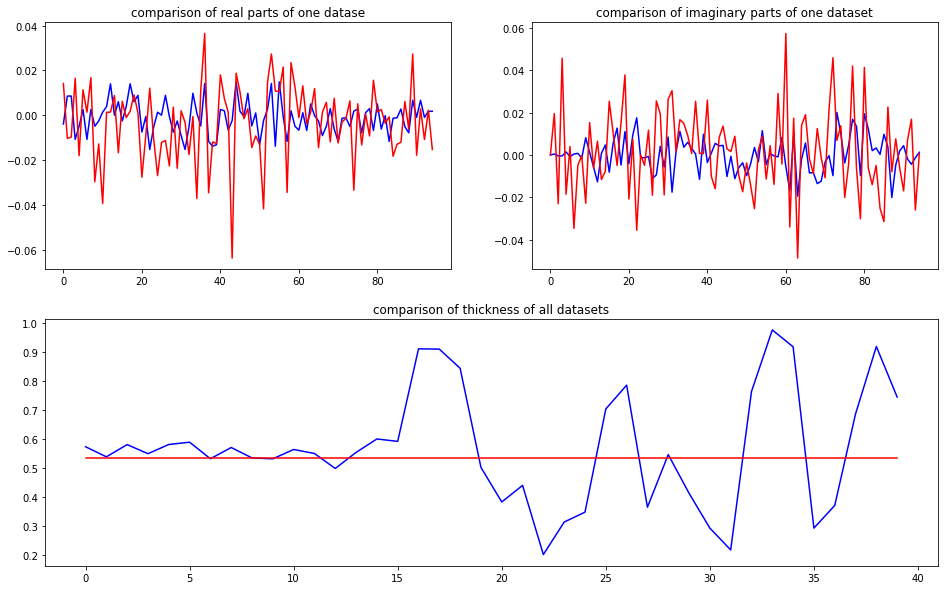

predicted thickness: 0.53529793


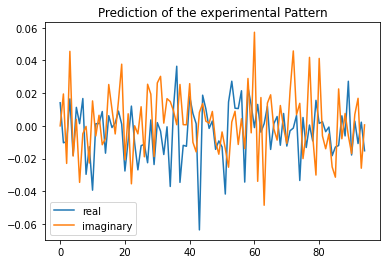

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=535.2979302406311
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.41434614e-02+0.j         -1.00426781e-02+0.02124925j
 -1.00426781e-02-0.02124925j  8.84458417e-03+0.0400579j
 -2.38700686e-02-0.00906997j  1.40251564e-02+0.0043866j
  8.84458417e-03-0

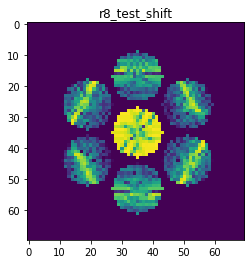

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9660616075526239
>>>replaced the 17. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 758ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


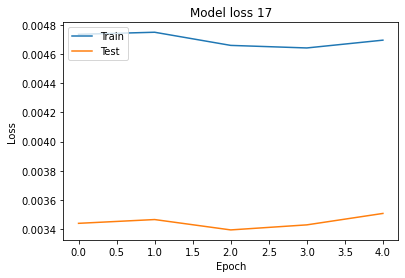

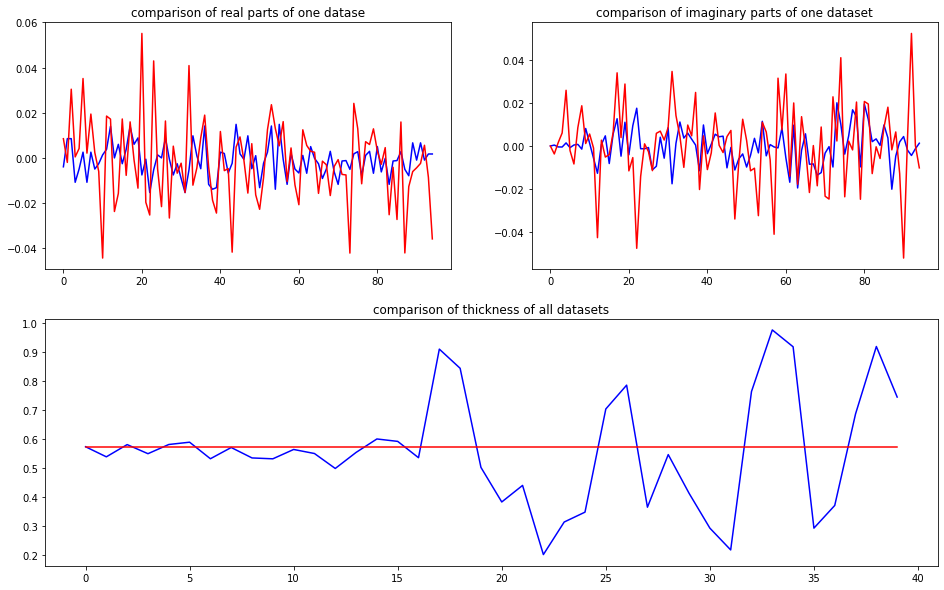

predicted thickness: 0.5728323


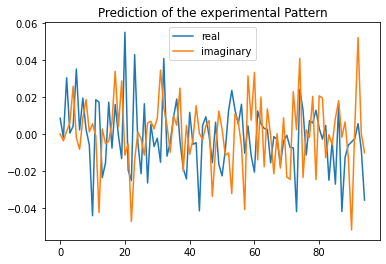

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=572.8322863578796
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00853205+0.j          0.01421914-0.00261859j  0.01421914+0.00261859j
  0.00131497+0.00718958j  0.0032922 +0.00358307j  0.02725205-0.00533202j
  0.00131497-0.00718958j  0.02725205+0.00

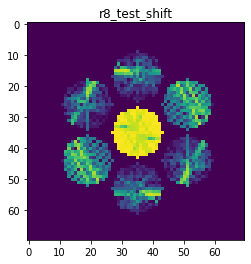

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9860406820773869
>>>replaced the 18. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 757ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 712ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 703ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000


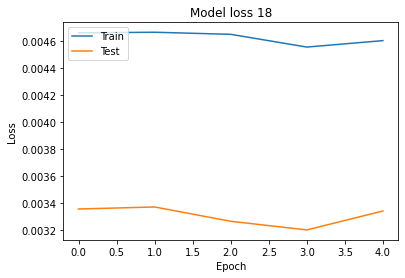

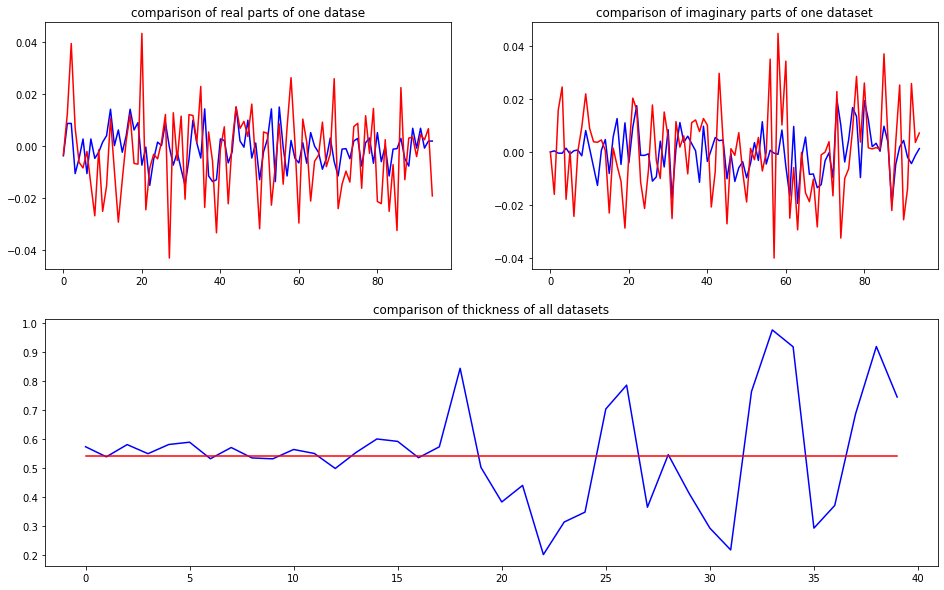

predicted thickness: 0.5399129


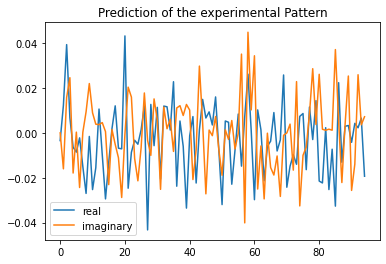

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=539.9128794670105
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00343761+0.00000000e+00j  0.02577479-1.58895273e-02j
  0.02577479+1.58895273e-02j  0.00223202+2.44772863e-02j
 -0.01671988-1.36355907e-02j -0.01178419+3.16159858e-05j
  0.00223202-2.4

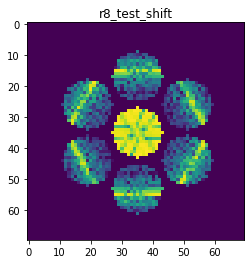

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9663758750730195
>>>replaced the 19. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000


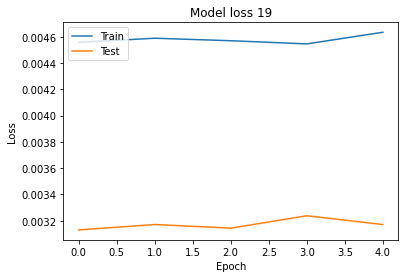

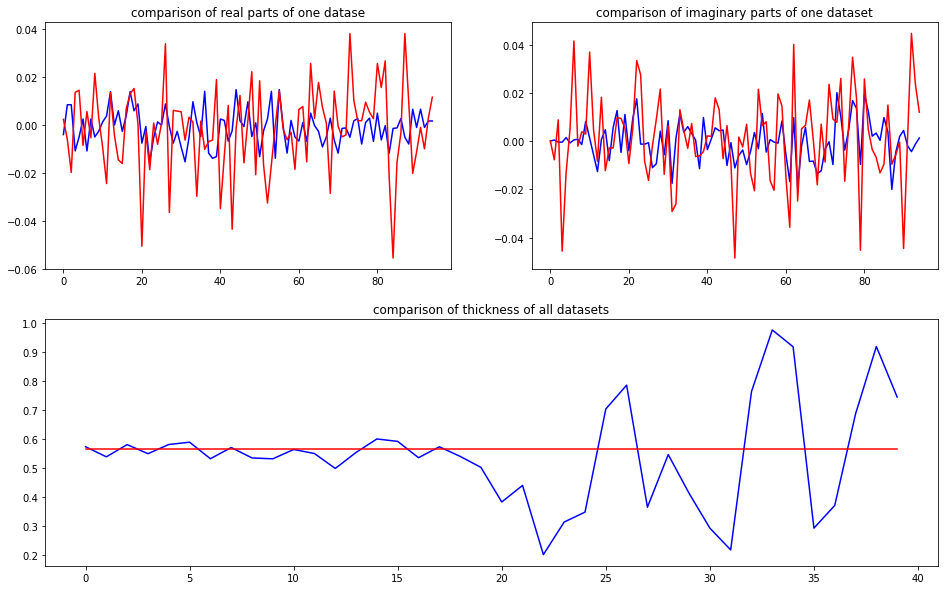

predicted thickness: 0.56573313


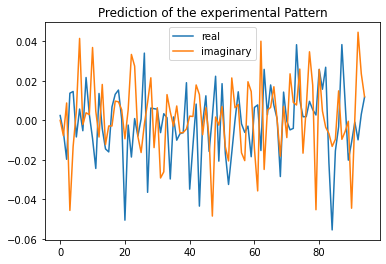

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.7331347465515
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00244147+0.j         -0.01282695-0.00826561j -0.01282695+0.00826561j
  0.00958041-0.04356446j  0.01811382-0.00856767j -0.0068435 +0.00347345j
  0.00958041+0.04356446j -0.0068435 -0.00

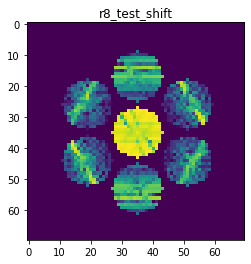

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.958831415900795
>>>replaced the 20. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 764ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000


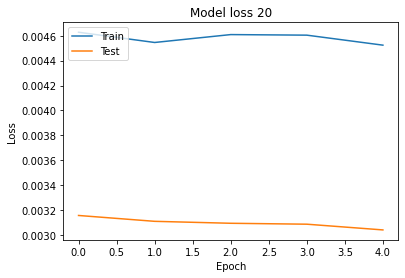

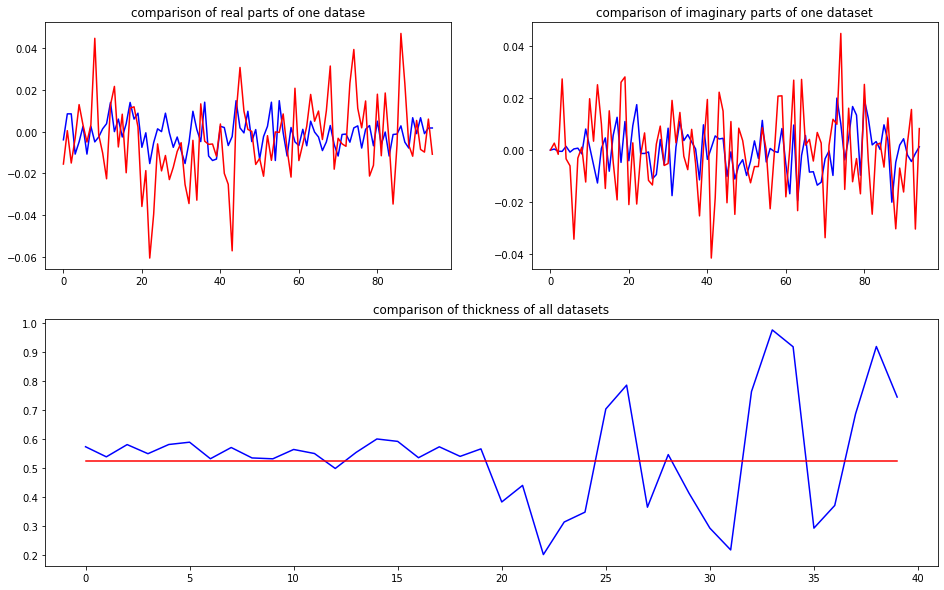

predicted thickness: 0.52460575


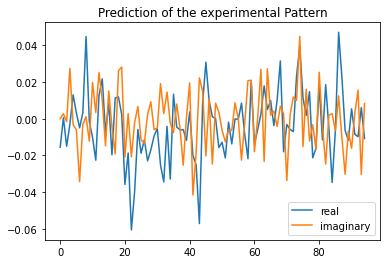

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=524.6057510375977
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01552534+0.j         -0.0072679 +0.00215345j -0.0072679 -0.00215345j
 -0.00404495+0.03084499j  0.02887977-0.00222458j  0.00321389-0.00147815j
 -0.00404495-0.03084499j  0.00321389+0.00

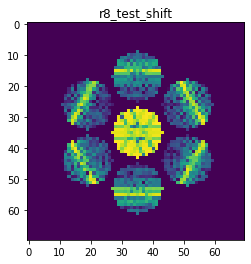

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9647995776730264
>>>replaced the 21. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 772ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 725ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000


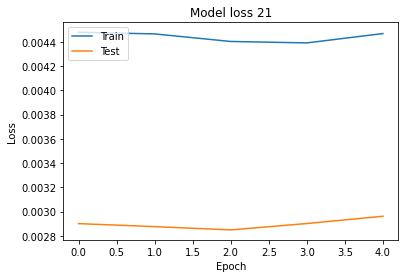

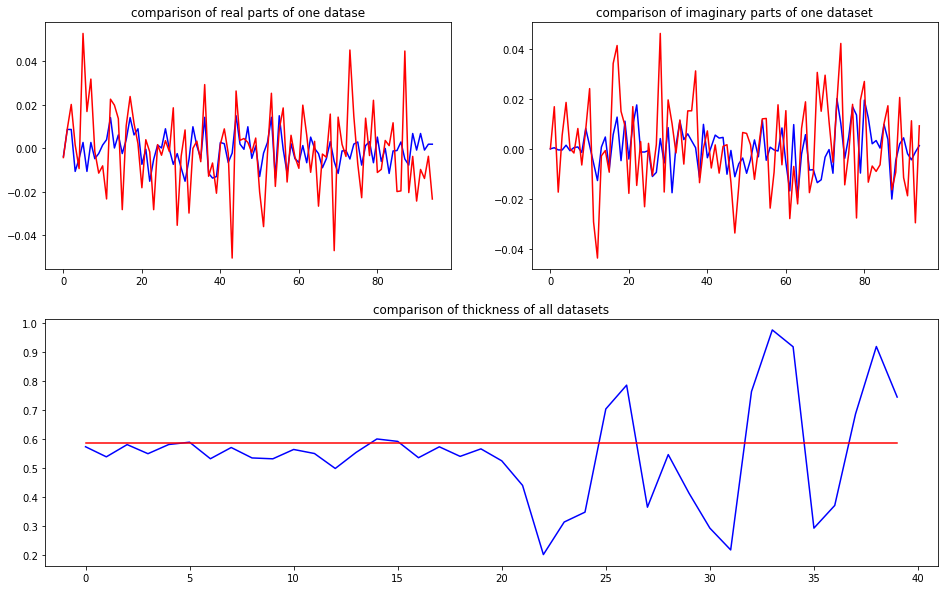

predicted thickness: 0.5863765


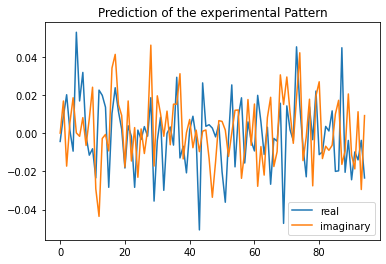

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=586.3764882087708
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0043556 +0.j          0.0145095 +0.01703088j  0.0145095 -0.01703088j
  0.00914792+0.00352118j -0.00546815+0.01248074j  0.04230677-0.00397667j
  0.00914792-0.00352118j  0.04230677+0.00

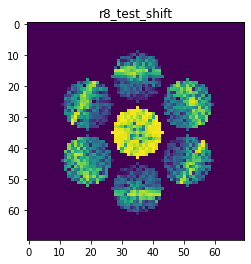

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9575246823298869
>>>replaced the 22. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 762ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000


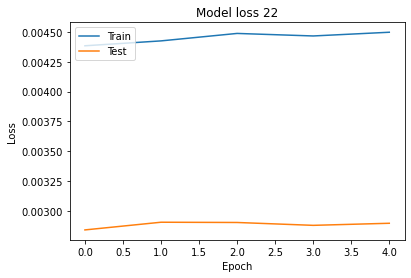

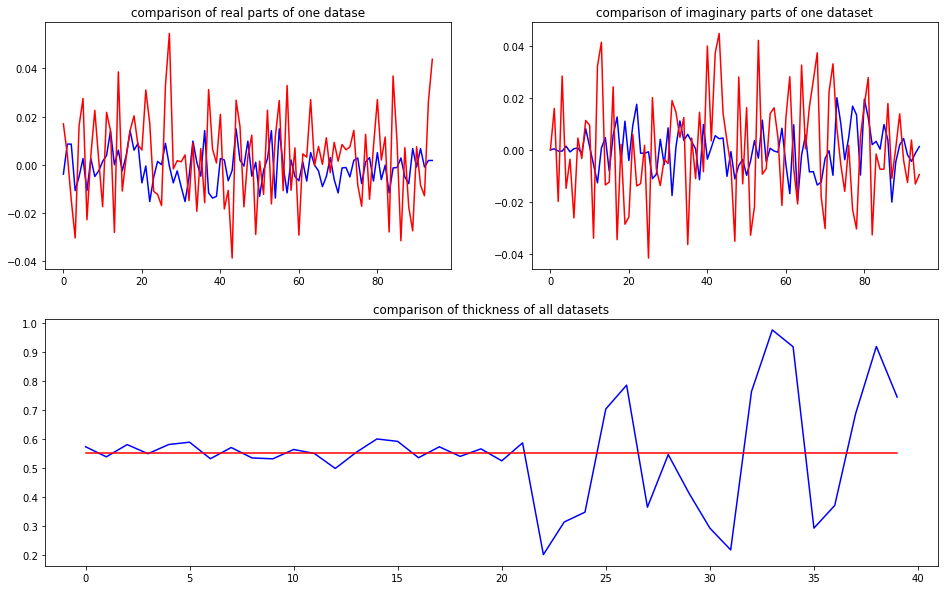

predicted thickness: 0.55249864


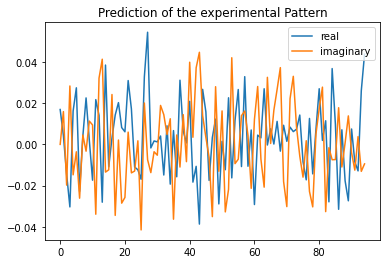

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=552.4986386299133
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01691646+0.j         -0.00517278+0.01785544j -0.00517278-0.01785544j
 -0.0266754 +0.02721495j  0.01934502-0.00573687j  0.0156548 -0.00409976j
 -0.0266754 -0.02721495j  0.0156548 +0.00

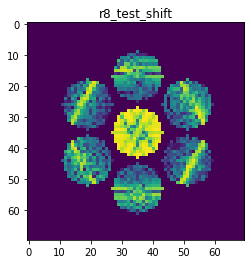

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9365584367303353
>>>replaced the 23. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


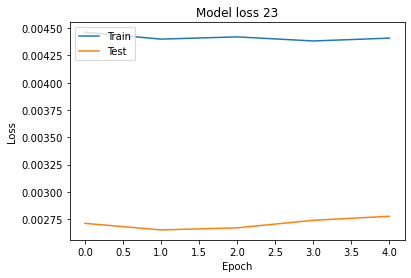

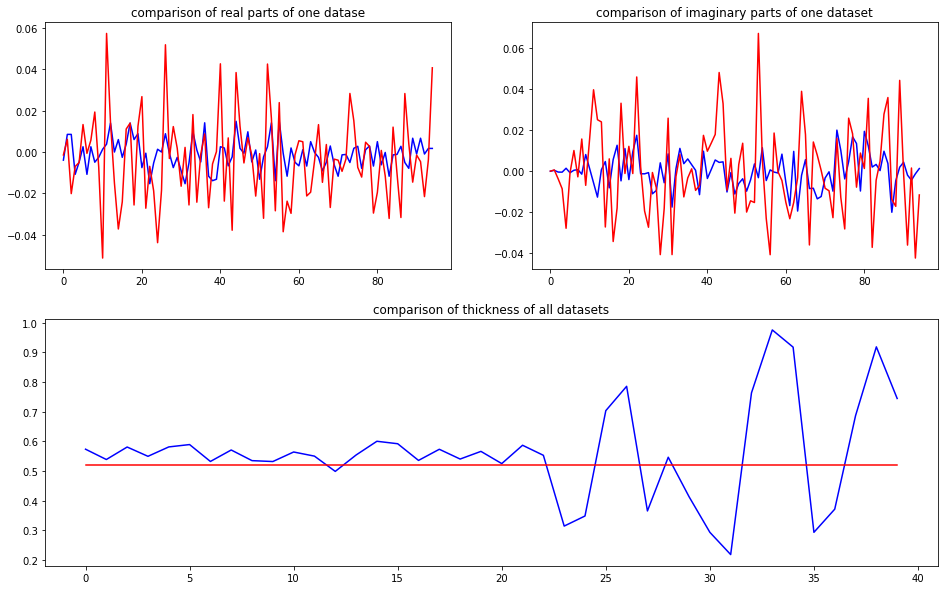

predicted thickness: 0.5210394


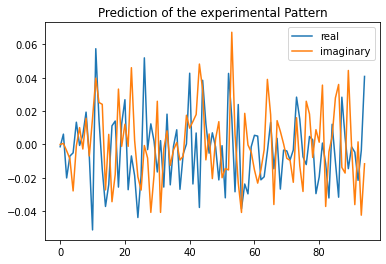

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=521.0394263267517
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00138194+0.j         -0.00694471+0.00220804j -0.00694471-0.00220804j
 -0.00378555-0.00932925j  0.00717166-0.02176766j  0.00951974+0.00095327j
 -0.00378555+0.00932925j  0.00951974-0.00

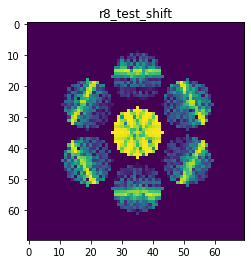

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9871290288178283
>>>replaced the 24. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 752ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000


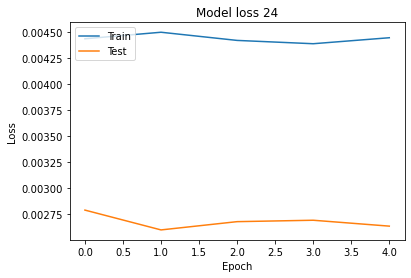

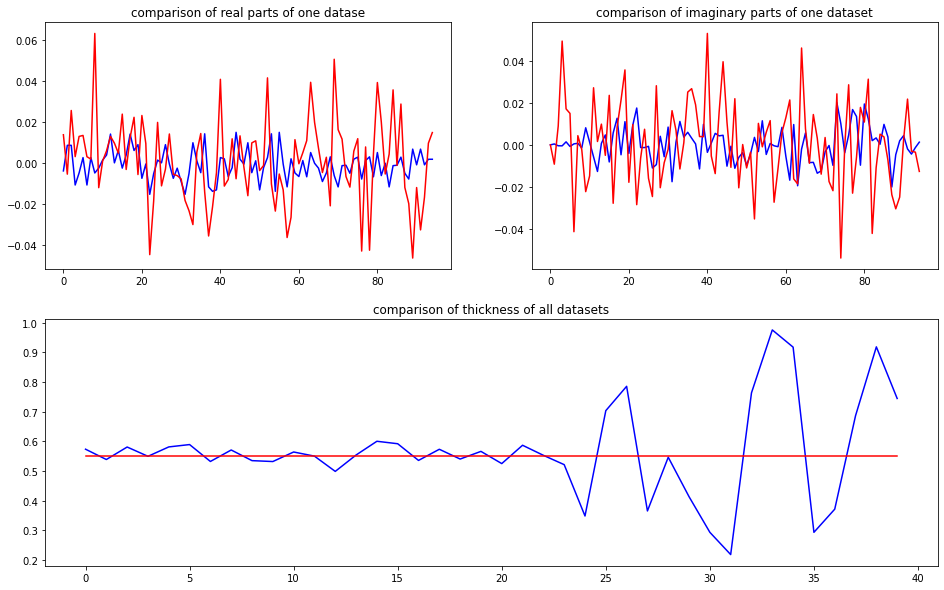

predicted thickness: 0.5498067


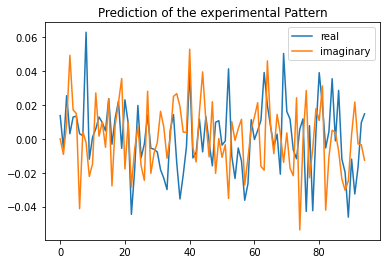

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.8067140579224
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01370293+0.j          0.01000748-0.00906595j  0.01000748+0.00906595j
  0.00296565+0.04530919j  0.03786195+0.00976996j  0.0076038 +0.00528234j
  0.00296565-0.04530919j  0.0076038 -0.00

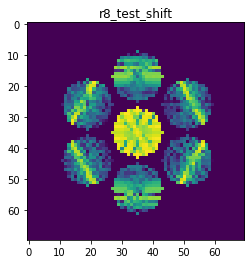

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.956473554988548
>>>replaced the 25. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 767ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 723ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 721ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 716ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 715ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000


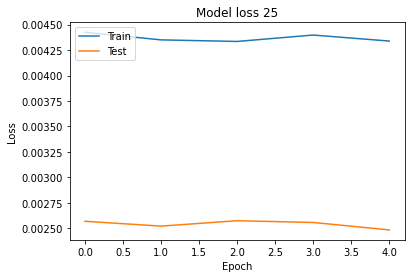

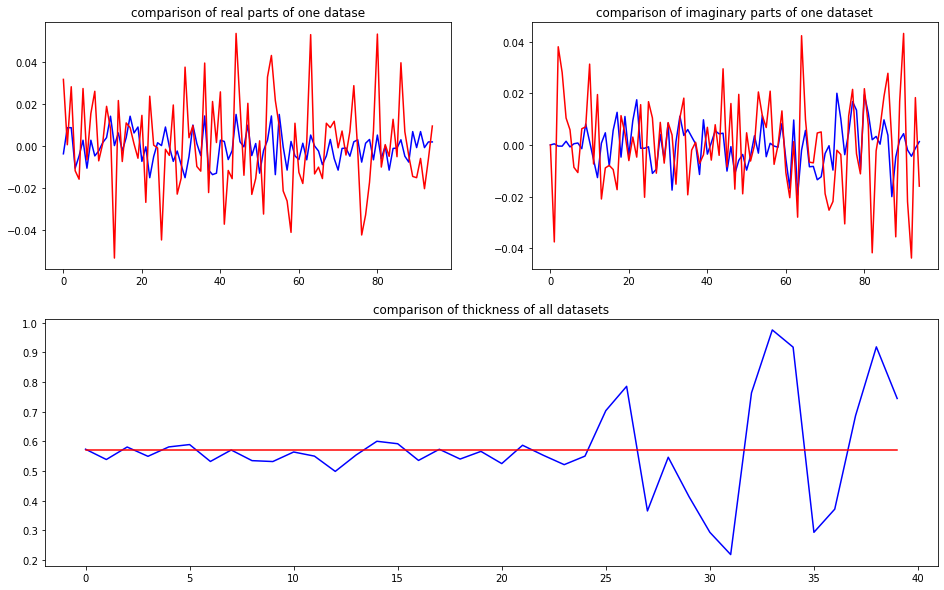

predicted thickness: 0.56872684


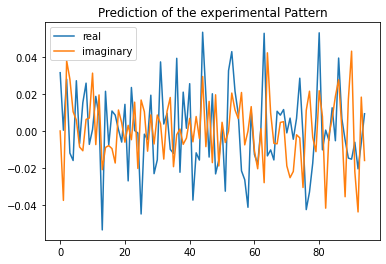

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=568.7268376350403
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03158876+0.j          0.01427062-0.0378276j   0.01427062+0.0378276j
 -0.00936553+0.01837775j  0.00496818+0.00207829j  0.02129149+0.00828898j
 -0.00936553-0.01837775j  0.02129149-0.008

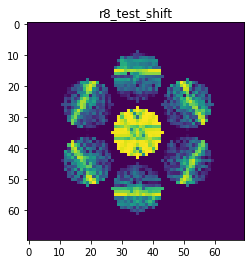

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9804350401396377
>>>replaced the 26. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000


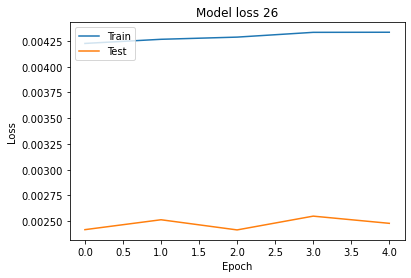

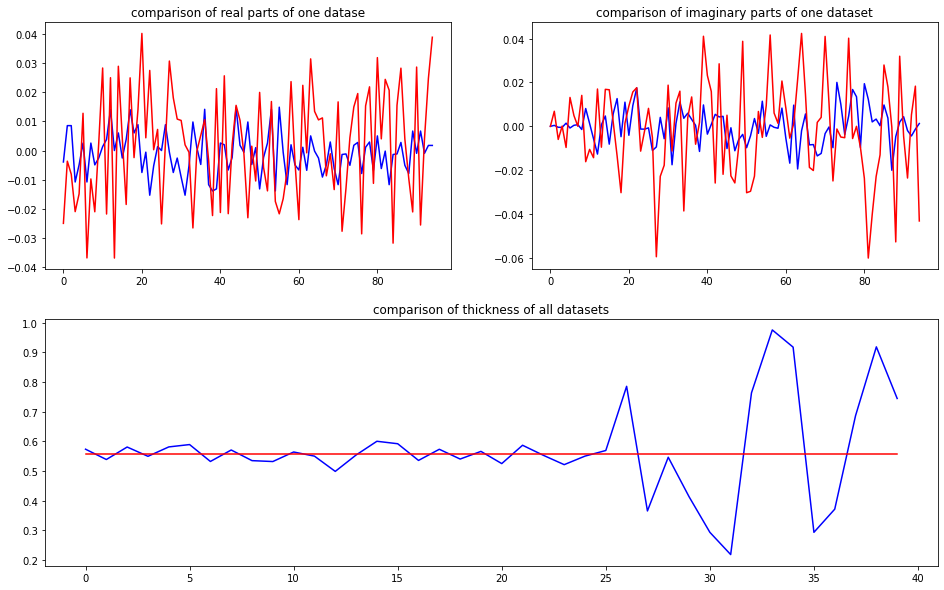

predicted thickness: 0.55769145


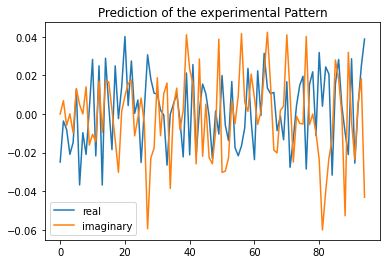

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=557.6914548873901
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02487923+0.j         -0.00583977+0.0064197j  -0.00583977-0.0064197j
 -0.02876598-0.00244593j -0.01785231-0.01188652j  0.00156127+0.00658432j
 -0.02876598+0.00244593j  0.00156127-0.006

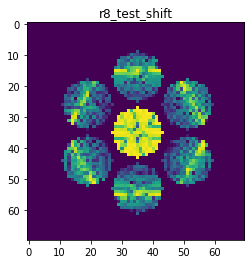

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9592795957520455
>>>replaced the 27. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 755ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000


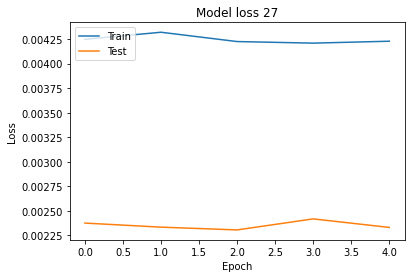

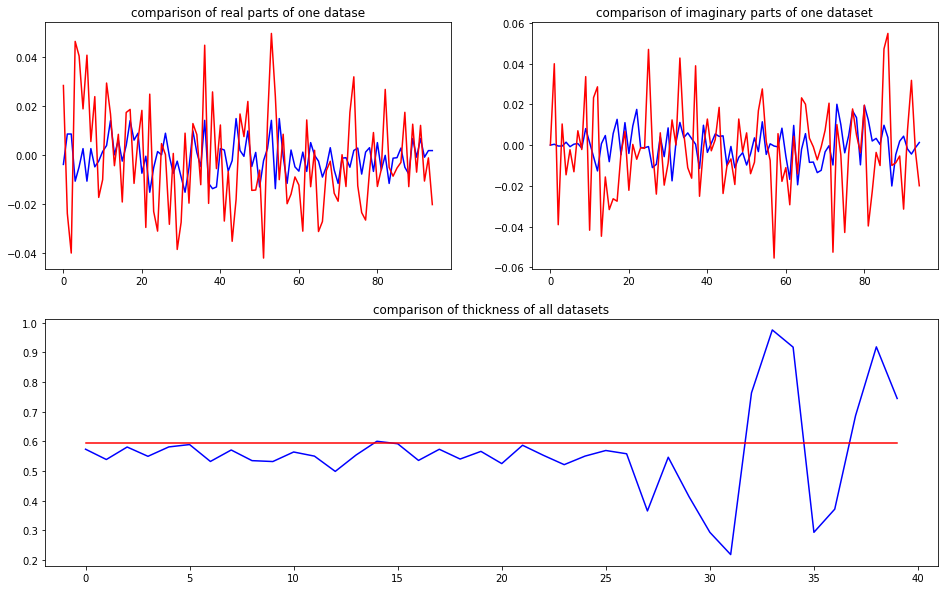

predicted thickness: 0.5954024


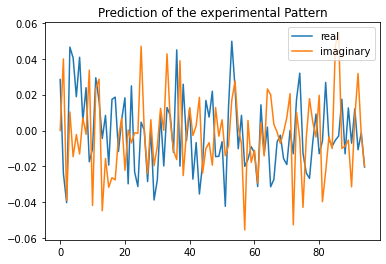

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=595.4024195671082
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02846495+0.j         -0.03193013+0.03944174j -0.03193013-0.03944174j
  0.04377071+0.01172659j  0.03225653-0.00616488j  0.01217904-0.00464148j
  0.04377071-0.01172659j  0.01217904+0.00

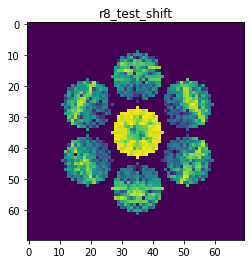

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9443154260760387
>>>replaced the 28. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 755ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


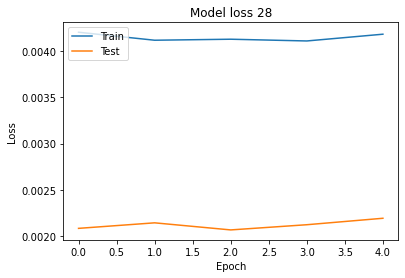

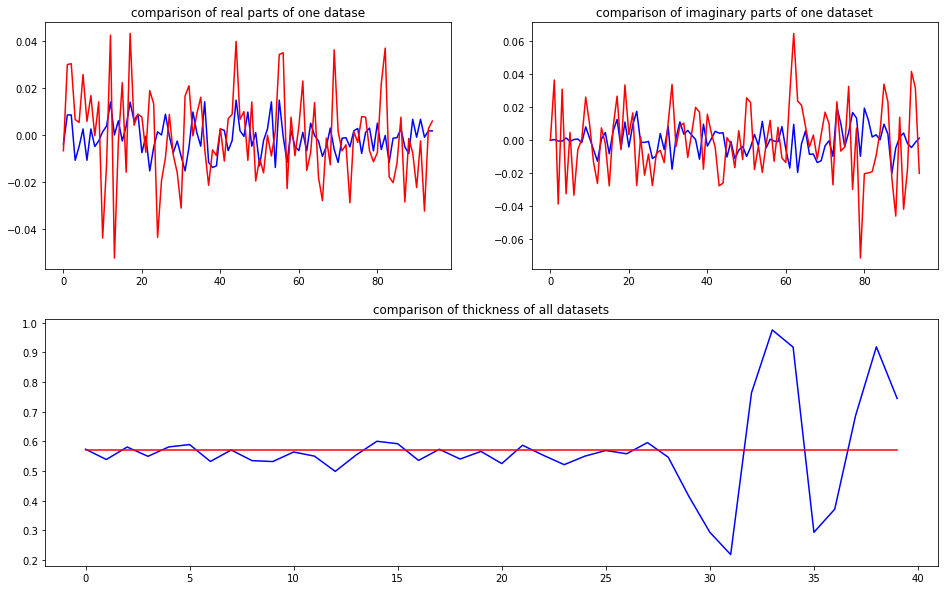

predicted thickness: 0.57169557


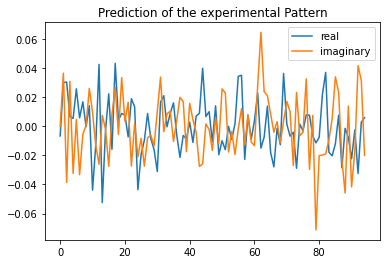

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.6955661773682
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00667391+0.j          0.03036811+0.03752122j  0.03036811-0.03752122j
  0.00628771+0.03206575j  0.00255832-0.01649588j  0.02133401+0.00516072j
  0.00628771-0.03206575j  0.02133401-0.00

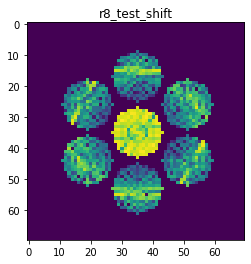

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9937557874951576
>>>replaced the 29. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 749ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


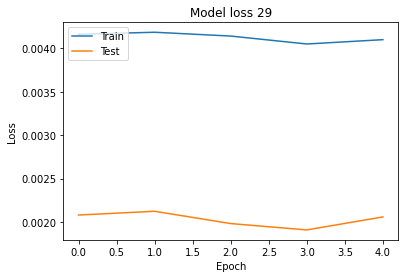

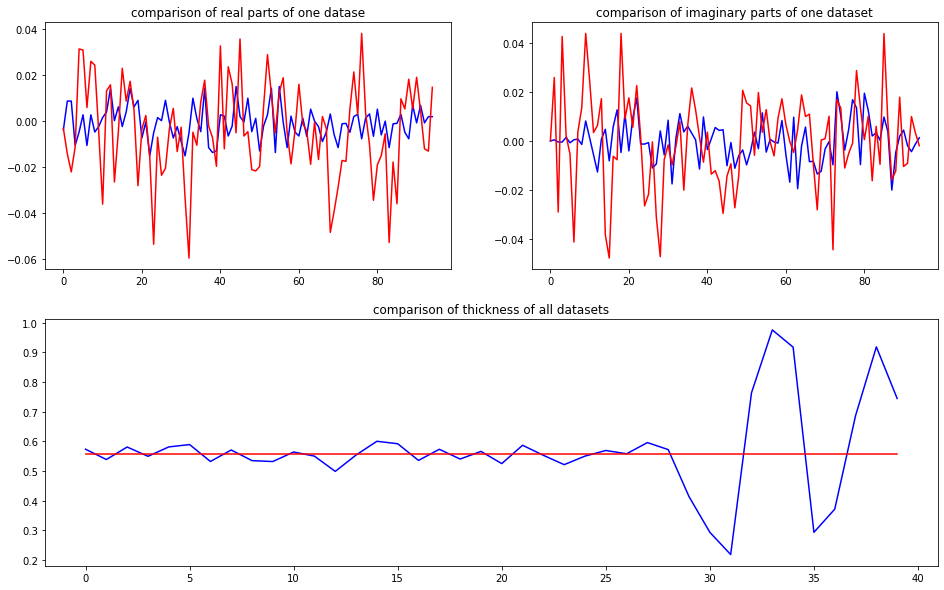

predicted thickness: 0.557117


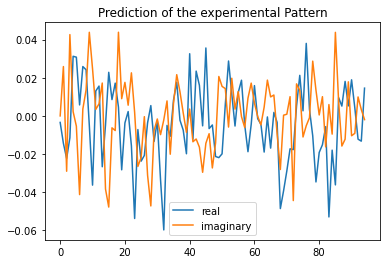

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=557.1169853210449
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00341704+0.j         -0.01839831+0.02742649j -0.01839831-0.02742649j
 -0.00298773+0.04188844j  0.02764541-0.00567908j  0.02824022-0.00448676j
 -0.00298773-0.04188844j  0.02824022+0.00

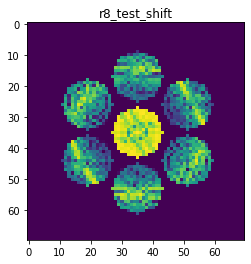

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8885906104838617
>>>replaced the 30. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 750ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 707ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000


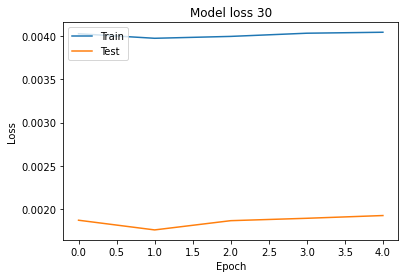

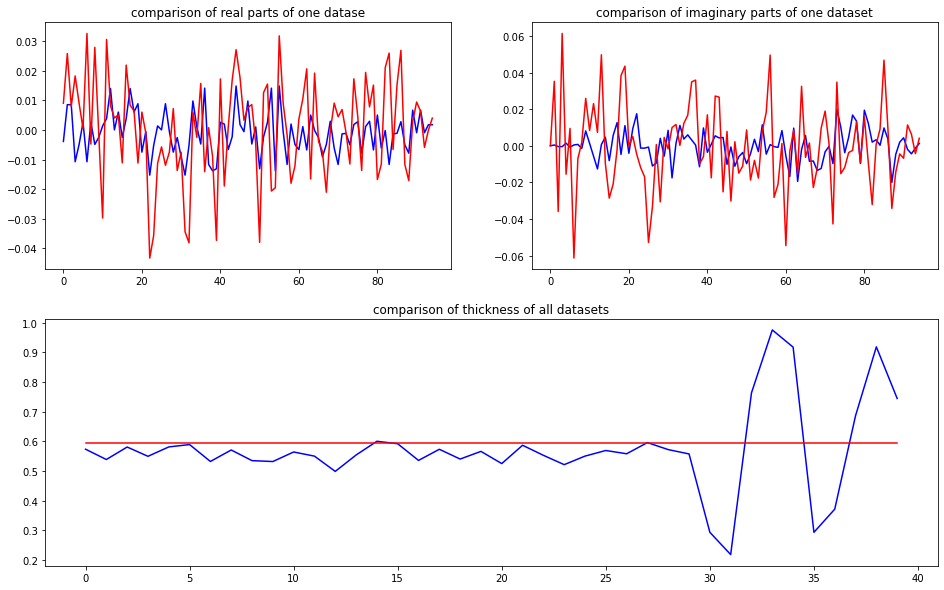

predicted thickness: 0.59387535


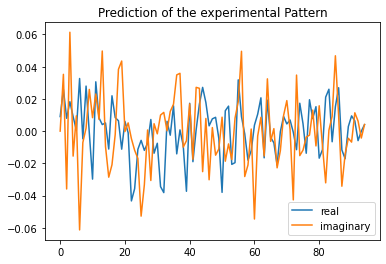

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=593.8753485679626
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.0090437 +0.j          0.01701439+0.03559508j  0.01701439-0.03559508j
  0.02573425+0.06132492j  0.01854257-0.00869976j -0.00214333+0.00829549j
  0.02573425-0.06132492j -0.00214333-0.00

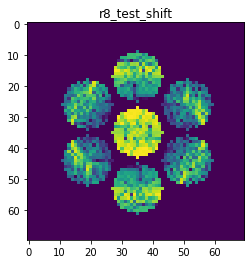

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8937872294071625
>>>replaced the 31. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000


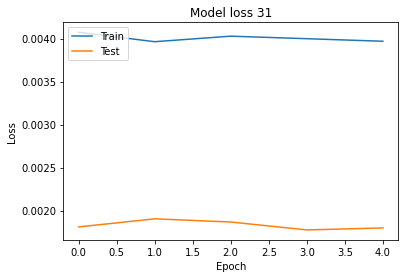

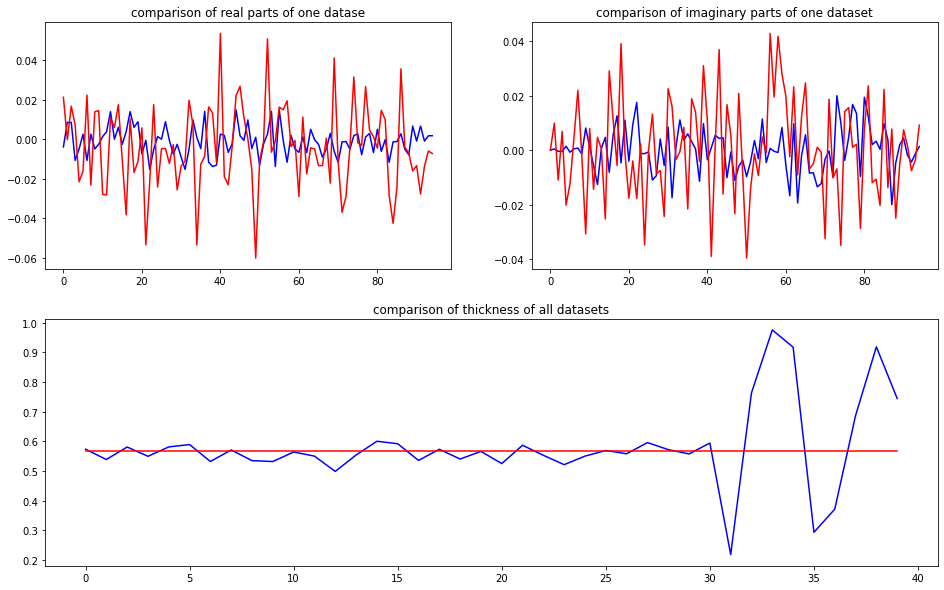

predicted thickness: 0.565347


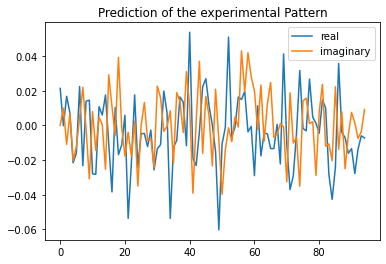

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.3470158576965
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.13313922e-02+0.j          8.28946103e-03+0.0104368j
  8.28946103e-03-0.0104368j   1.48352350e-02+0.00130773j
 -3.79698584e-03-0.00920747j -1.96414199e-02-0.01716609j
  1.48352350e-02-

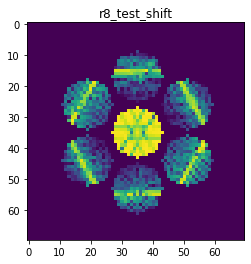

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9691938674780031
>>>replaced the 32. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 764ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 721ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000


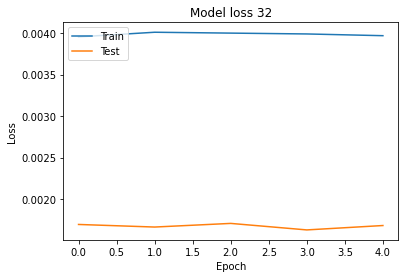

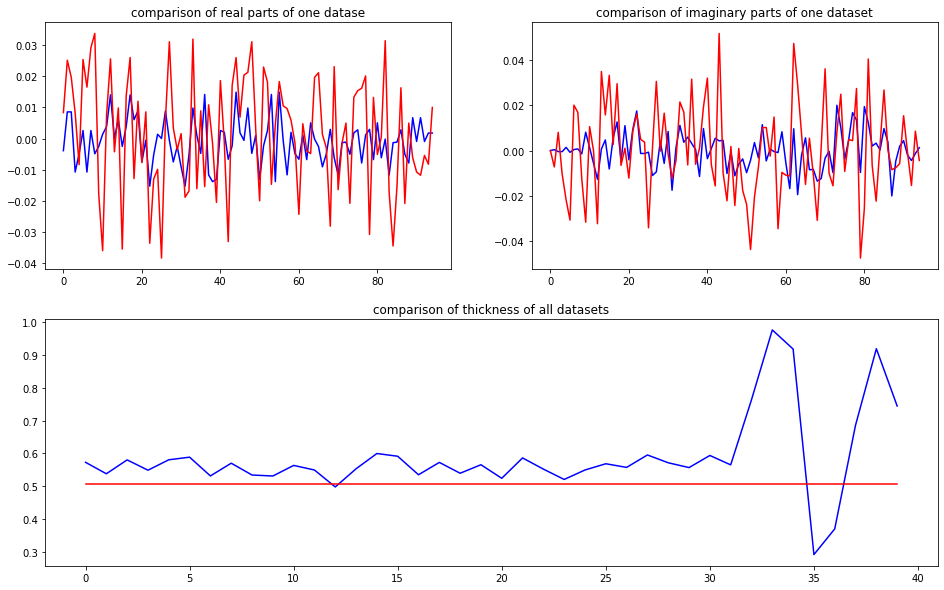

predicted thickness: 0.5070903


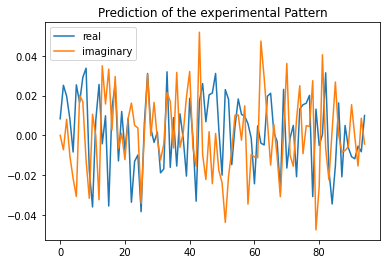

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=507.0902705192566
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00834211+0.j          0.02240321-0.00764474j  0.02240321+0.00764474j
  0.01234268-0.01523892j  0.01268467-0.00457801j  0.02722705-0.02378621j
  0.01234268+0.01523892j  0.02722705+0.02

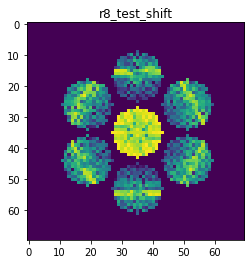

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9477493807471298
>>>replaced the 33. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 742ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


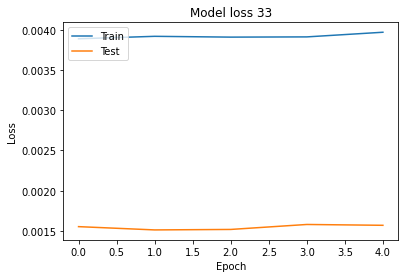

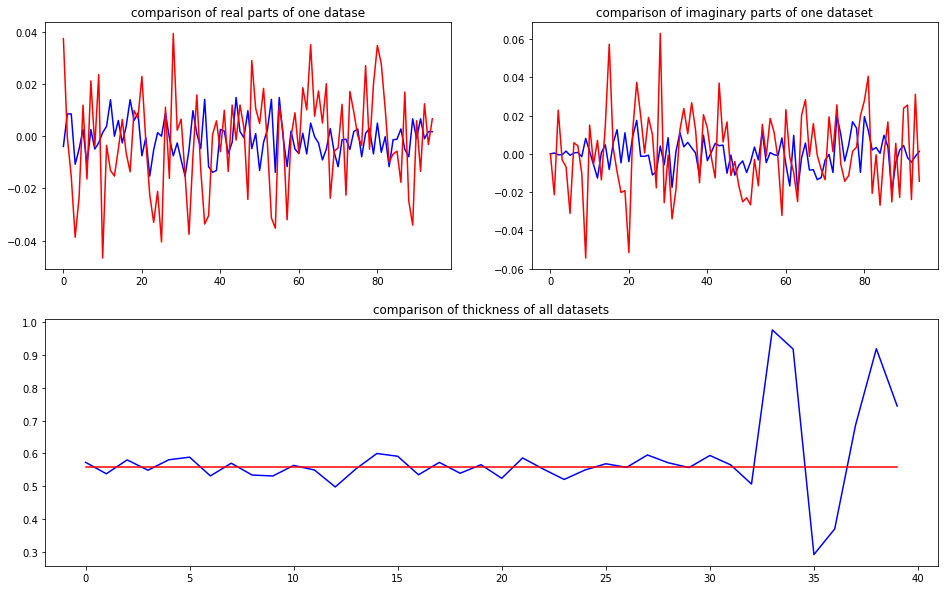

predicted thickness: 0.5586917


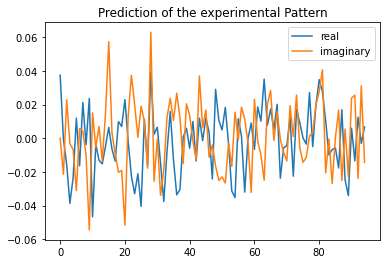

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=558.691680431366
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03750175+0.j         -0.00789054-0.02213844j -0.00789054+0.02213844j
 -0.02753982-0.00445458j -0.01364693+0.00174669j  0.01659805-0.01766984j
 -0.02753982+0.00445458j  0.01659805+0.017

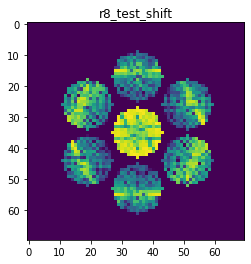

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9534715328160849
>>>replaced the 34. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 762ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 722ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


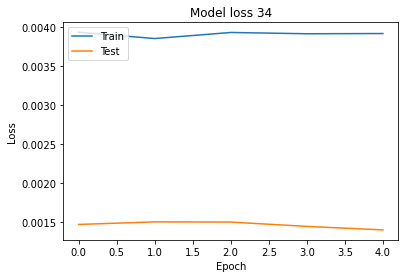

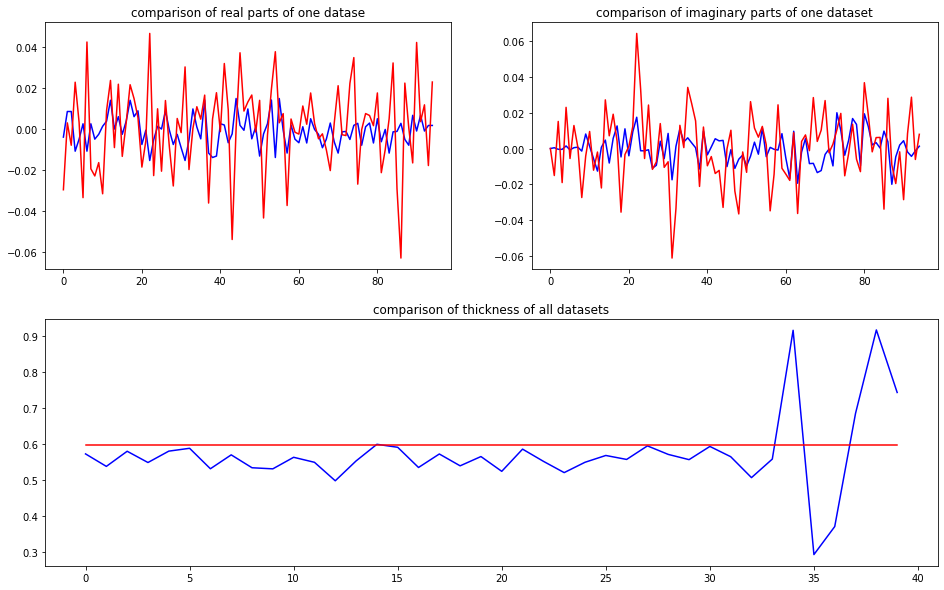

predicted thickness: 0.5984177


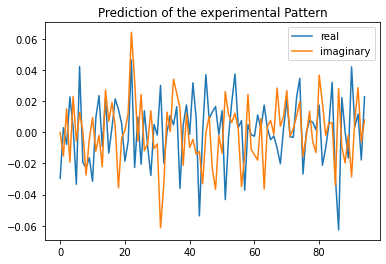

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=598.4176993370056
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02947336+0.j         -0.0023976 -0.01514091j -0.0023976 +0.01514091j
  0.03264816-0.01600029j -0.00970603+0.0252338j  -0.02629973-0.00315839j
  0.03264816+0.01600029j -0.02629973+0.00

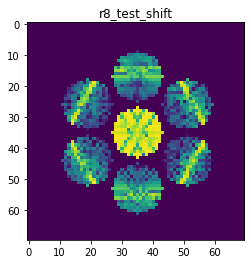

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9631175212039432
>>>replaced the 35. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 748ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


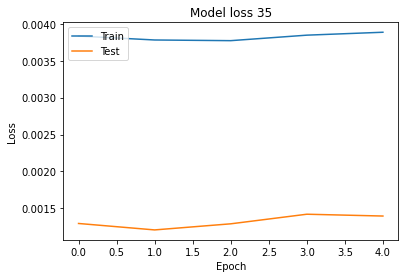

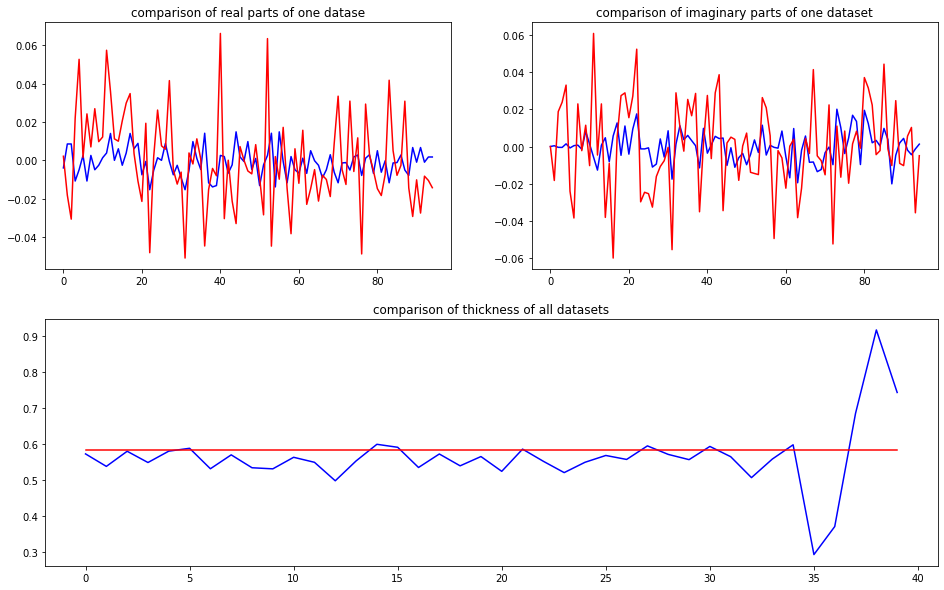

predicted thickness: 0.5849049


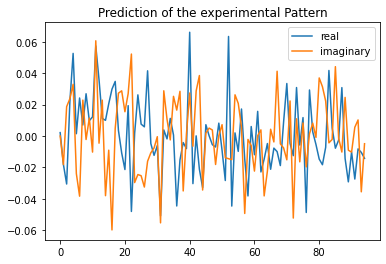

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=584.9049091339111
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00215955+0.j         -0.02437574-0.01846723j -0.02437574+0.01846723j
  0.02307739+0.03108744j  0.03976432+0.01757088j  0.00423769-0.02343887j
  0.02307739-0.03108744j  0.00423769+0.02

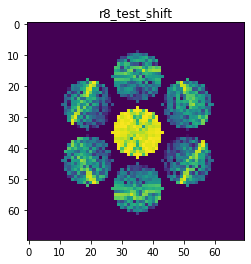

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9688986449346142
>>>replaced the 36. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 942ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 734ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


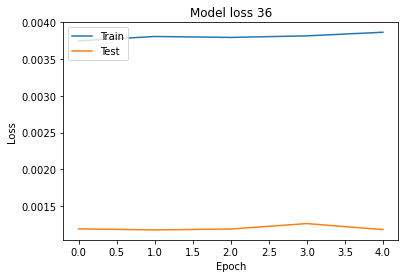

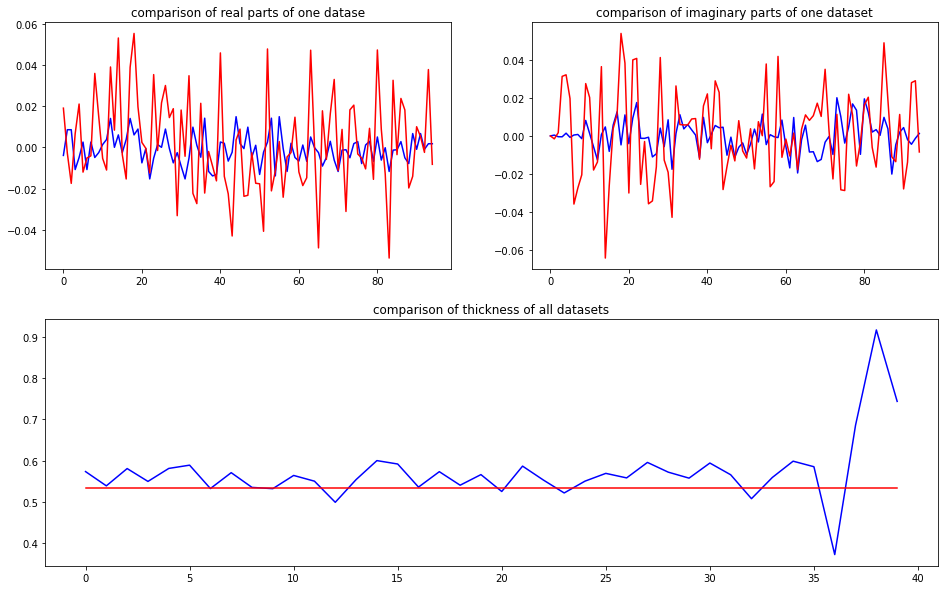

predicted thickness: 0.5340372


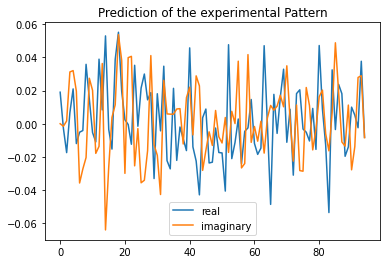

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=534.037172794342
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01900229+0.j         -0.0101295 -0.00160729j -0.0101295 +0.00160729j
  0.00071357+0.03352068j  0.02835804+0.02624742j -0.00807792+0.02349642j
  0.00071357-0.03352068j -0.00807792-0.023

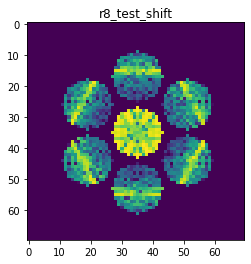

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9383091604997401
>>>replaced the 37. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 747ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 695ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.9661e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.5468e-04 - val_acc: 1.0000


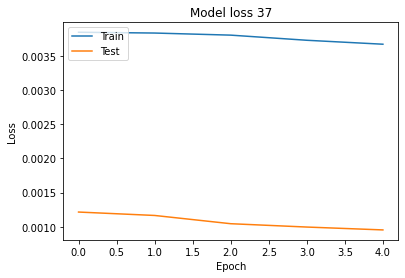

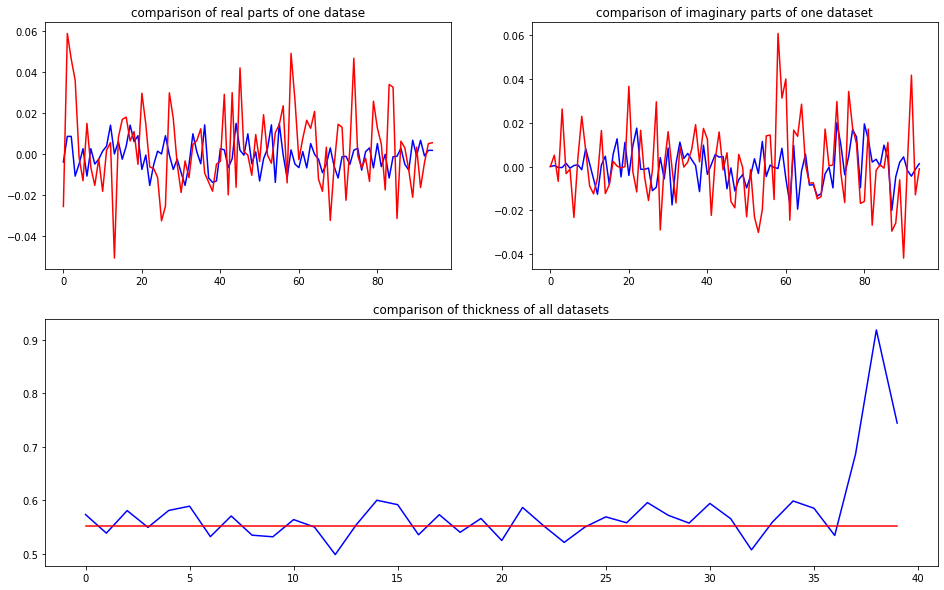

predicted thickness: 0.5518846


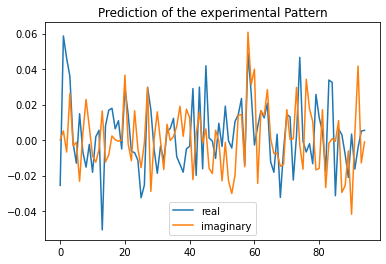

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=551.8845915794373
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02550315+0.j          0.05244611+0.00597126j  0.05244611-0.00597126j
  0.02540589+0.02474399j -0.00847286-0.01308501j -0.00981678-0.00243622j
  0.02540589-0.02474399j -0.00981678+0.00

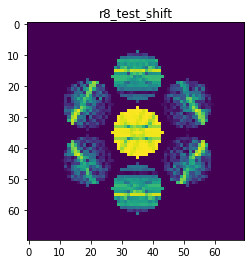

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9705710644596826
>>>replaced the 38. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 739ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.7038e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.2060e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 9.1571e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 9.5198e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


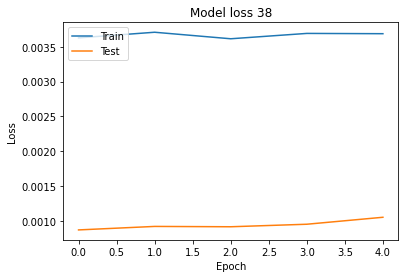

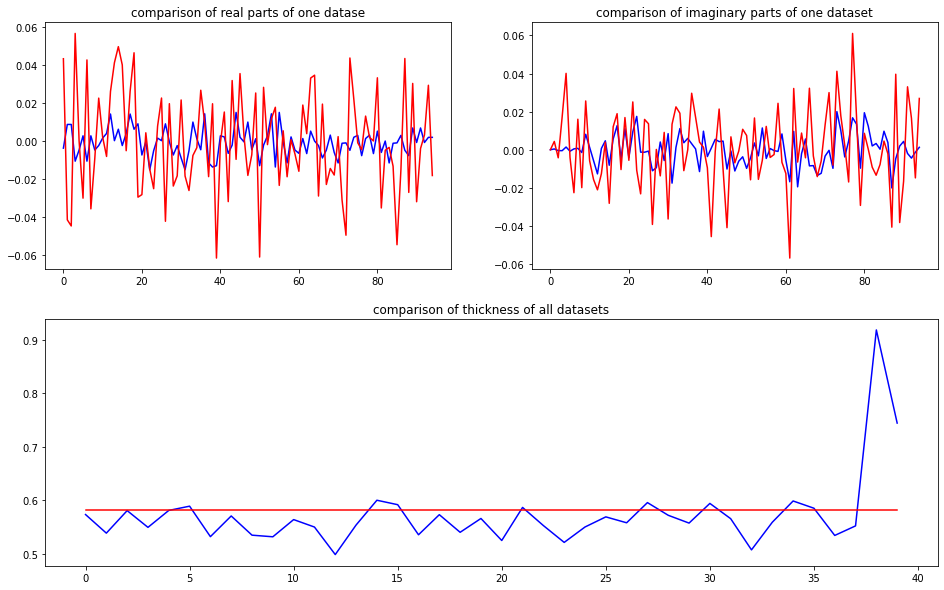

predicted thickness: 0.5818895


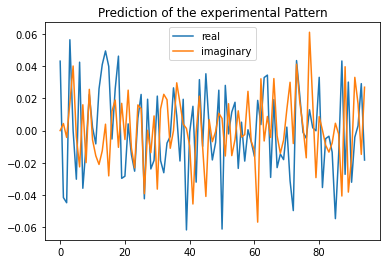

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=581.8895101547241
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.0430488 +0.j         -0.04324547+0.00430394j -0.04324547-0.00430394j
  0.04934942+0.01987027j -0.00472603+0.0299716j  -0.03303234-0.01001981j
  0.04934942-0.01987027j -0.03303234+0.01

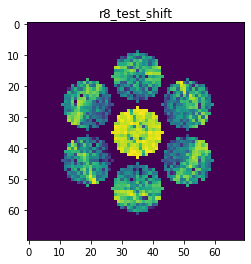

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9484431788396661
>>>replaced the 39. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 6.5046e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 5.9975e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 5.7879e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 6.0270e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 7.1792e-04 - val_acc: 1.0000


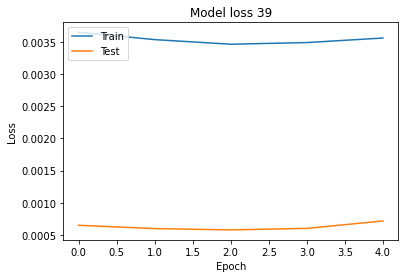

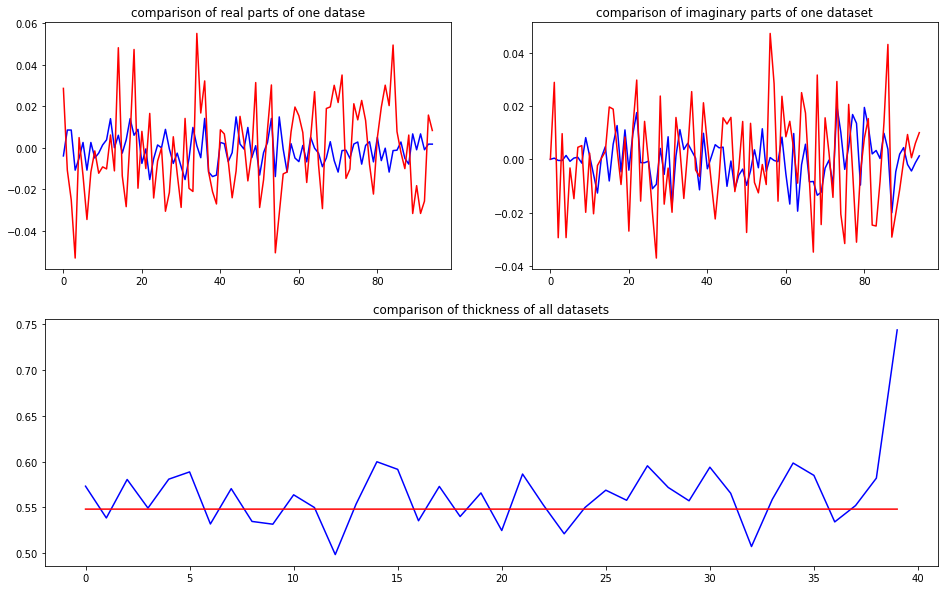

predicted thickness: 0.54801047


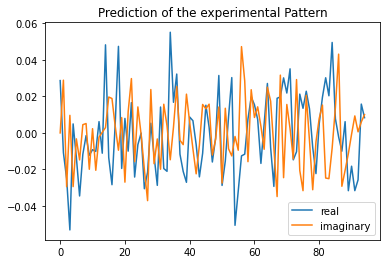

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=548.0104684829712
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02856383+0.j         -0.01797124+0.02913694j -0.01797124-0.02913694j
 -0.04386568+0.01215101j  0.00169692-0.01726909j -0.01254823-0.00387178j
 -0.04386568-0.01215101j -0.01254823+0.00

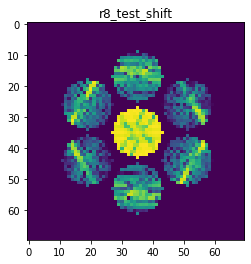

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9499526274376824
>>>replaced the 40. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 8.1680e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 8.3074e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 7.2961e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 707ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 7.0947e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 707ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 7.3679e-04 - val_acc: 1.0000


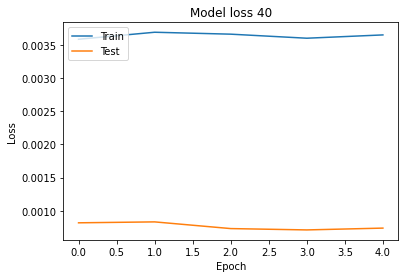

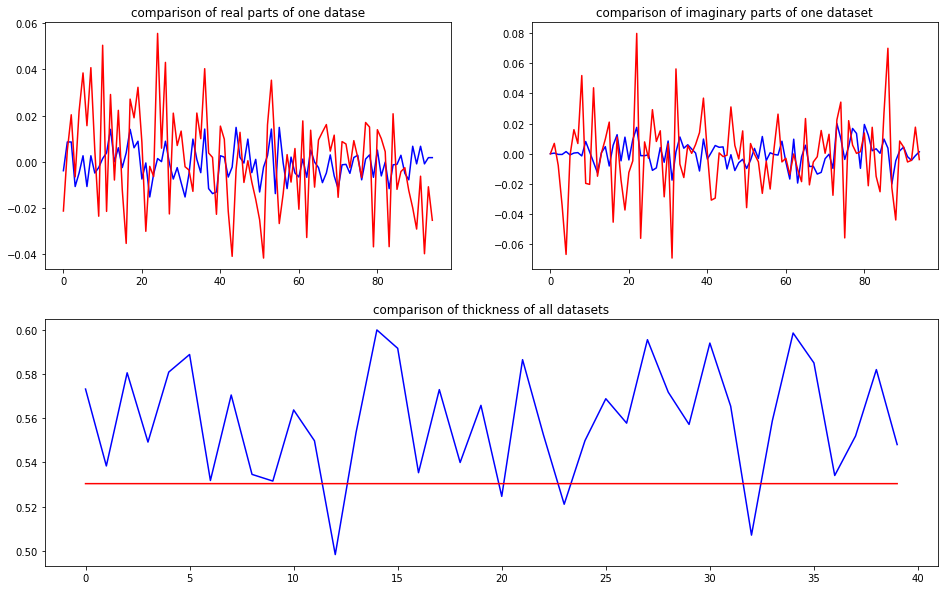

predicted thickness: 0.53035283


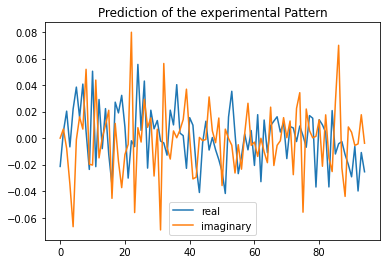

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=530.3528308868408
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02136196+0.00000000e+00j  0.01261222+7.30087492e-03j
  0.01261222-7.30087492e-03j  0.00451786-2.52950992e-02j
  0.01347114-5.93645293e-02j  0.03962503-4.00955405e-03j
  0.00451786+2.5

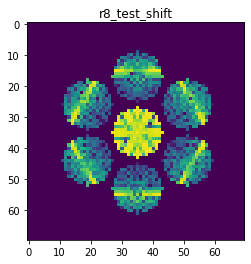

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9722335725979334
>>>replaced the 41. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 6.3067e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 6.2038e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 7.4649e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 683ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 7.5539e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 5.6486e-04 - val_acc: 1.0000


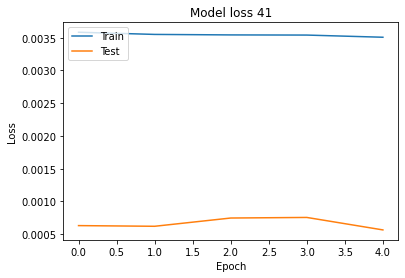

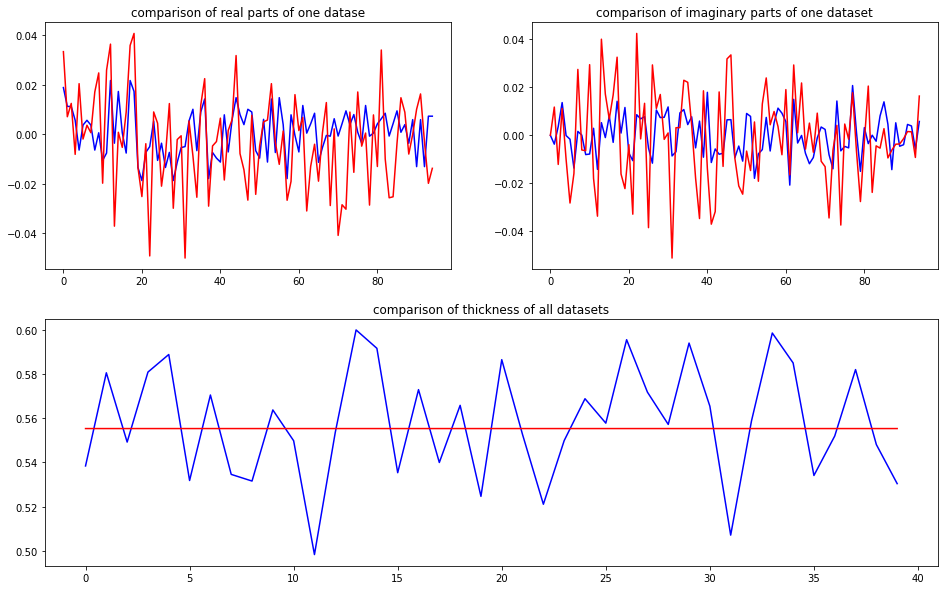

predicted thickness: 0.5552433


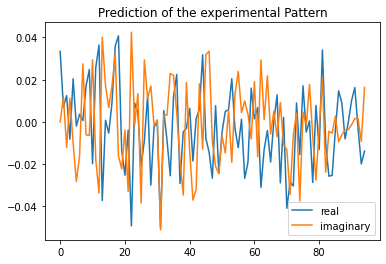

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.2433133125305
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 3.34128253e-02+0.j          9.76359076e-03+0.01195776j
  9.76359076e-03-0.01195776j -2.26439419e-03+0.01356069j
  1.87676884e-02-0.00190393j -6.71069225e-04-0.02784972j
 -2.26439419e-03

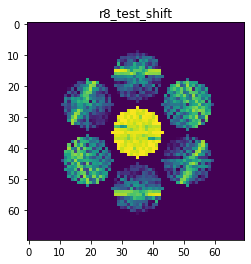

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9608795868062854
>>>replaced the 42. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 759ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 5.3745e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 6.6738e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 6.4386e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 5.7916e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 6.3431e-04 - val_acc: 1.0000


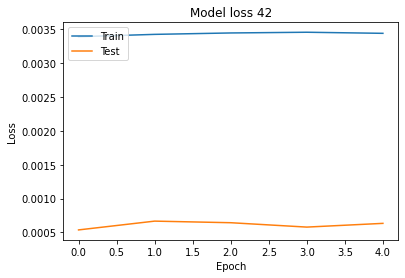

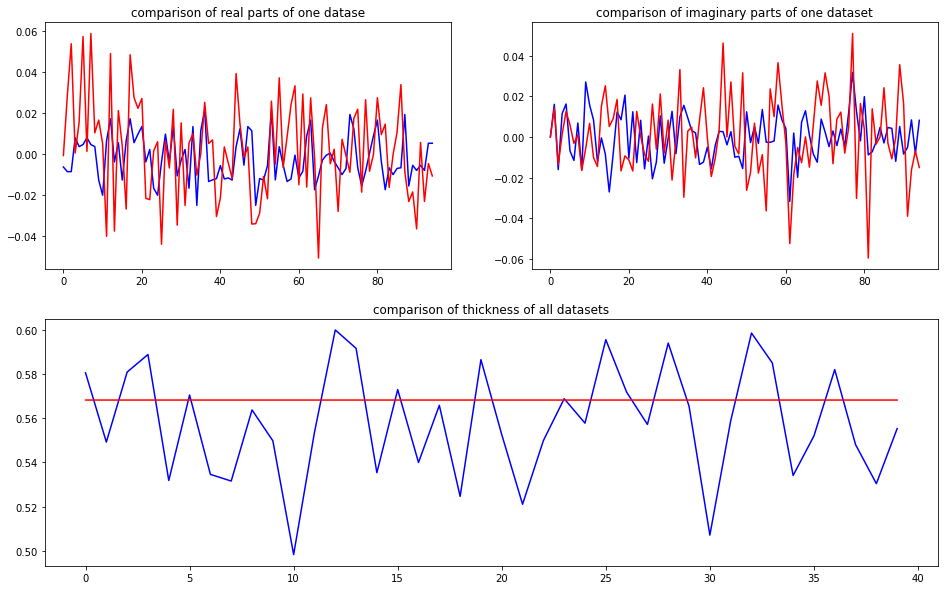

predicted thickness: 0.5681283


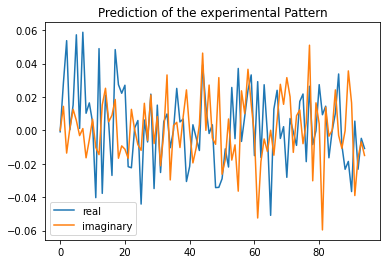

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=568.1282877922058
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00085414+0.j          0.04097195+0.01400847j  0.04097195-0.01400847j
  0.00076933+0.00224115j  0.01270743+0.01450379j  0.05786719+0.00242016j
  0.00076933-0.00224115j  0.05786719-0.00

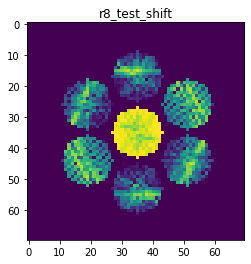

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9693725479355078
>>>replaced the 43. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 1s/step - loss: 0.0034 - acc: 1.0000 - val_loss: 4.6887e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 721ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 5.6206e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 707ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.2147e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 716ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 7.8137e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 719ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 7.0272e-04 - val_acc: 1.0000


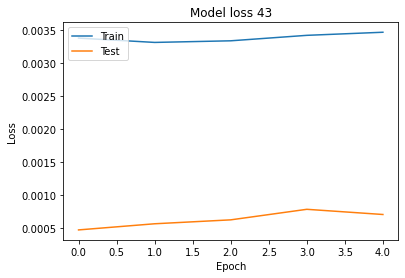

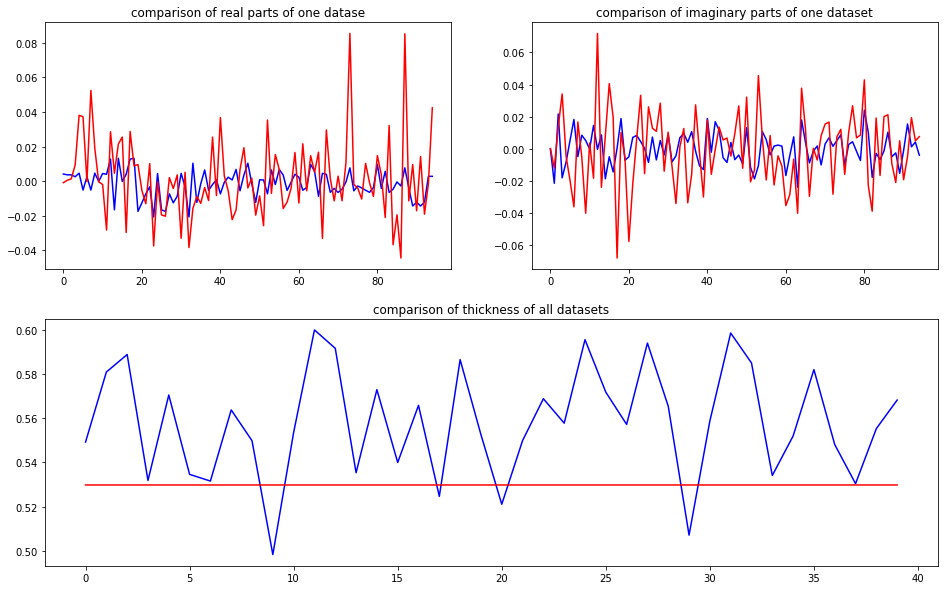

predicted thickness: 0.5297509


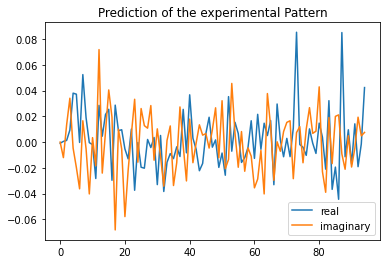

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=529.7508835792542
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0008544 +0.j          0.00092326-0.01280372j  0.00092326+0.01280372j
  0.00453517+0.03521864j  0.0284657 +0.00020978j  0.04479944-0.01813541j
  0.00453517-0.03521864j  0.04479944+0.01

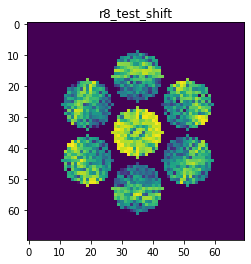

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8984539243104446
>>>replaced the 44. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 775ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.8571e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 726ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.0938e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 712ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 5.6406e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 716ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 5.9816e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 5.4394e-04 - val_acc: 1.0000


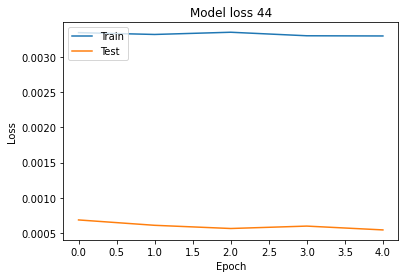

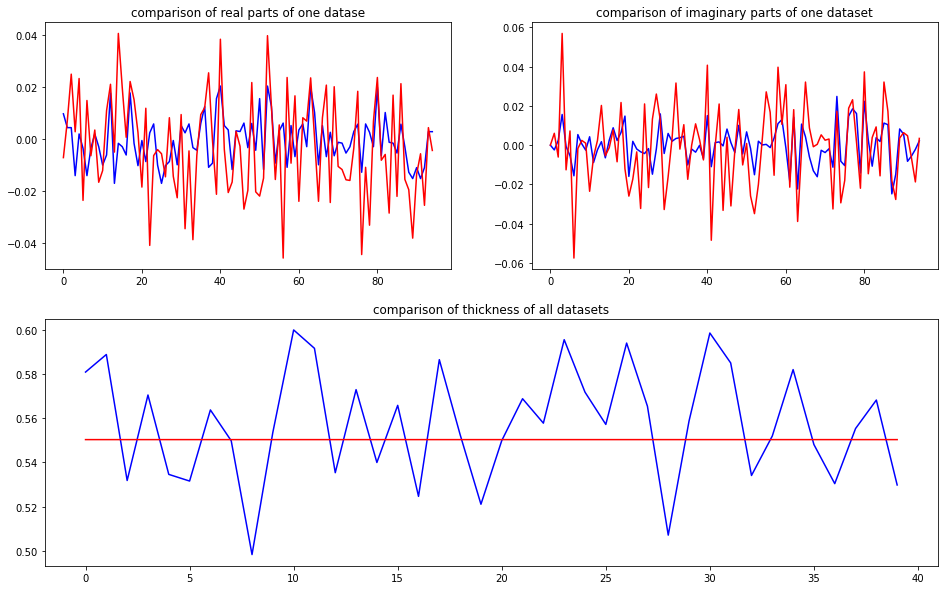

predicted thickness: 0.55024874


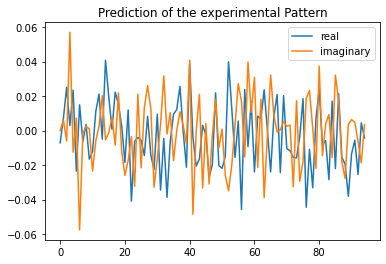

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=550.2487421035767
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-7.09469197e-03+0.j          1.60701585e-02+0.00606499j
  1.60701585e-02-0.00606499j  8.79855826e-03+0.05727837j
  1.34483804e-02-0.00751791j -1.49847146e-02+0.00448831j
  8.79855826e-03

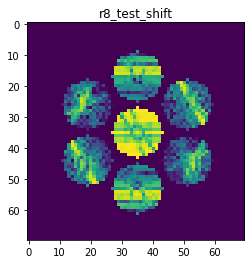

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9556962225270095
>>>replaced the 45. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 761ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.4862e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 8.0247e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 710ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.4504e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 5.9406e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 6.1398e-04 - val_acc: 1.0000


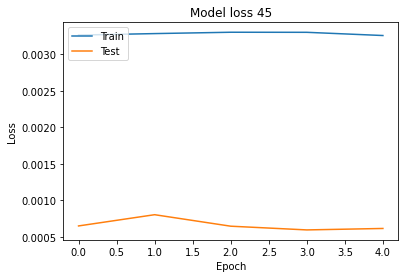

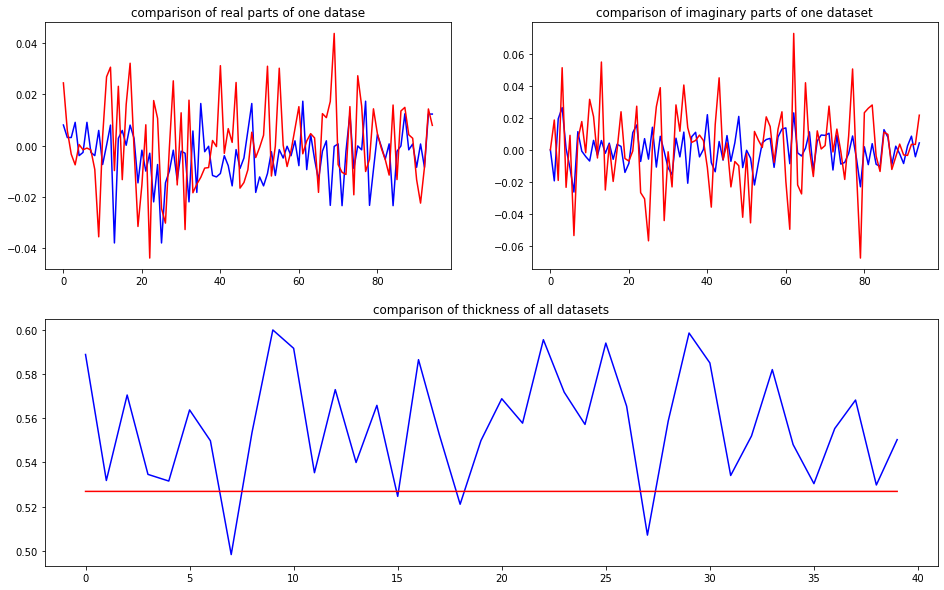

predicted thickness: 0.5268492


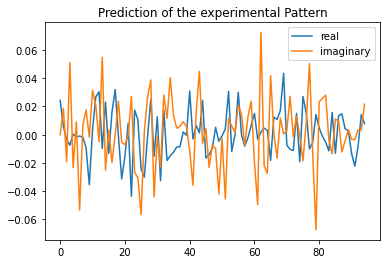

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=526.8492102622986
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02431877+0.j          0.00119352+0.01885432j  0.00119352-0.01885432j
 -0.00432201+0.05239662j -0.00448007-0.02053019j -0.0016934 +0.00124085j
 -0.00432201-0.05239662j -0.0016934 -0.00

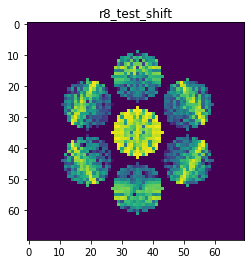

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9332890380992312
>>>replaced the 46. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 752ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 7.2714e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 5.7144e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 5.9445e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 7.0152e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 692ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 8.3924e-04 - val_acc: 1.0000


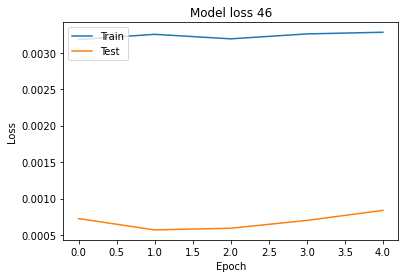

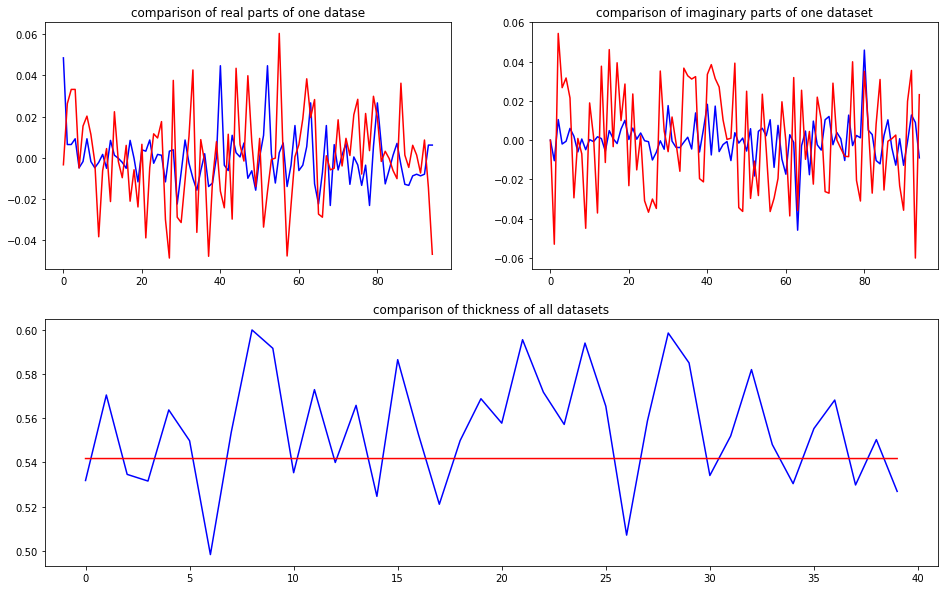

predicted thickness: 0.5416942


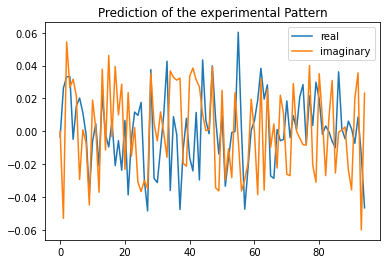

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=541.6942238807678
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00332339+0.j          0.02975153-0.05373594j  0.02975153+0.05373594j
  0.02673346+0.02808197j -0.0034036 +0.01934369j  0.01342028+0.01031335j
  0.02673346-0.02808197j  0.01342028-0.01

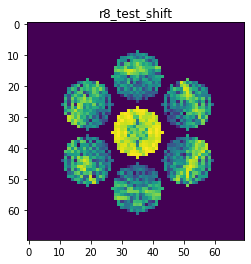

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9079784492262226
>>>replaced the 47. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 832ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.7350e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 725ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.3545e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 726ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 7.0735e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 727ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.2660e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.6953e-04 - val_acc: 1.0000


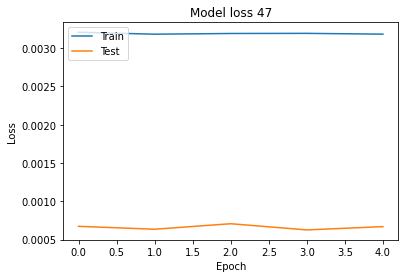

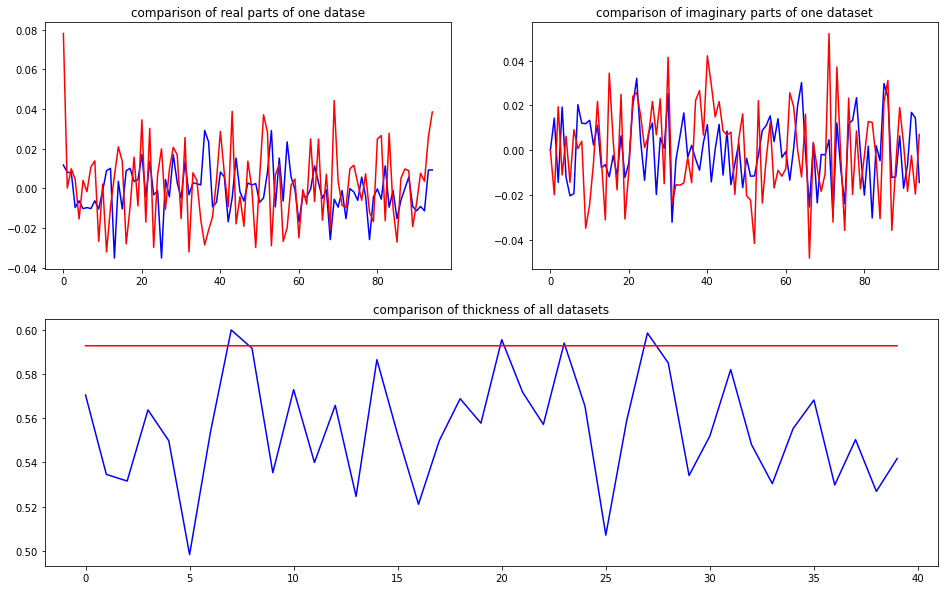

predicted thickness: 0.5926554


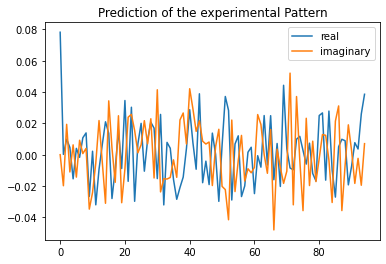

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=592.6554203033447
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.07792846+0.j          0.00503626-0.01960227j  0.00503626+0.01960227j
  0.00144941-0.01011599j -0.00077223+0.00111914j  0.00741314-0.00751065j
  0.00144941+0.01011599j  0.00741314+0.00

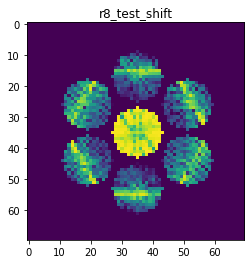

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9755486725861442
>>>replaced the 48. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 761ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.0010e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.6261e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 7.0760e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.8408e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 6.8649e-04 - val_acc: 1.0000


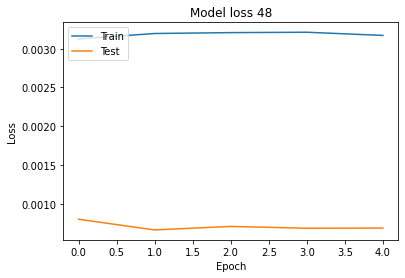

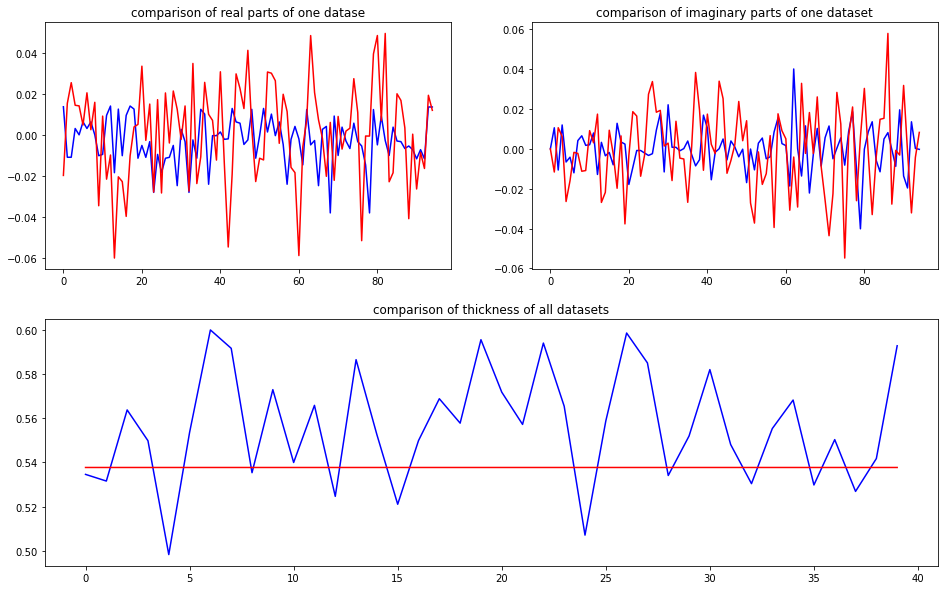

predicted thickness: 0.5376581


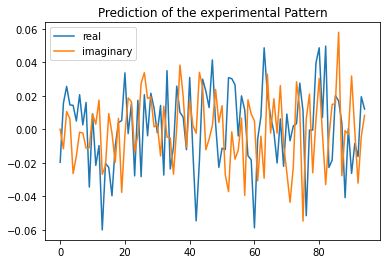

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=537.6580953598022
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01968277+0.j          0.02060964-0.01112777j  0.02060964+0.01112777j
  0.01764095+0.00398336j  0.01519095-0.00758643j  0.00379277-0.00687728j
  0.01764095-0.00398336j  0.00379277+0.00

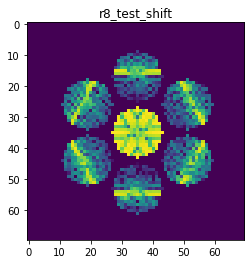

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9769886200762217
>>>replaced the 49. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 743ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 5.9853e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 6.4966e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 708ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 5.9400e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 695ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 6.0365e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 6.3255e-04 - val_acc: 1.0000


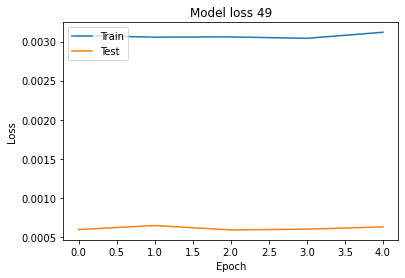

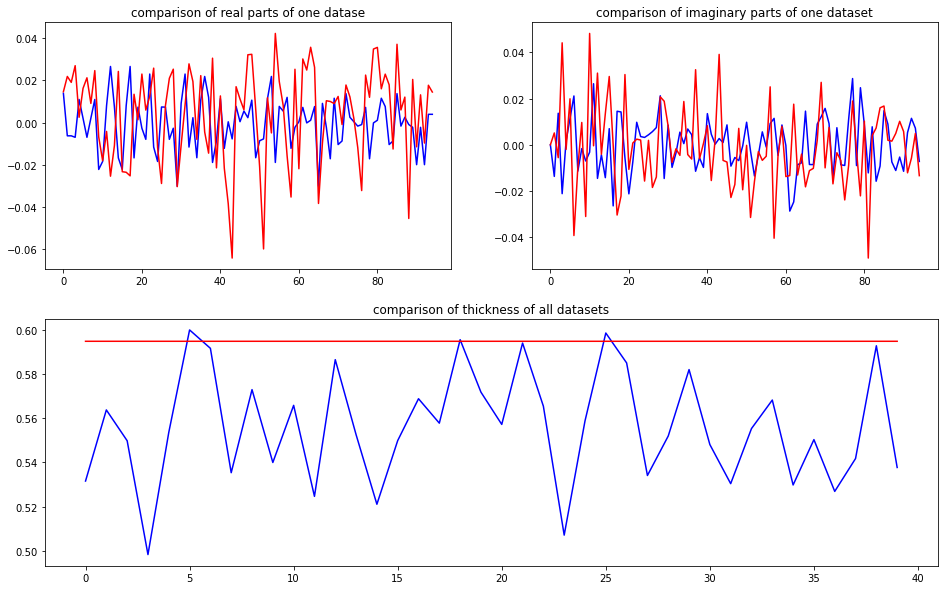

predicted thickness: 0.5946839


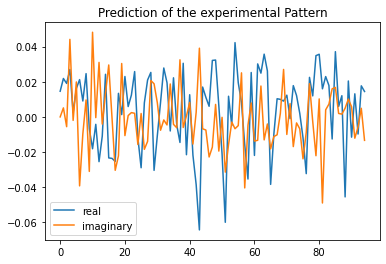

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=594.6838855743408
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01460936+0.j          0.0204697 +0.00534799j  0.0204697 -0.00534799j
  0.02420899+0.04166451j  0.01357141-0.00583256j  0.01263956+0.01479623j
  0.02420899-0.04166451j  0.01263956-0.01

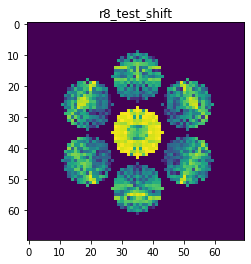

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9145558664324344
>>>replaced the 50. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 759ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 9.1989e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 7.7068e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.1422e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.9308e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 7.2523e-04 - val_acc: 1.0000


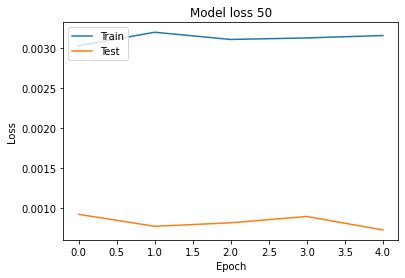

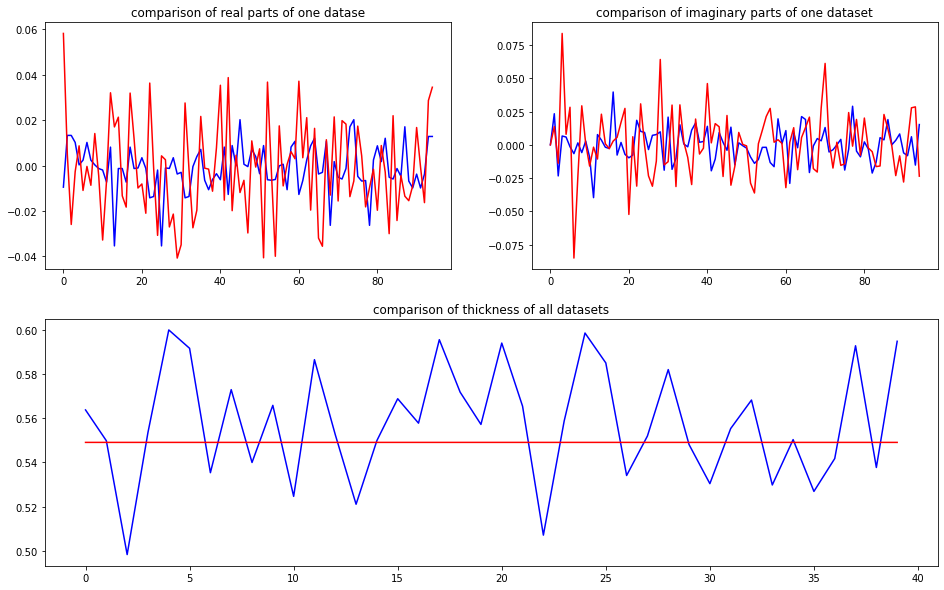

predicted thickness: 0.54899466


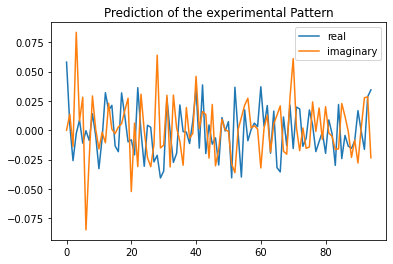

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=548.9946603775024
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.05826604+0.j         -0.01046282+0.01374525j -0.01046282-0.01374525j
 -0.00125269+0.08429823j  0.01141038-0.01070801j -0.00977763+0.026065j
 -0.00125269-0.08429823j -0.00977763-0.0260

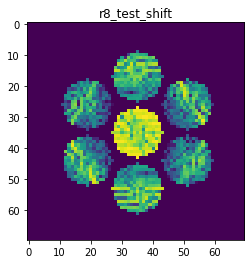

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9175661590440695
>>>replaced the 51. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 769ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 8.0968e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 715ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.1999e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 5.6738e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.5815e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.3157e-04 - val_acc: 1.0000


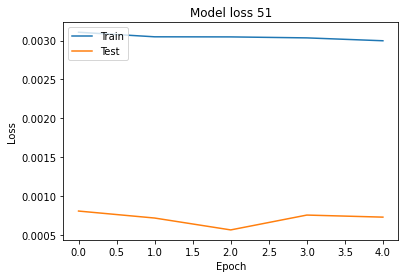

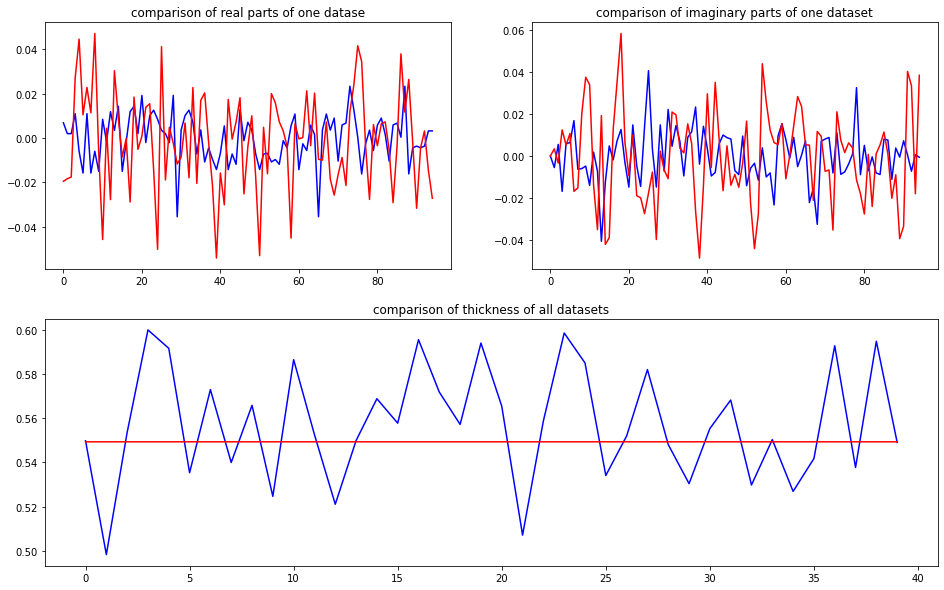

predicted thickness: 0.5492516


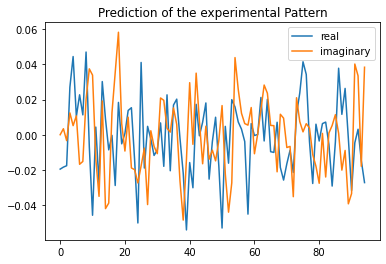

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.2516160011292
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01957382+0.j         -0.01803074+0.0033902j  -0.01803074-0.0033902j
  0.02491109+0.01462446j  0.04585991-0.00747787j  0.01086455+0.01297302j
  0.02491109-0.01462446j  0.01086455-0.012

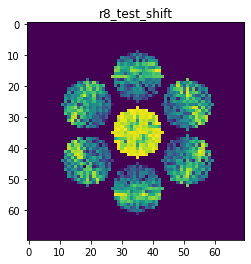

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9472341901181492
>>>replaced the 52. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 759ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 6.6006e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 6.4883e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 717ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 7.0232e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.5448e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 7.9268e-04 - val_acc: 1.0000


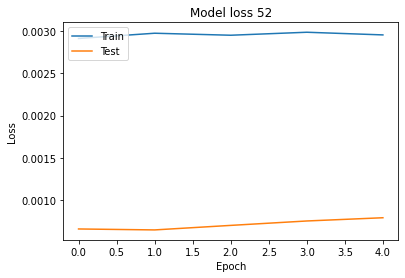

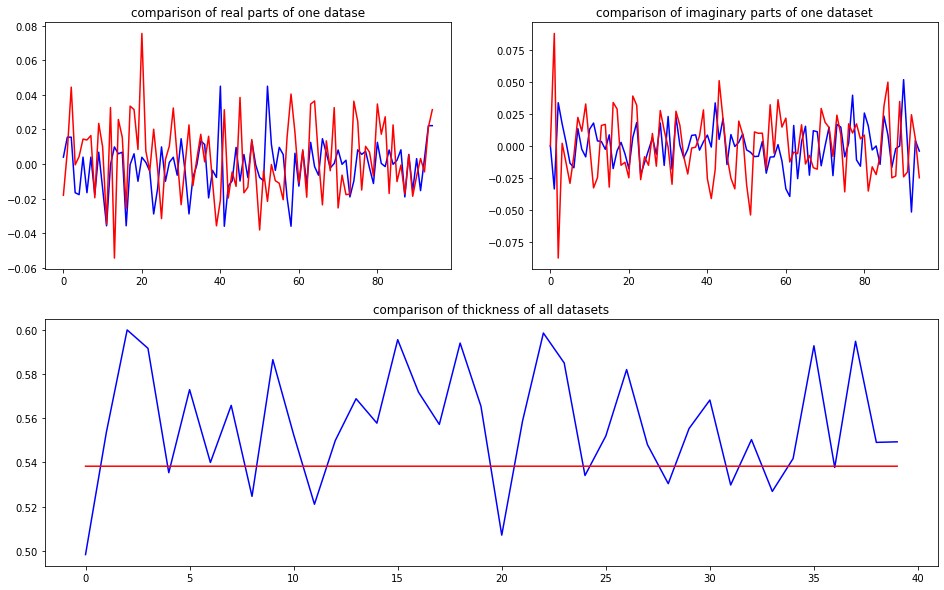

predicted thickness: 0.538228


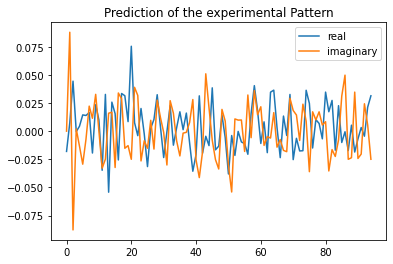

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=538.2279753684998
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01800754+0.j          0.02615268+0.08784772j  0.02615268-0.08784772j
  0.00674756+0.004636j   -0.00751395-0.01242402j  0.01548822-0.02579929j
  0.00674756-0.004636j    0.01548822+0.02

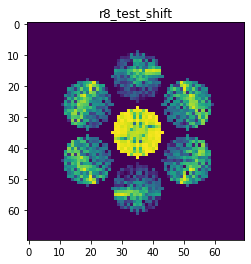

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9517115028574545
>>>replaced the 53. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 7.0020e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.0015e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.0370e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 5.7812e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 5.9421e-04 - val_acc: 1.0000


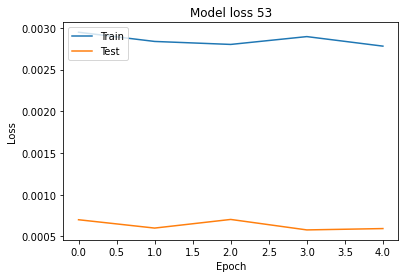

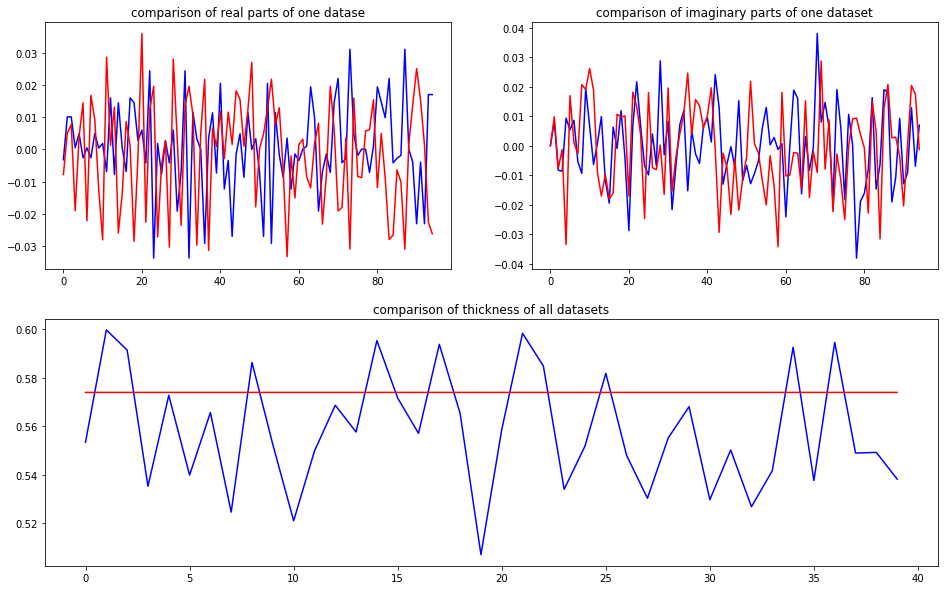

predicted thickness: 0.57402366


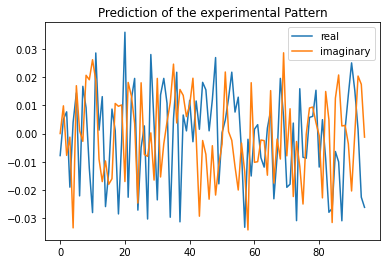

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=574.0236639976501
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00782261+0.j          0.00639333+0.00879878j  0.00639333-0.00879878j
 -0.02058603-0.00116935j  0.00661914-0.0270935j   0.0156148 +0.00988542j
 -0.02058603+0.00116935j  0.0156148 -0.00

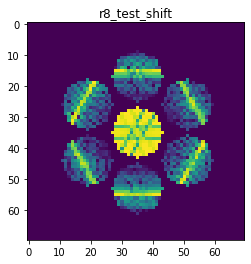

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9694574224535781
>>>replaced the 54. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 755ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.0943e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.1042e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.7907e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 7.0008e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 712ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.1194e-04 - val_acc: 1.0000


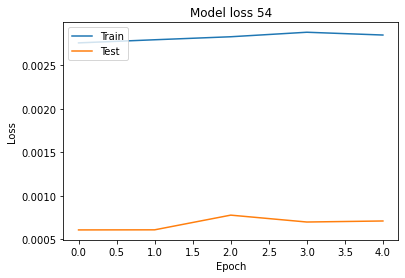

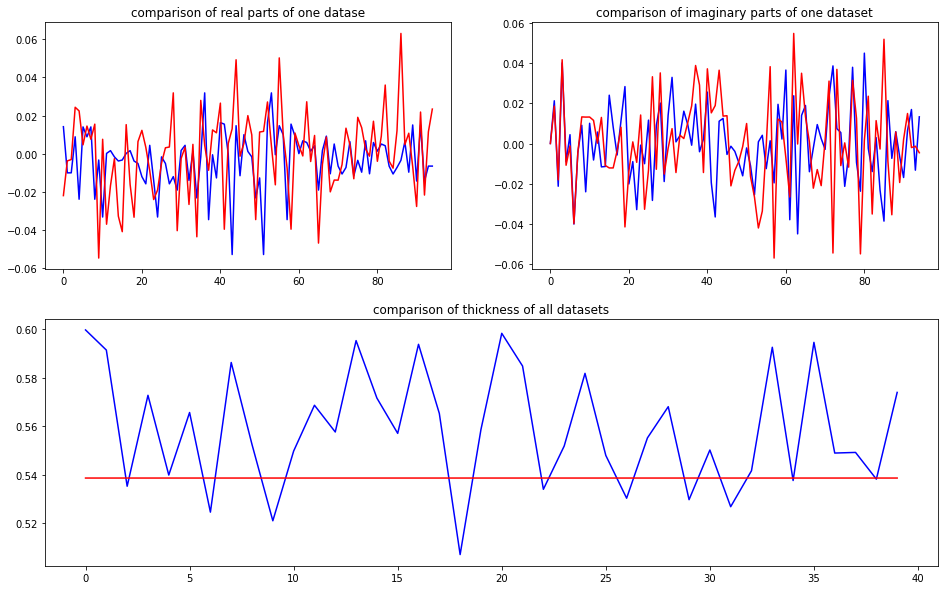

predicted thickness: 0.53867817


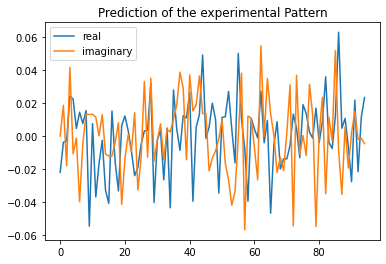

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=538.6781692504883
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.02195631+0.j         -0.00341753+0.01833432j -0.00341753-0.01833432j
  0.019463  +0.04077118j  0.01895473-0.01201492j  0.00611051+0.00165028j
  0.019463  -0.04077118j  0.00611051-0.00

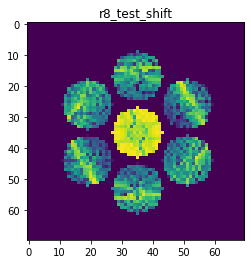

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9205627764788548
>>>replaced the 55. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 762ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.4863e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 6.0321e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 5.4683e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 7.6453e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 704ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 8.0650e-04 - val_acc: 1.0000


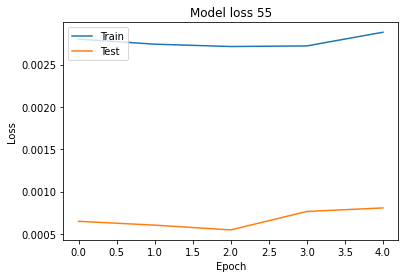

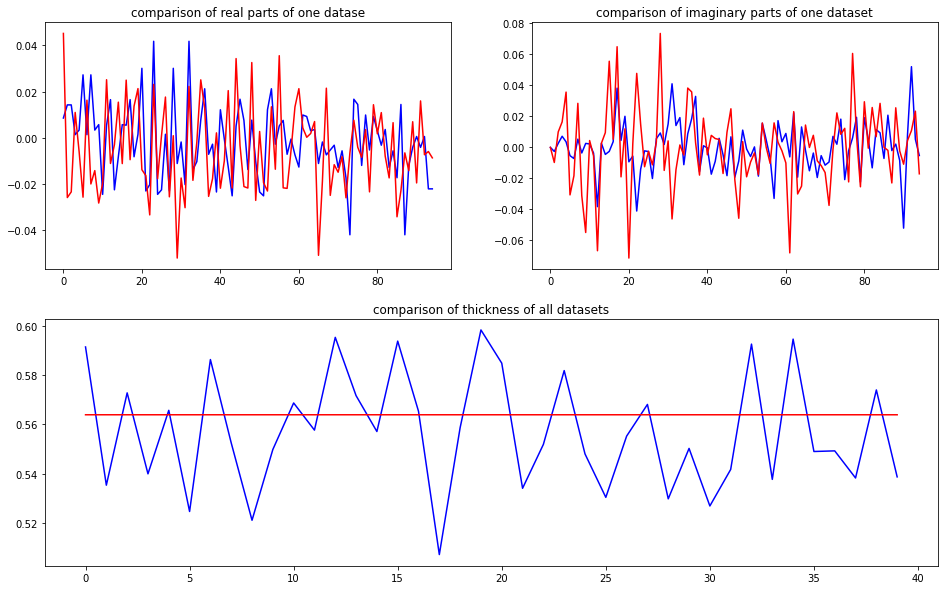

predicted thickness: 0.5639278


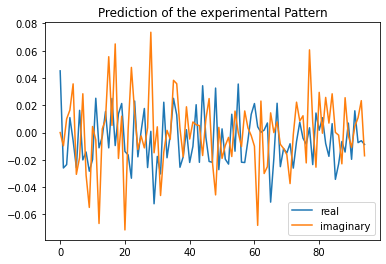

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.9278292655945
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.04531298+0.j         -0.02469788-0.00985088j -0.02469788+0.00985088j
  0.01363091+0.01737584j -0.01003887+0.03339556j -0.02286106-0.02951674j
  0.01363091-0.01737584j -0.02286106+0.02

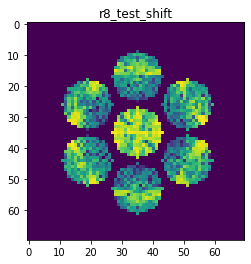

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8496229115830871
>>>replaced the 56. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.4306e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.0128e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.8928e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 715ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.4622e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.9377e-04 - val_acc: 1.0000


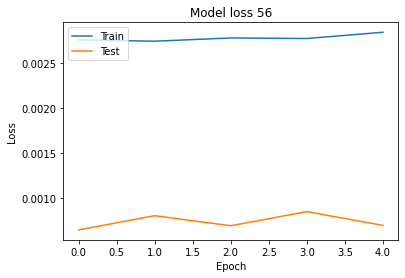

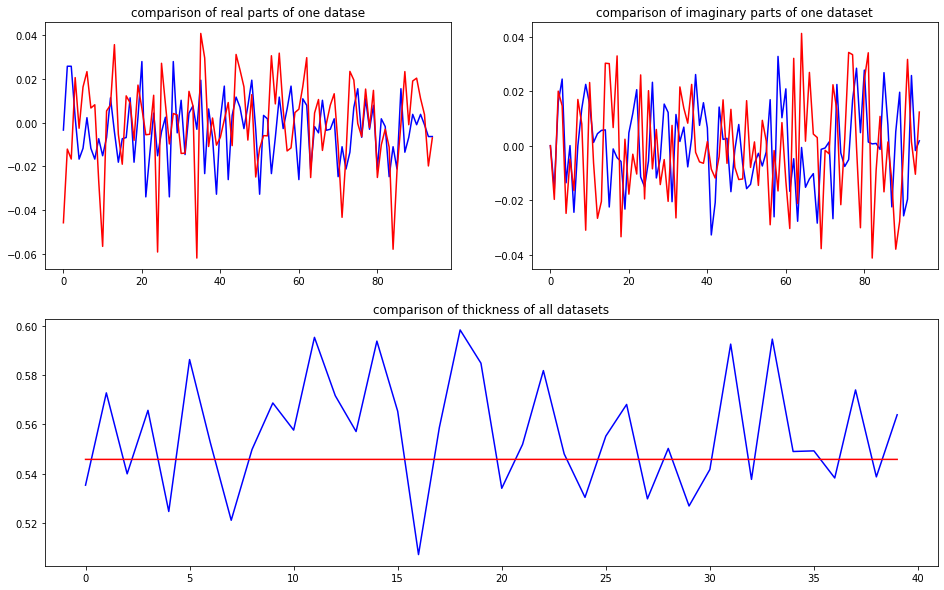

predicted thickness: 0.5457874


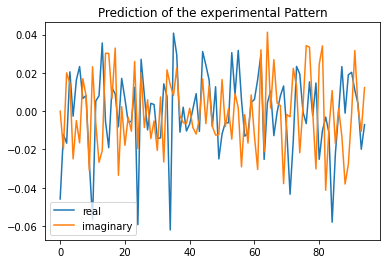

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=545.7873940467834
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.04583727+0.00000000e+00j -0.01441337-1.98843637e-02j
 -0.01441337+1.98843637e-02j  0.02194838+1.55817890e-02j
  0.002774  -1.64468745e-02j  0.01148159-1.09534573e-02j
  0.02194838-1.5

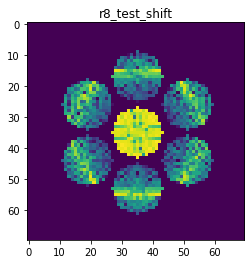

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9777854681217562
>>>replaced the 57. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 7.9920e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.7278e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 8.1663e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 6.7703e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


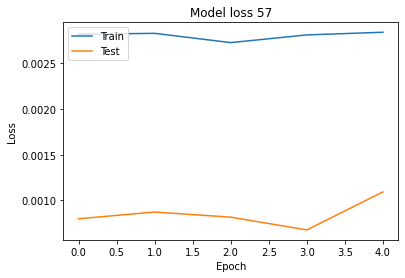

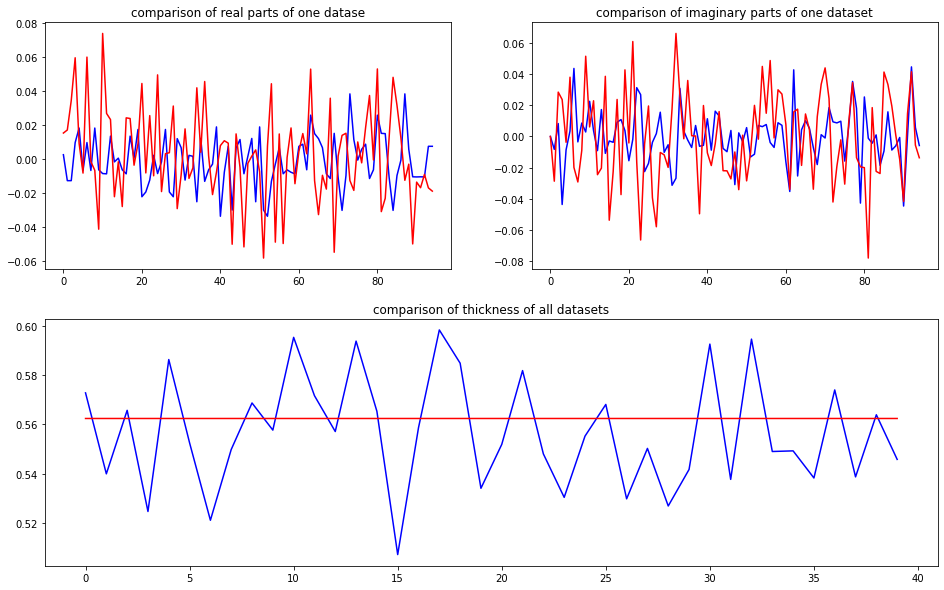

predicted thickness: 0.5624202


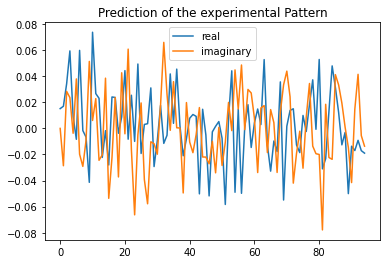

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.4201893806458
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01517261+0.j          0.02561347-0.02851448j  0.02561347+0.02851448j
  0.05957013+0.02173375j  0.00119312+0.00261265j -0.00503329+0.03353799j
  0.05957013-0.02173375j -0.00503329-0.03

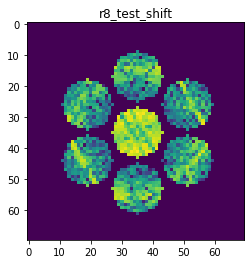

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9565160077147213
>>>replaced the 58. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 761ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.0105e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 709ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.2384e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 8.1986e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.3478e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 6.5862e-04 - val_acc: 1.0000


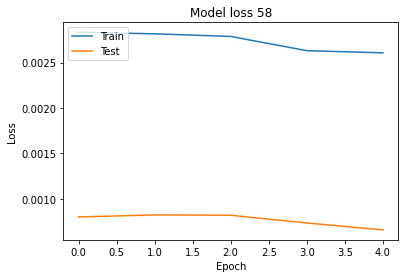

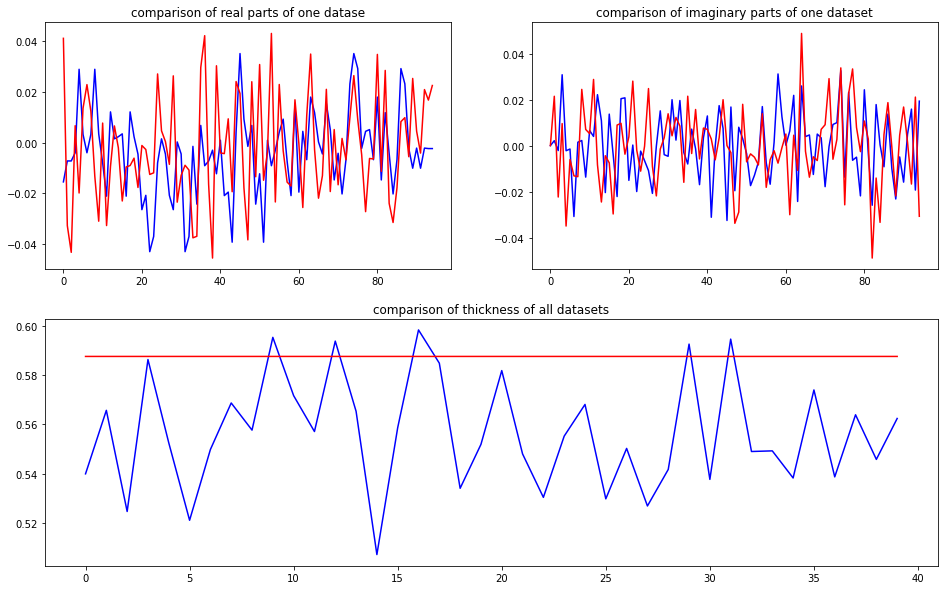

predicted thickness: 0.58764833


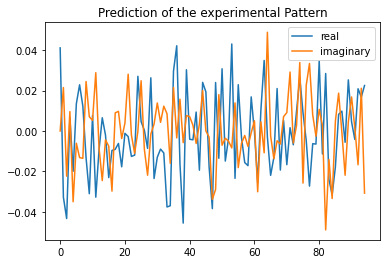

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=587.648332118988
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.04113371+0.j         -0.03798812+0.02190975j -0.03798812-0.02190975j
  0.01474348+0.01136344j -0.01655056-0.0297228j   0.01293366+0.00372387j
  0.01474348-0.01136344j  0.01293366-0.003

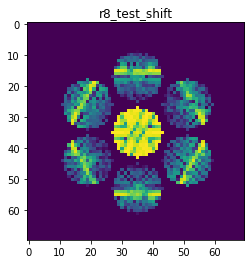

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9852233330205832
>>>replaced the 59. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 757ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 6.5139e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.2948e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.8376e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 5.9424e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.0854e-04 - val_acc: 1.0000


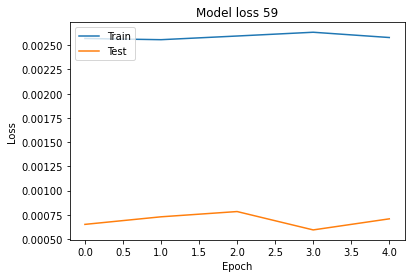

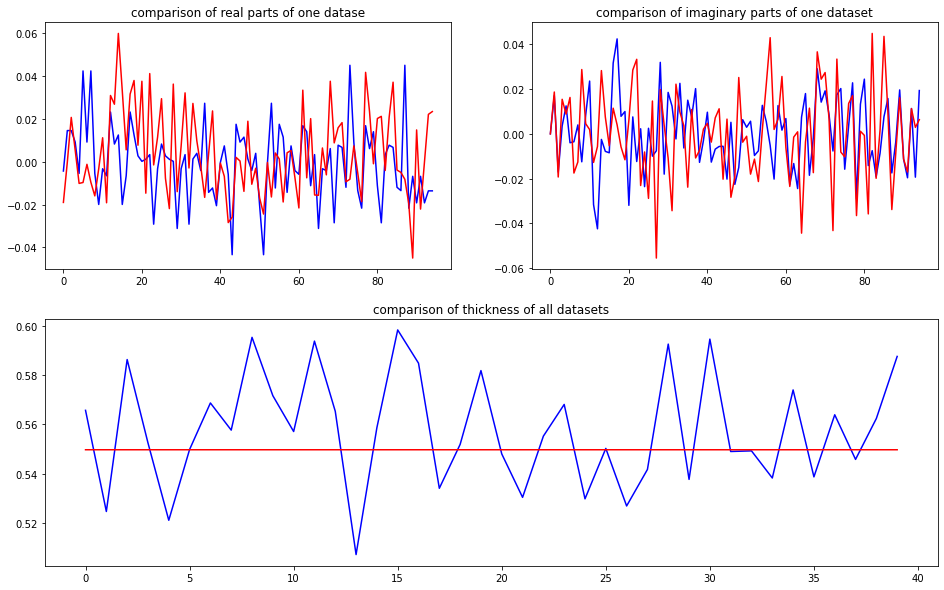

predicted thickness: 0.54970694


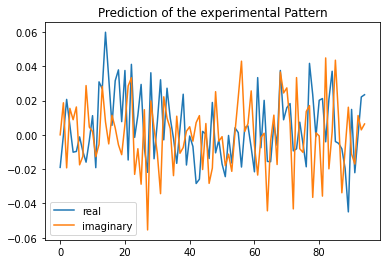

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.7069358825684
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-1.89832821e-02+0.j          1.02186997e-02+0.01896289j
  1.02186997e-02-0.01896289j  2.12553213e-03+0.01645656j
 -1.30270682e-02-0.00995146j -9.64723947e-03+0.01439841j
  2.12553213e-03

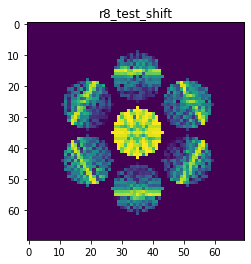

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9749867265809843
>>>replaced the 60. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 745ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.1728e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 7.2860e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 692ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 6.5349e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 9.6686e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 8.3310e-04 - val_acc: 1.0000


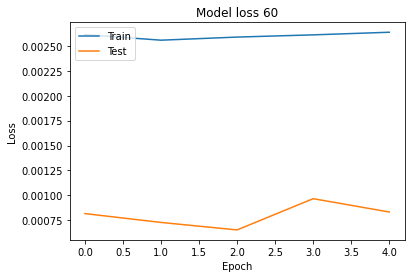

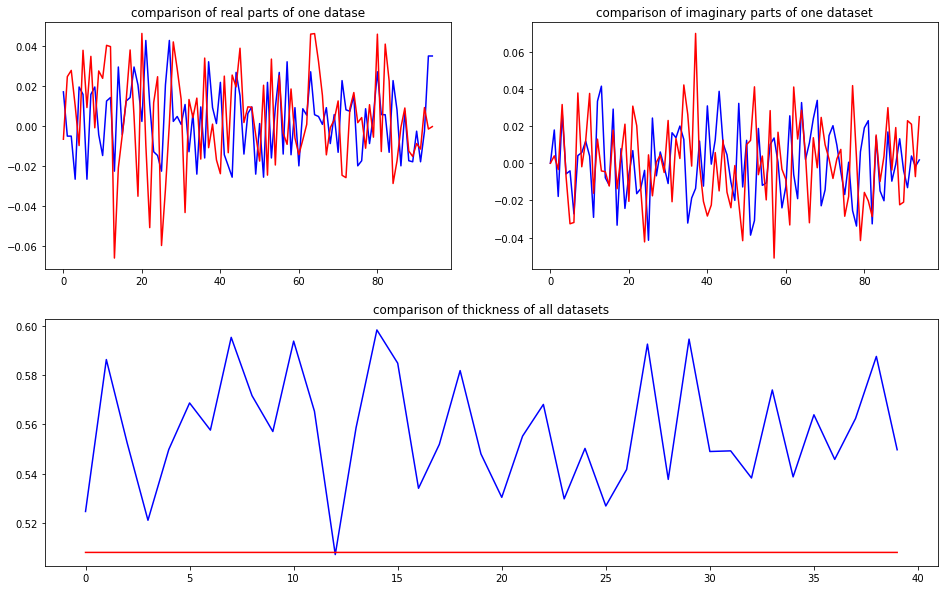

predicted thickness: 0.507967


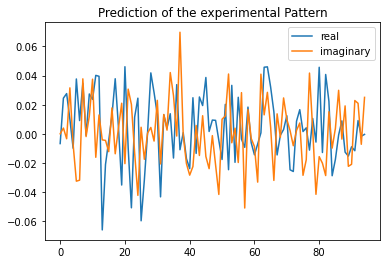

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=507.9669952392578
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00671299+0.j          0.02610087+0.00367093j  0.02610087-0.00367093j
  0.00961646+0.03170765j -0.00544555-0.00268079j  0.03627646-0.03515754j
  0.00961646-0.03170765j  0.03627646+0.03

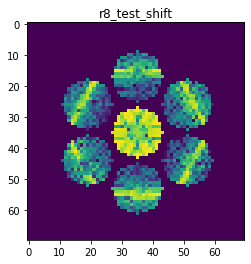

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9709843494787508
>>>replaced the 61. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 743ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 6.4776e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 7.3055e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.0369e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 689ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 6.9654e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 6.7106e-04 - val_acc: 1.0000


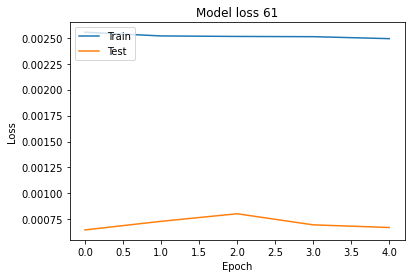

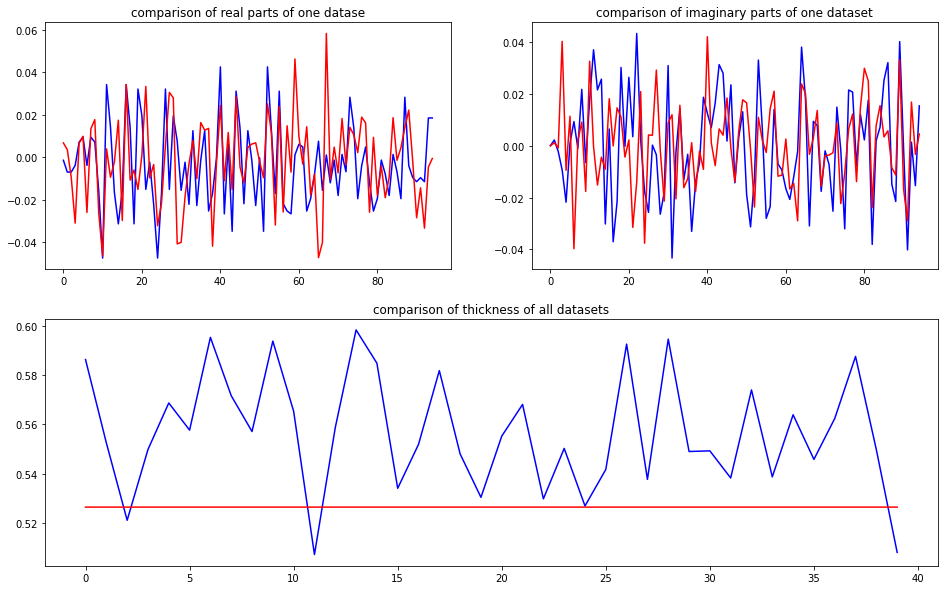

predicted thickness: 0.5263901


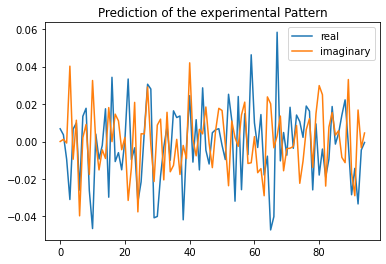

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=526.3900756835938
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00680073+0.j         -0.00295111+0.00098483j -0.00295111-0.00098483j
 -0.02852308+0.03999222j  0.01218762-0.00929773j  0.01168064+0.0046566j
 -0.02852308-0.03999222j  0.01168064-0.004

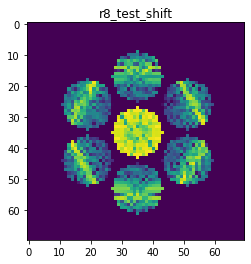

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9411874891819428
>>>replaced the 62. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 762ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.7500e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 698ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 8.1551e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 6.9661e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 8.0702e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 6.2511e-04 - val_acc: 1.0000


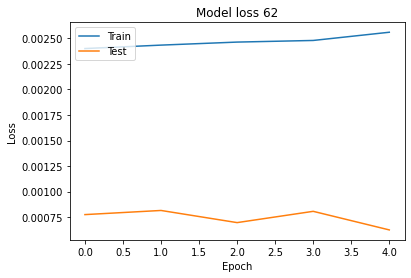

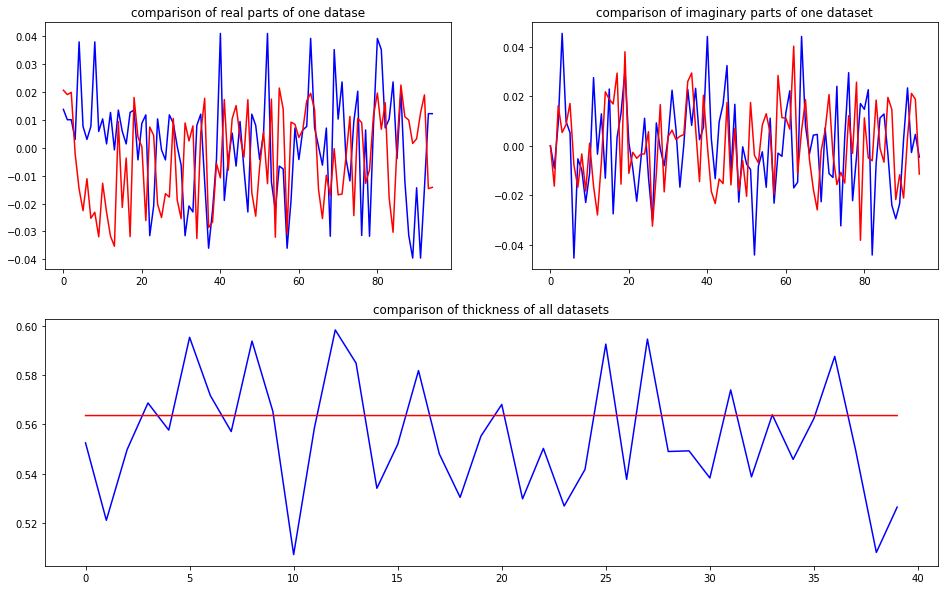

predicted thickness: 0.5636072


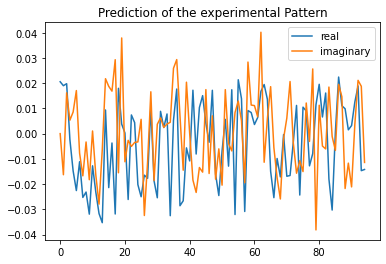

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.6072158813477
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02056022+0.j          0.01938587-0.01622733j  0.01938587+0.01622733j
 -0.00670849+0.00654301j -0.01894354+0.00593209j -0.023922  +0.01689256j
 -0.00670849-0.00654301j -0.023922  -0.01

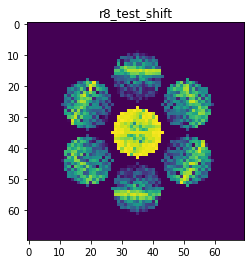

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9476440412478142
>>>replaced the 63. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 744ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.8109e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 7.6470e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.0110e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 6.3380e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.6270e-04 - val_acc: 1.0000


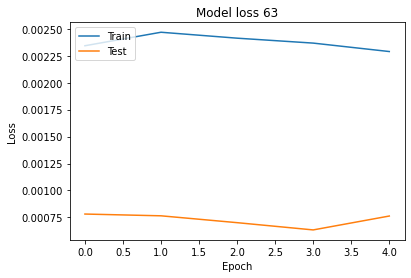

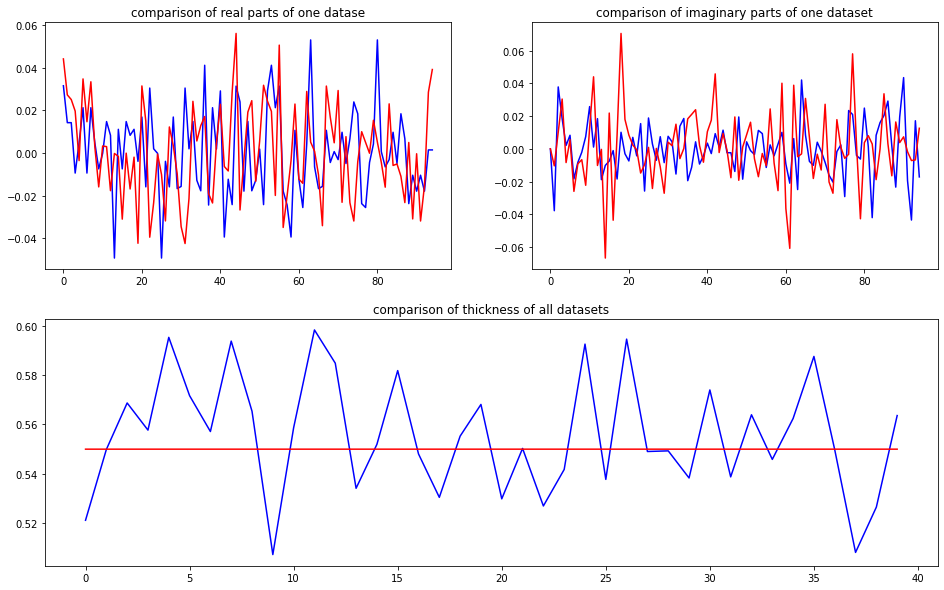

predicted thickness: 0.5499447


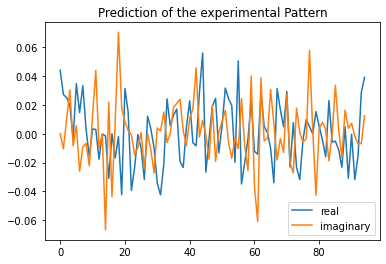

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=549.9446988105774
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.04419947+0.j          0.02622013-0.01030434j  0.02622013+0.01030434j
  0.01722592+0.02821358j -0.0001995 -0.00087347j  0.0341396 +0.00738271j
  0.01722592-0.02821358j  0.0341396 -0.00

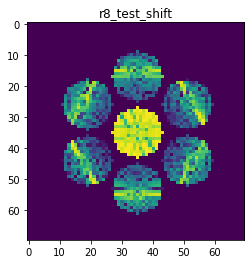

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9687834108414151
>>>replaced the 64. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 755ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 6.8314e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 6.8241e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 8.2973e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 6.4561e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 7.7266e-04 - val_acc: 1.0000


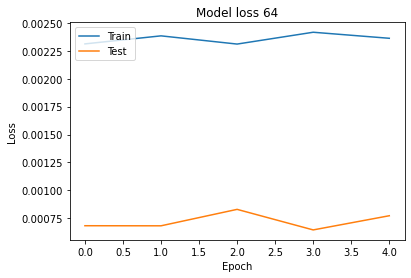

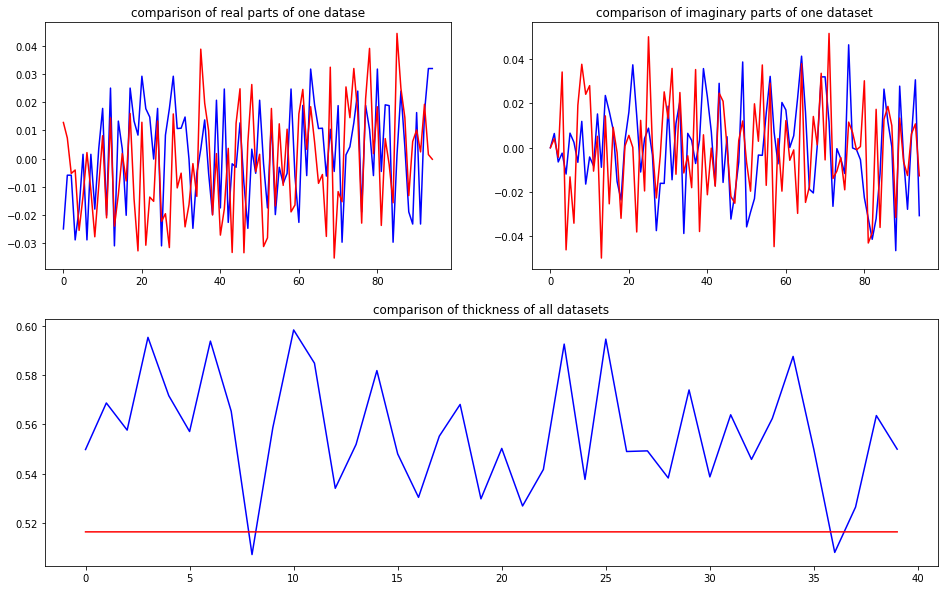

predicted thickness: 0.5163193


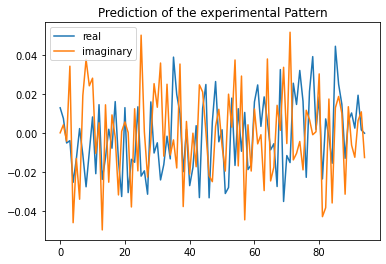

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=516.3192749023438
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01283952+0.j          0.00106039+0.0042207j   0.00106039-0.0042207j
 -0.00085678+0.03411154j -0.02640847-0.04185221j -0.01223262-0.01614561j
 -0.00085678-0.03411154j -0.01223262+0.016

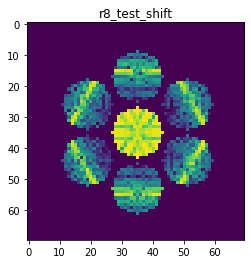

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9720251989826337
>>>replaced the 65. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 759ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 5.8224e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 6.5757e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 703ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.5000e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.5047e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 7.5962e-04 - val_acc: 1.0000


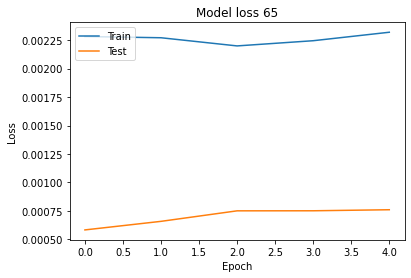

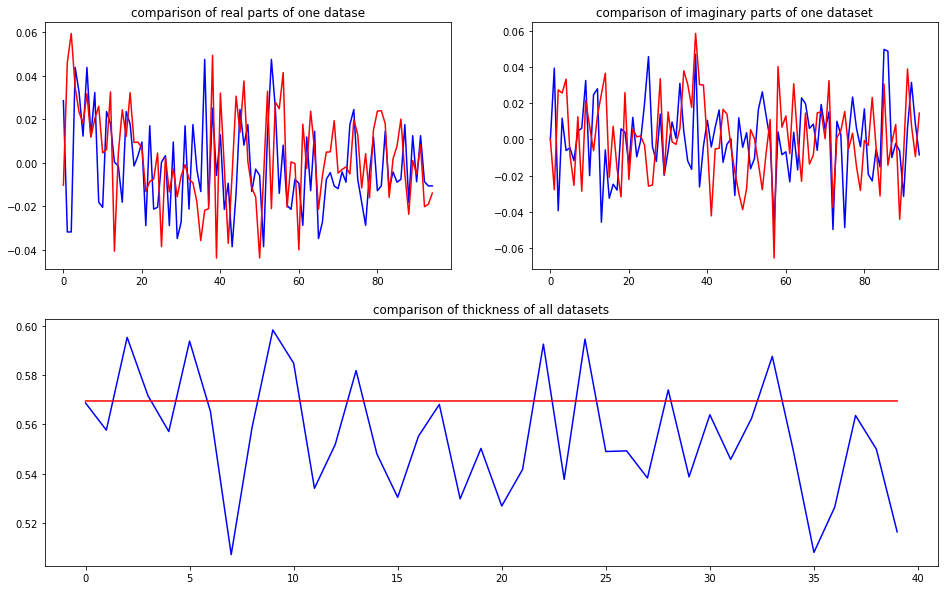

predicted thickness: 0.56953675


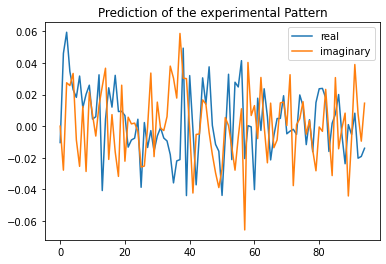

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=569.5367455482483
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.0103798 +0.j          0.05282077-0.02766015j  0.05282077+0.02766015j
  0.03316158+0.0255617j   0.02166194+0.03101863j  0.0149526 -0.01062701j
  0.03316158-0.0255617j   0.0149526 +0.01

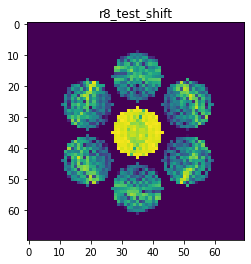

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9887390391660319
>>>replaced the 66. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 769ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 5.8452e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 6.8879e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 6.9529e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 722ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 5.7120e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.3699e-04 - val_acc: 1.0000


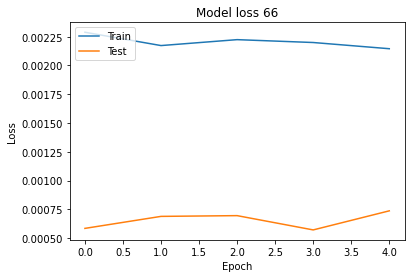

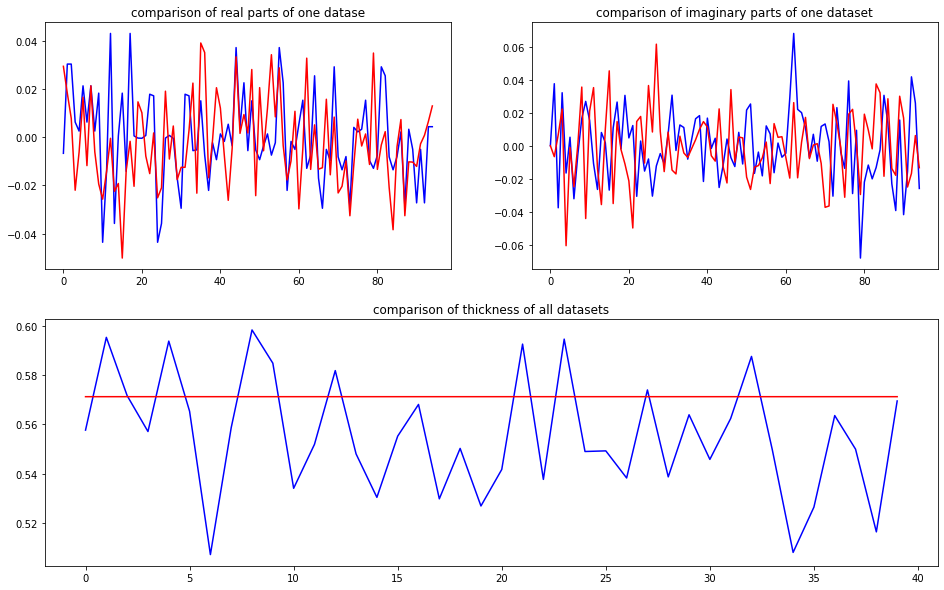

predicted thickness: 0.5712822


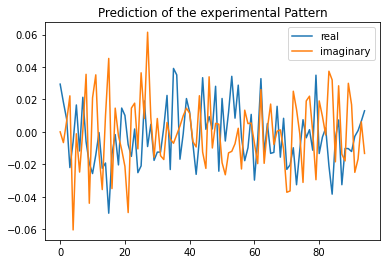

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.2822079658508
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02946069+0.j          0.0130544 -0.00663878j  0.0130544 +0.00663878j
 -0.01686222+0.02350251j -0.00606385-0.04794041j  0.01898018-0.00103141j
 -0.01686222-0.02350251j  0.01898018+0.00

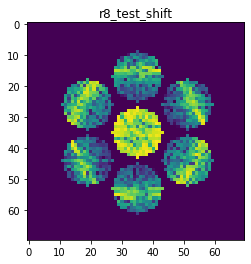

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9480746116668181
>>>replaced the 67. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 758ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.5156e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 708ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 6.4997e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 716ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 5.5064e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 5.1941e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 707ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.6745e-04 - val_acc: 1.0000


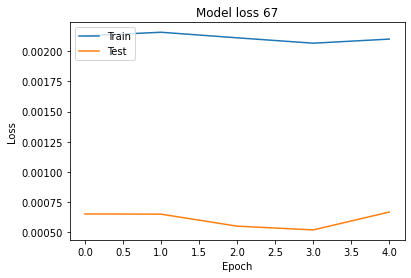

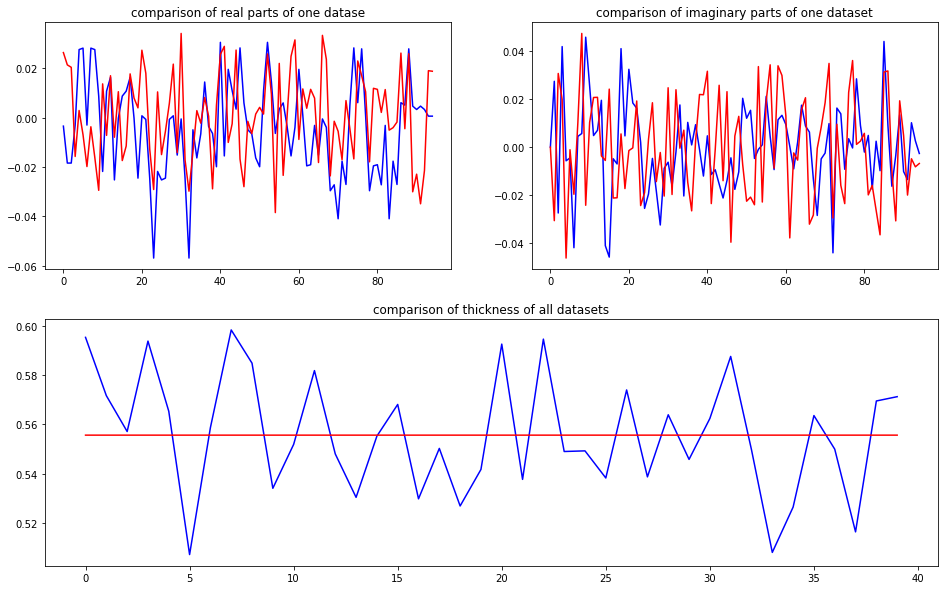

predicted thickness: 0.5556463


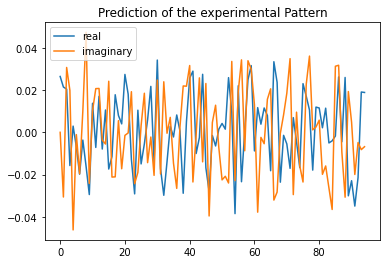

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.6463003158569
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02640418+0.j          0.02090166-0.03065405j  0.02090166+0.03065405j
 -0.01778938+0.01974483j -0.00665331-0.04677506j -0.00528751-0.00559801j
 -0.01778938-0.01974483j -0.00528751+0.00

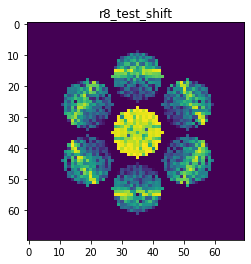

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9560940053739484
>>>replaced the 68. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.2035e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.6763e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.9982e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 7.4305e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 8.5090e-04 - val_acc: 1.0000


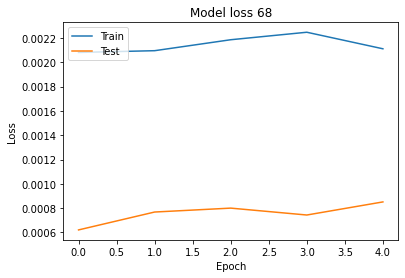

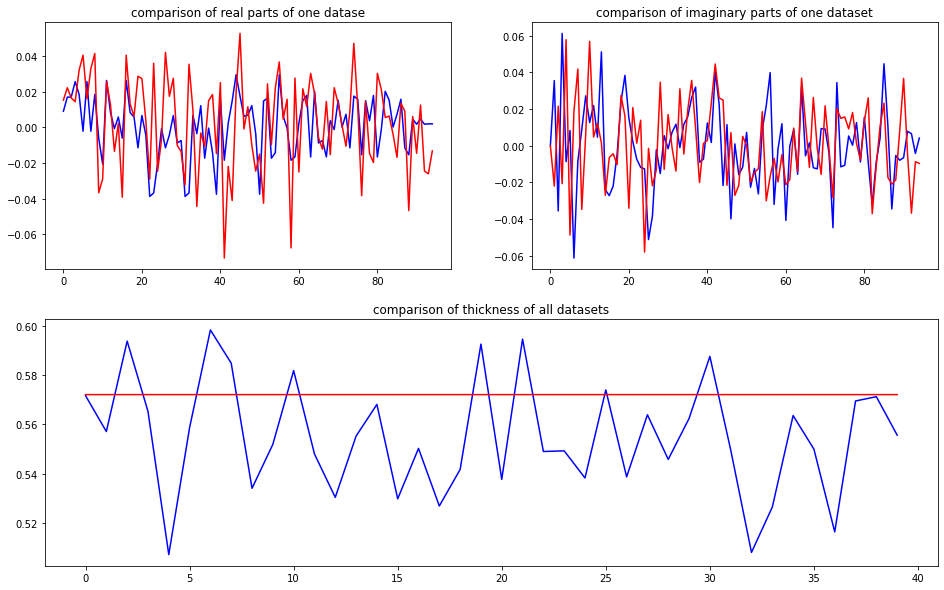

predicted thickness: 0.5721251


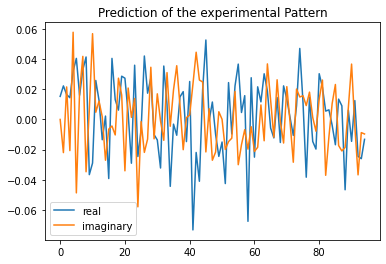

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=572.1250772476196
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01530027+0.j          0.0193589 -0.02181803j  0.0193589 +0.02181803j
  0.01521815-0.0197099j   0.03663298+0.04630137j  0.03666117-0.04535153j
  0.01521815+0.0197099j   0.03666117+0.04

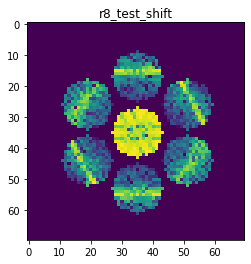

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9786048921382016
>>>replaced the 69. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 772ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 6.3996e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 8.0463e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 704ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 7.6906e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 709ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 6.6652e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 715ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 7.0552e-04 - val_acc: 1.0000


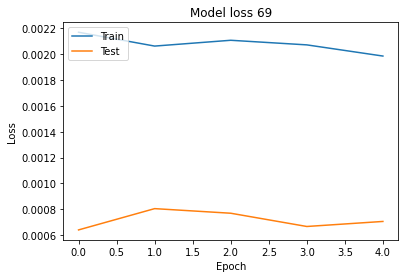

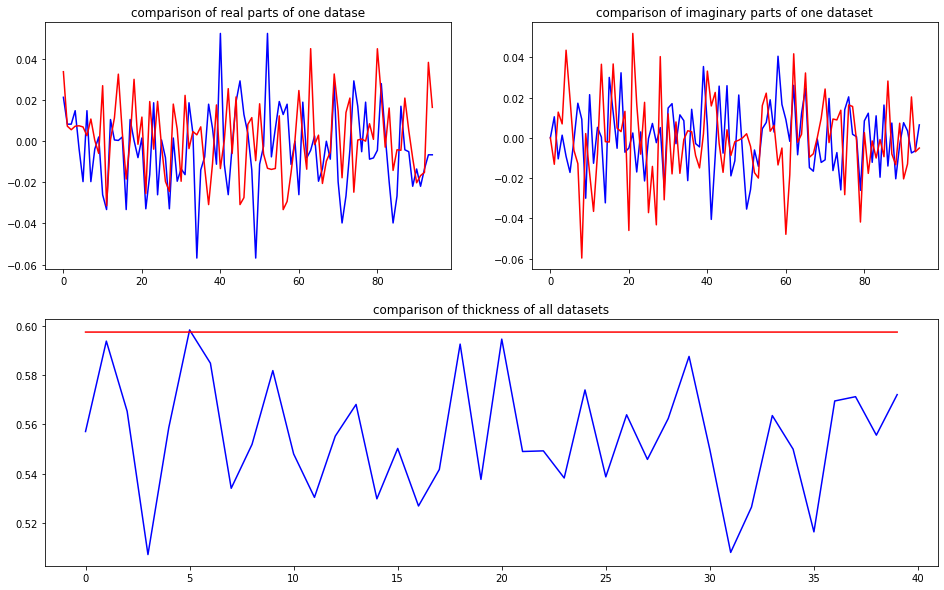

predicted thickness: 0.59754944


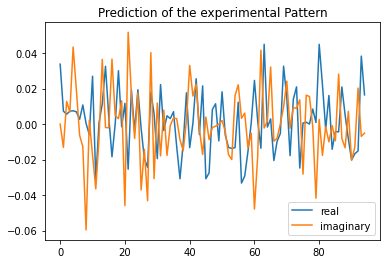

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=597.5494384765625
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03378418+0.00000000e+00j  0.00644105-1.29414382e-02j
  0.00644105+1.29414382e-02j  0.00499221+6.55045314e-03j
  0.00393306+5.15560508e-02j  0.00885835+1.61511991e-02j
  0.00499221-6.5

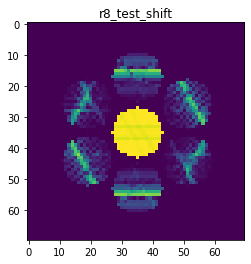

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9975247921151783
>>>replaced the 70. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 744ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 6.9529e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 5.5911e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.5771e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 6.5348e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 5.9863e-04 - val_acc: 1.0000


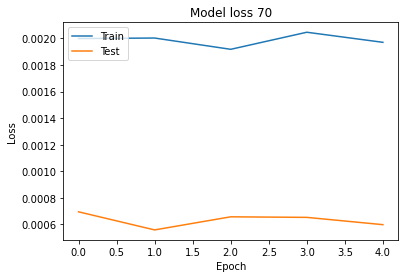

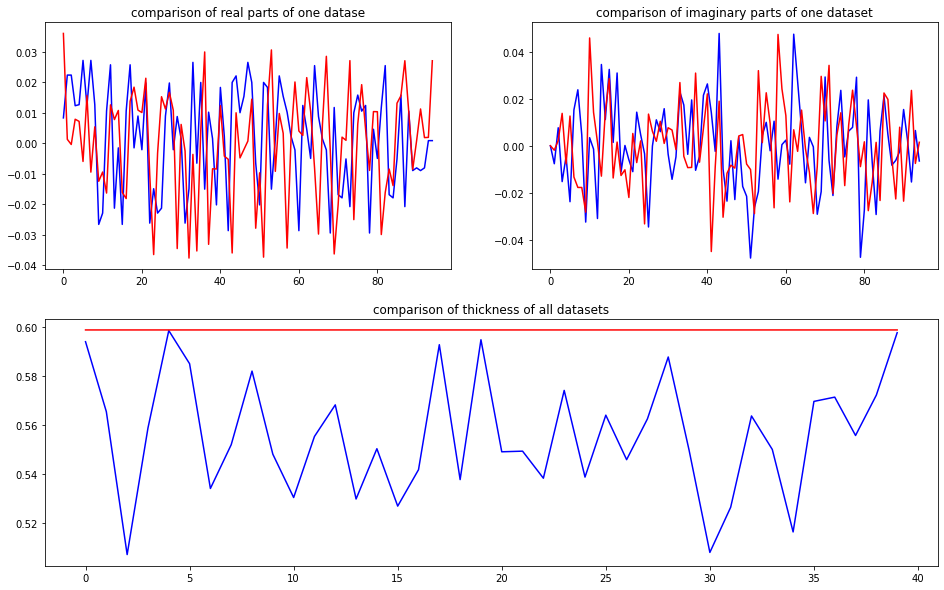

predicted thickness: 0.5986754


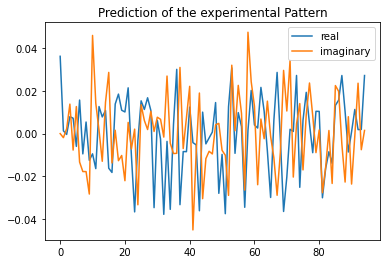

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=598.6753702163696
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03604111+0.00000000e+00j  0.00045722-2.07392336e-03j
  0.00045722+2.07392336e-03j  0.01176987+1.35359368e-02j
  0.00629195+5.03250584e-03j -0.00772711+1.51755209e-02j
  0.01176987-1.3

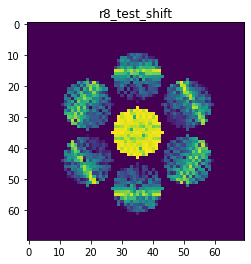

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9820862997032326
>>>replaced the 71. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 747ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 5.5630e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.0820e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 690ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.2984e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 6.2403e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.4844e-04 - val_acc: 1.0000


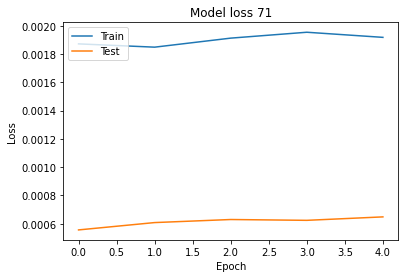

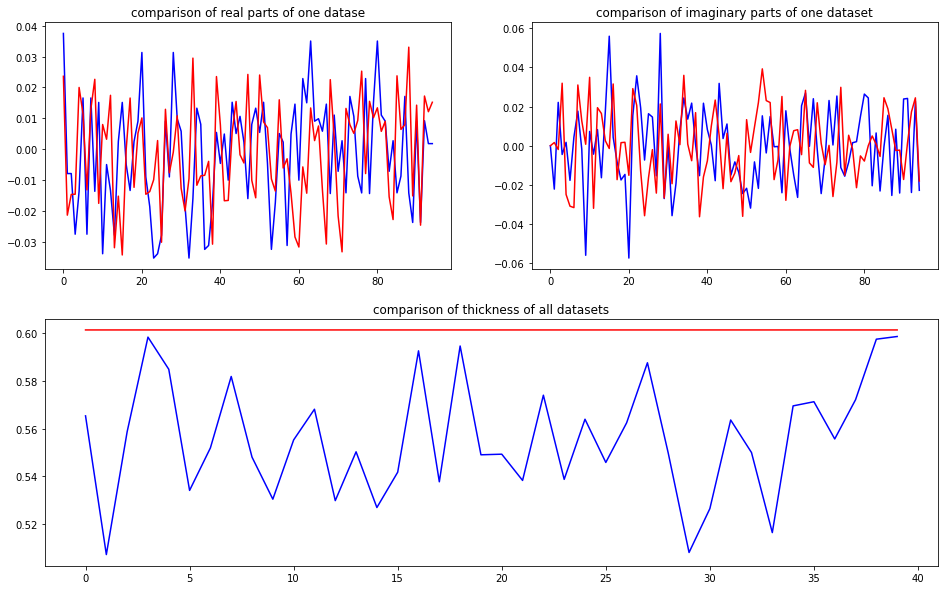

predicted thickness: 0.60143185


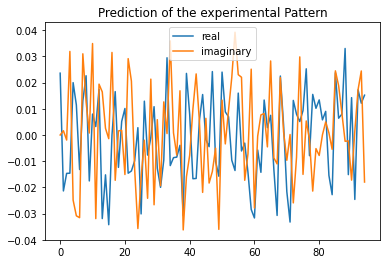

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=601.4318466186523
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02361266+0.j         -0.01801199+0.00177598j -0.01801199-0.00177598j
 -0.01388946+0.03175209j  0.02131816-0.01878827j  0.01226249-0.03094017j
 -0.01388946-0.03175209j  0.01226249+0.03

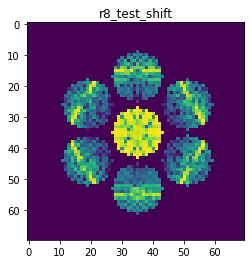

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9575304503842247
>>>replaced the 72. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 751ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 5.6621e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 7.6715e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 5.8038e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 5.6128e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.3922e-04 - val_acc: 1.0000


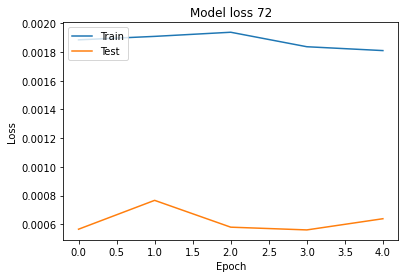

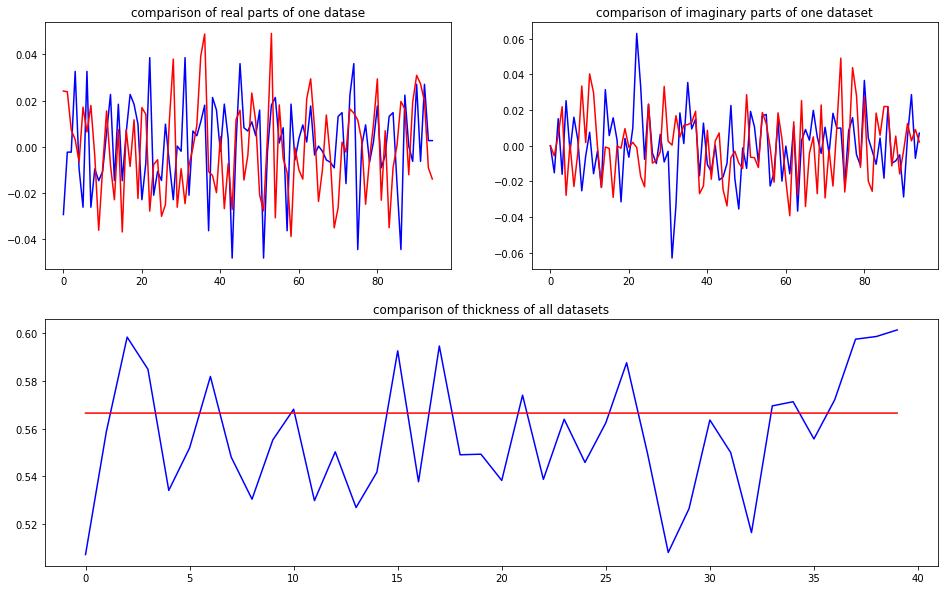

predicted thickness: 0.5665067


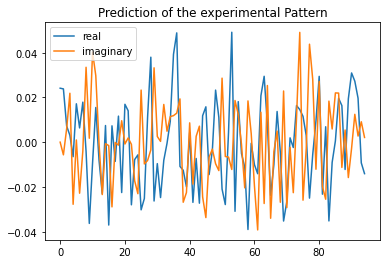

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=566.5066838264465
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02412144+0.j          0.01552609-0.00582642j  0.01552609+0.00582642j
  0.00471424+0.02233641j -0.00530366-0.03061905j  0.01751899+0.00243958j
  0.00471424-0.02233641j  0.01751899-0.00

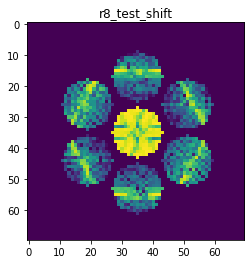

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9591428218684791
>>>replaced the 73. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 757ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 6.0397e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 5.7939e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 7.3986e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.7897e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 6.0393e-04 - val_acc: 1.0000


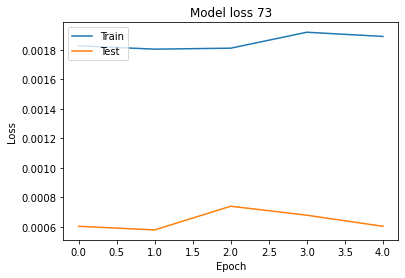

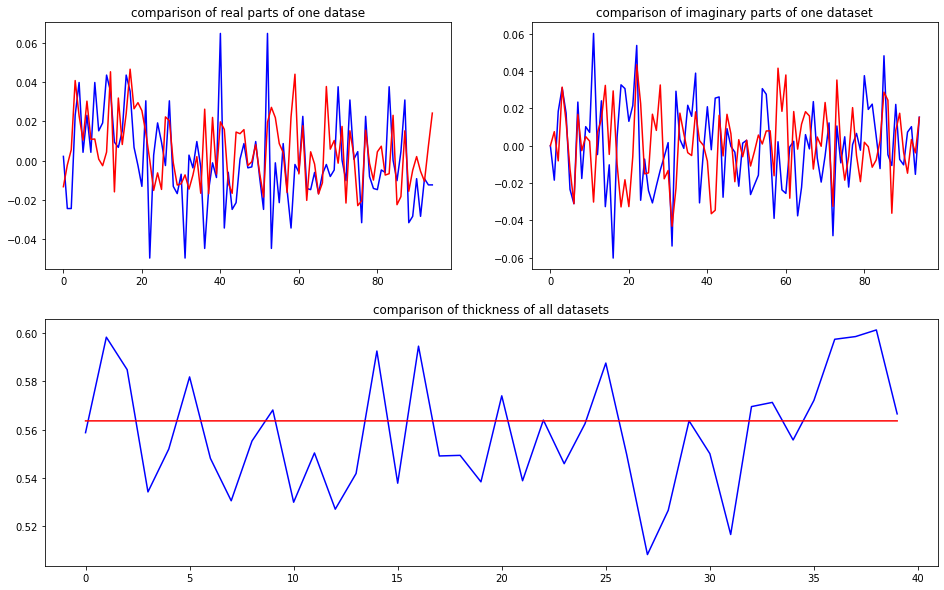

predicted thickness: 0.56359416


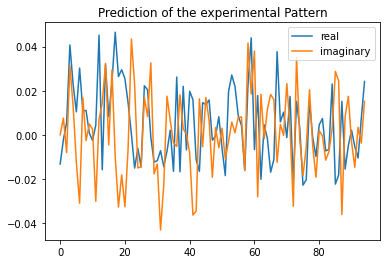

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=563.5941624641418
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01327661+0.j          0.00166113+0.00782973j  0.00166113-0.00782973j
  0.03545863+0.03126727j  0.01689661+0.00780803j  0.0106253 -0.01467737j
  0.03545863-0.03126727j  0.0106253 +0.01

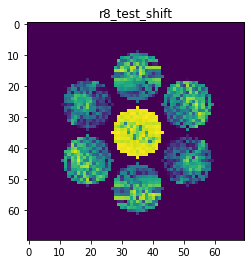

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9776508784750638
>>>replaced the 74. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 748ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 7.4692e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.0250e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 5.5771e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.6310e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 706ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 5.8971e-04 - val_acc: 1.0000


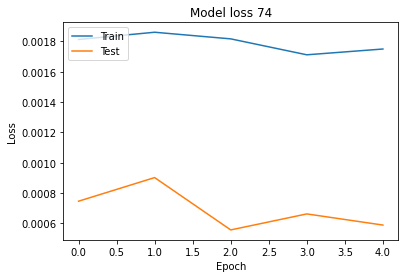

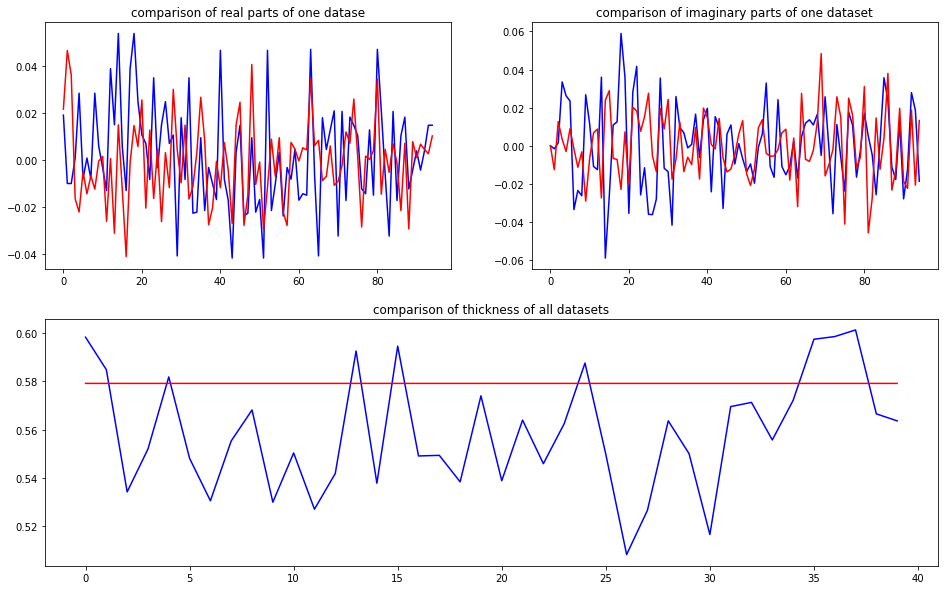

predicted thickness: 0.57918876


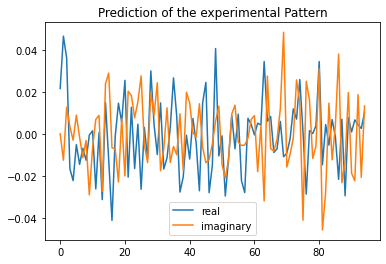

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=579.1887640953064
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02154558+0.00000000e+00j  0.04130462-1.26125365e-02j
  0.04130462+1.26125365e-02j -0.01558945+2.54744524e-03j
 -0.01741198+8.87142960e-05j -0.00600102+1.01169506e-02j
 -0.01558945-2.5

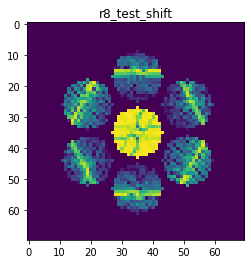

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9685603032602303
>>>replaced the 75. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 755ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 5.9926e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 695ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.3791e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 7.3720e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 703ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 5.8717e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.4870e-04 - val_acc: 1.0000


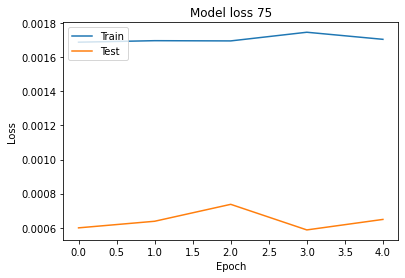

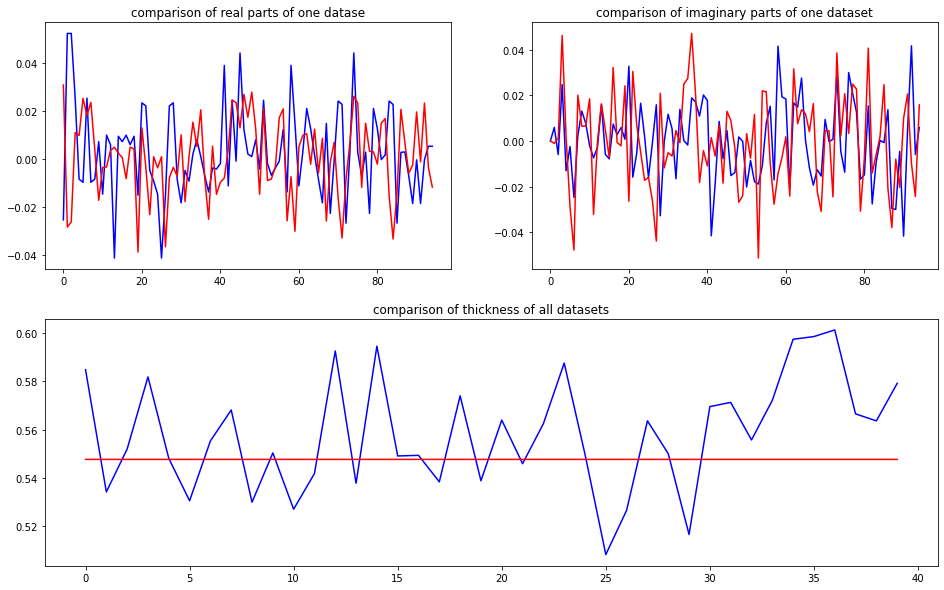

predicted thickness: 0.5475658


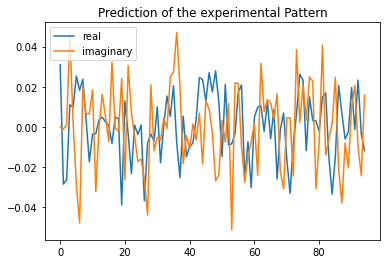

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=547.5658178329468
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03086611+0.j         -0.02746504-0.00109326j -0.02746504+0.00109326j
  0.01455837+0.04706498j  0.0067769 -0.00226222j  0.02442713-0.02439472j
  0.01455837-0.04706498j  0.02442713+0.02

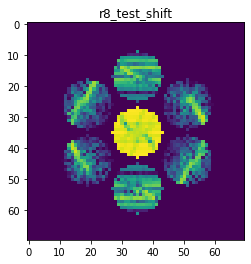

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9868234481119045
>>>replaced the 76. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 836ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.1907e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 716ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.1889e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 7.2101e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 711ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 5.5766e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 718ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.6335e-04 - val_acc: 1.0000


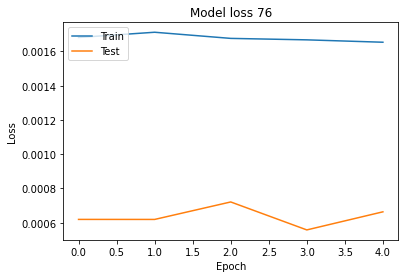

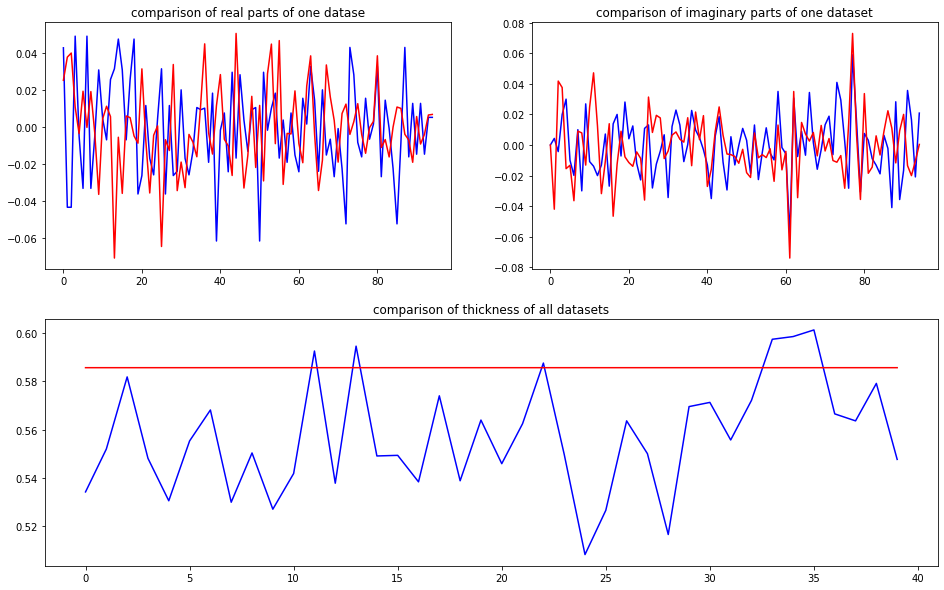

predicted thickness: 0.58572674


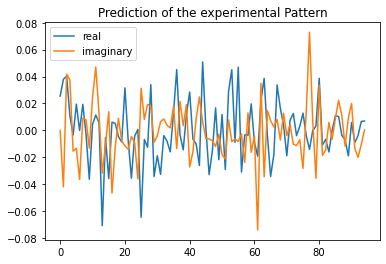

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=585.7267379760742
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02545412+0.j          0.03896589-0.04186309j  0.03896589+0.04186309j
  0.00537235+0.03699049j -0.00330954-0.01168637j  0.0194241 -0.01116192j
  0.00537235-0.03699049j  0.0194241 +0.01

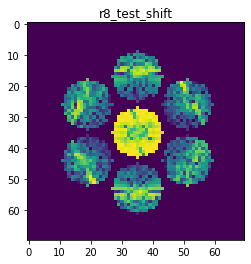

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9536803379700972
>>>replaced the 77. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 732ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 7.1794e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 6.4717e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.4320e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.4939e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.2192e-04 - val_acc: 1.0000


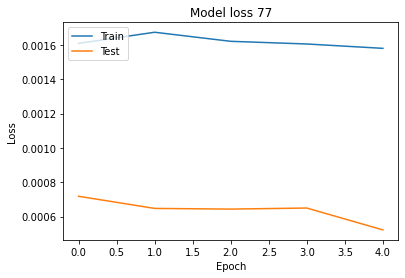

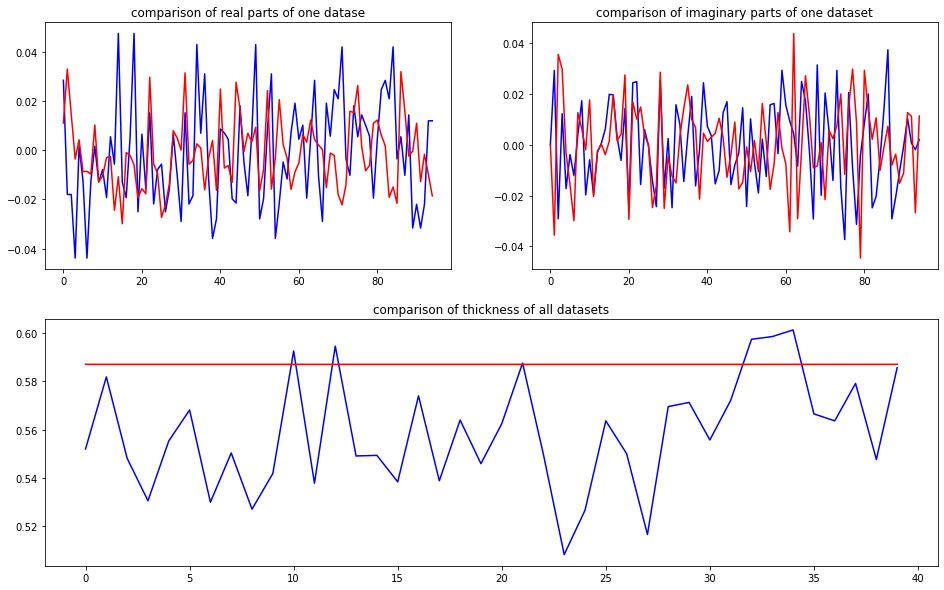

predicted thickness: 0.5871382


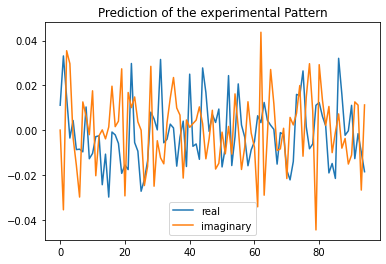

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=587.1381759643555
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01112693+0.00000000e+00j  0.02397703-3.55070159e-02j
  0.02397703+3.55070159e-02j -0.00598607+2.97821537e-02j
  0.00731581-4.89735464e-03j -0.00917983-1.41410753e-02j
 -0.00598607-2.9

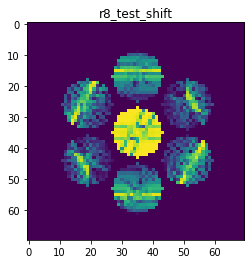

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9848329210241319
>>>replaced the 78. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.9617e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 693ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.7555e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 6.1540e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 696ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.3109e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 5.6909e-04 - val_acc: 1.0000


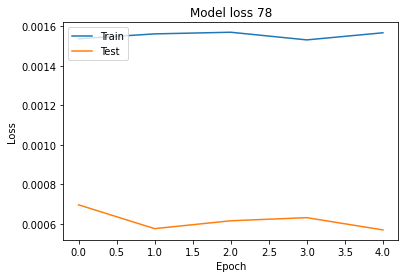

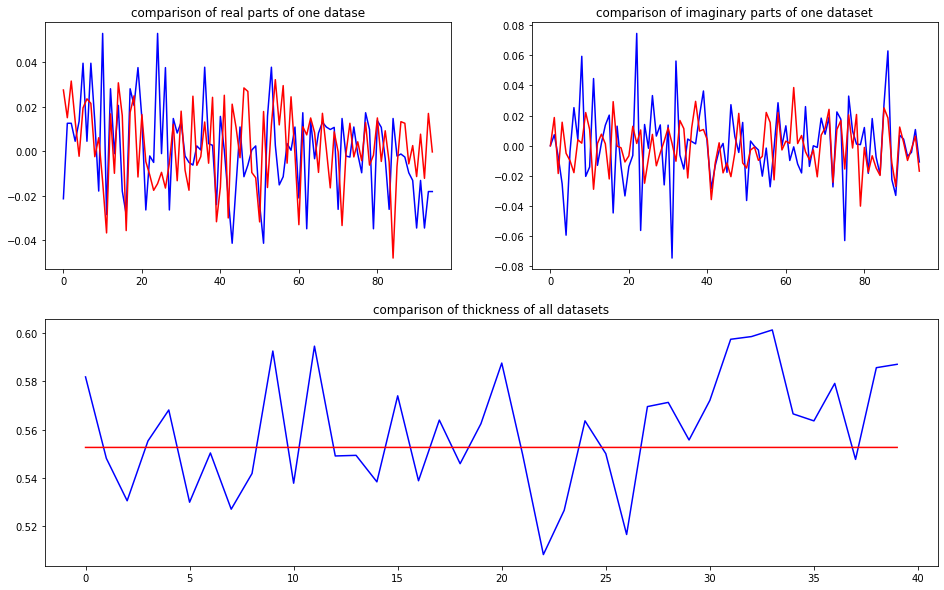

predicted thickness: 0.5525484


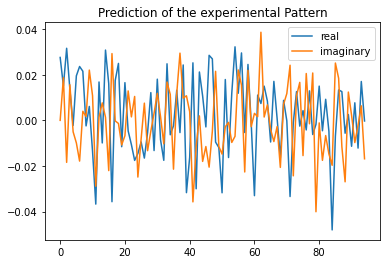

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=552.5484085083008
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02759162+0.00000000e+00j  0.02336633+1.85727207e-02j
  0.02336633-1.85727207e-02j  0.01861818+1.67348133e-02j
 -0.00233313-3.36416083e-03j  0.02053263-6.92504202e-03j
  0.01861818-1.6

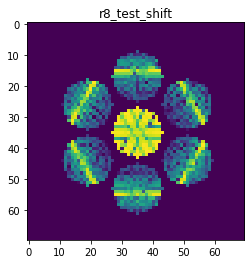

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.95468553241862
>>>replaced the 79. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 749ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.7576e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 697ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.9077e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.2792e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 701ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.7996e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 707ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.5906e-04 - val_acc: 1.0000


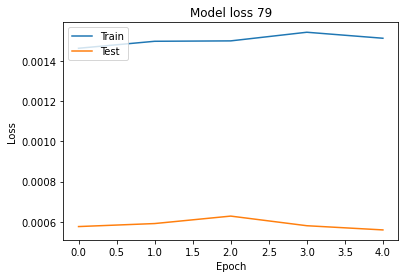

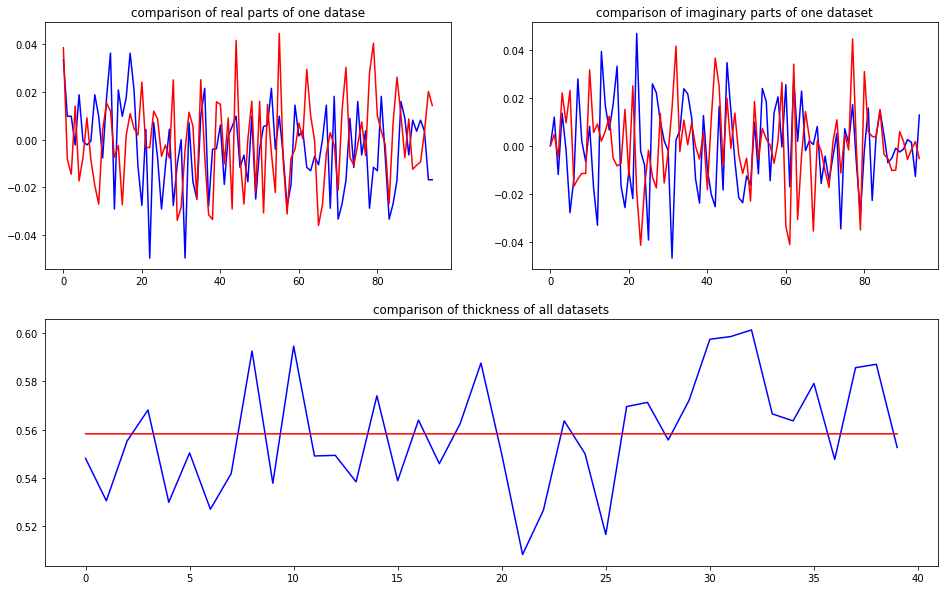

predicted thickness: 0.5582063


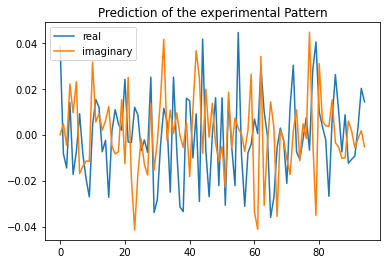

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=558.20631980896
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.03845567+0.j         -0.01140334+0.00468962j -0.01140334-0.00468962j
  0.01154906+0.01946802j -0.01827939+0.01051516j -0.00790573+0.01844305j
  0.01154906-0.01946802j -0.00790573-0.0184

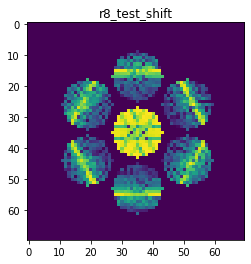

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9647412502273495
>>>replaced the 80. dataset and train: 
Epoch 1/5
5/5 [==============================] - 6s 893ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.8557e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 726ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.5802e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 6.7637e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 715ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.5621e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 721ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.1353e-04 - val_acc: 1.0000


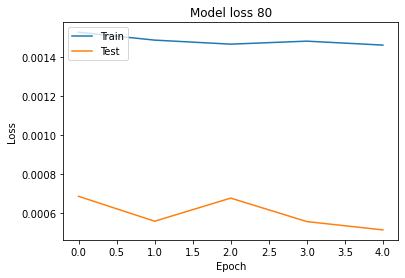

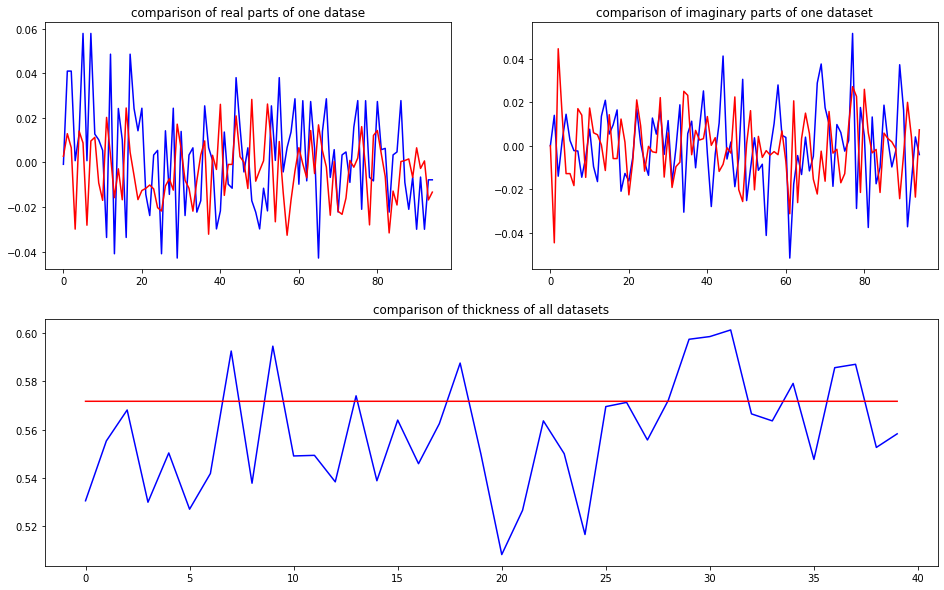

predicted thickness: 0.5717456


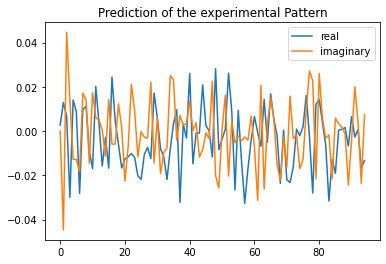

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=571.7455744743347
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 2.73512537e-03+0.j          9.72017553e-03-0.04468493j
  9.72017553e-03+0.04468493j -2.90714344e-02+0.01620065j
  1.26531557e-02-0.01346693j  9.16500855e-03-0.01495194j
 -2.90714344e-02

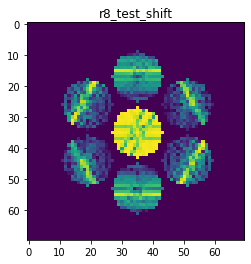

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.980514702274759
>>>replaced the 81. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 743ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.5290e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.1756e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.7252e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 704ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.0761e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.1972e-04 - val_acc: 1.0000


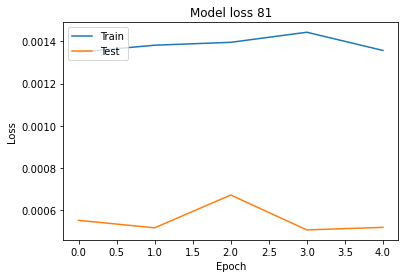

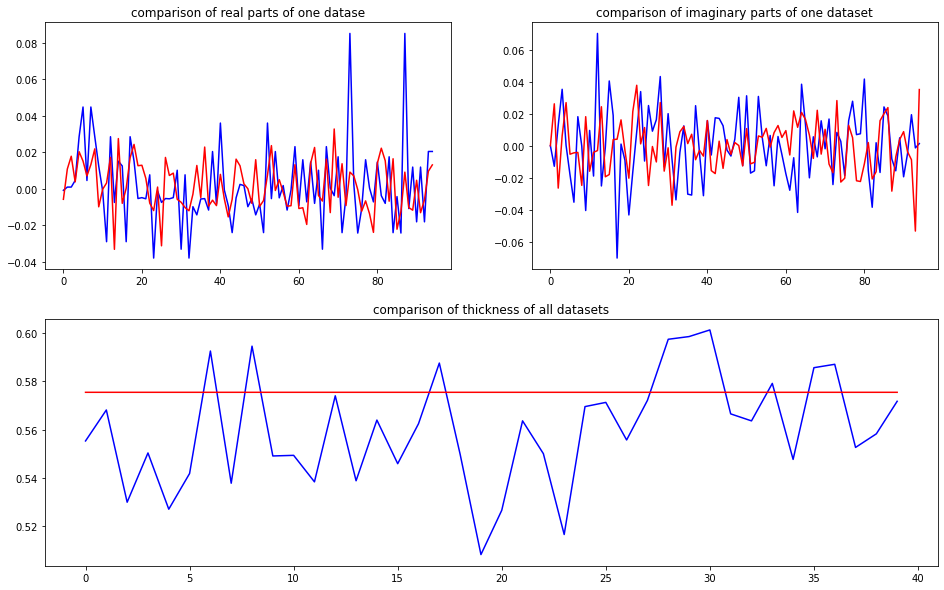

predicted thickness: 0.575483


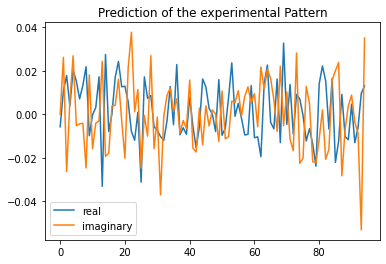

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=575.4830241203308
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00577493+0.j          0.01435789+0.02628649j  0.01435789-0.02628649j
  0.00541238+0.00530654j  0.02112945+0.02582047j  0.01420496-0.00055405j
  0.00541238-0.00530654j  0.01420496+0.00

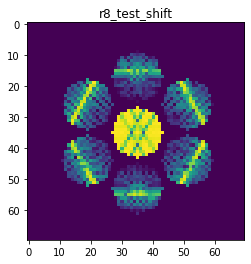

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.978733069709914
>>>replaced the 82. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 747ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.6058e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 5.7040e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 710ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.9189e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 5.7443e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 6.7756e-04 - val_acc: 1.0000


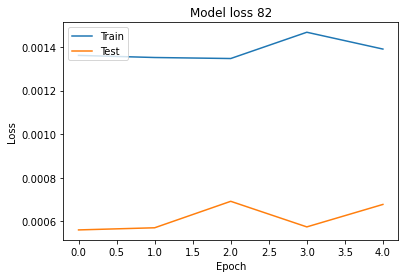

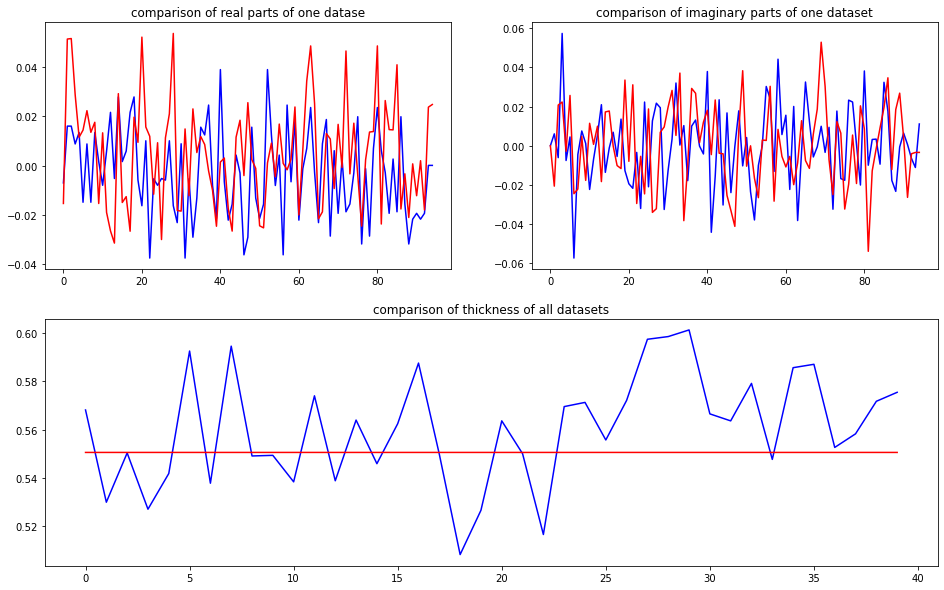

predicted thickness: 0.5504675


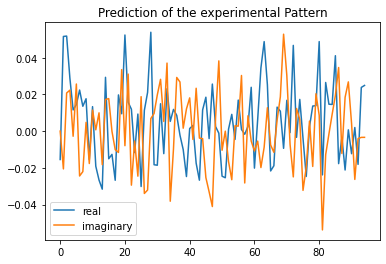

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=550.4674911499023
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.01547774+0.00000000e+00j  0.05167365-2.06822045e-02j
  0.05167365+2.06822045e-02j  0.02562417+2.33776784e-02j
  0.0145866 -3.78936762e-03j  0.01398408+2.38687266e-02j
  0.02562417-2.3

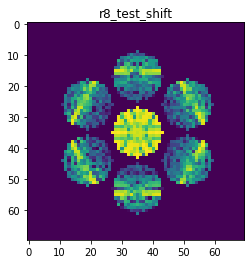

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9907551496748787
>>>replaced the 83. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 742ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.0042e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 694ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.4670e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 5.4188e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 4.7561e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 705ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.7406e-04 - val_acc: 1.0000


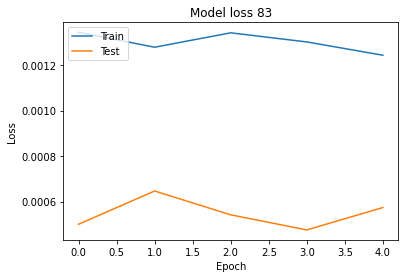

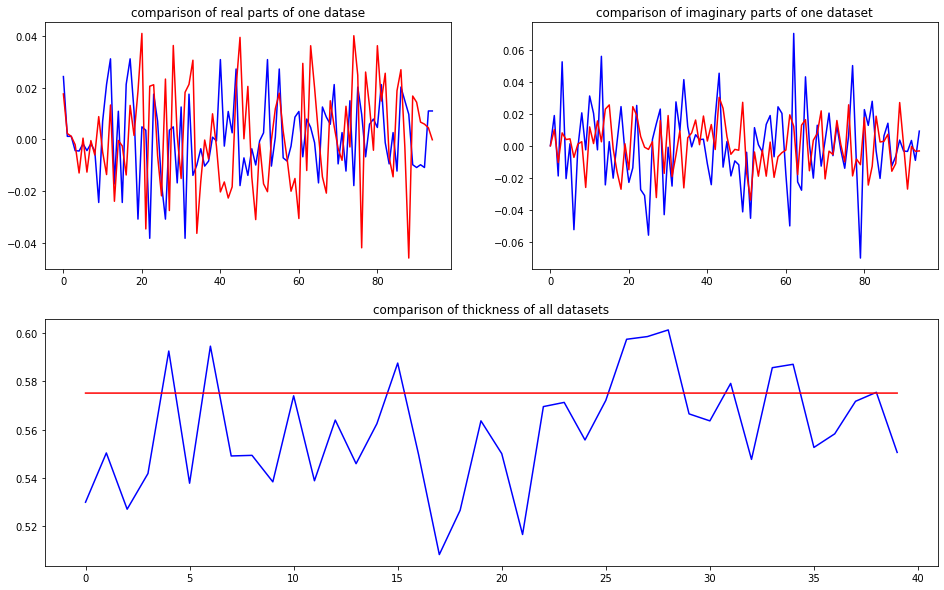

predicted thickness: 0.57515794


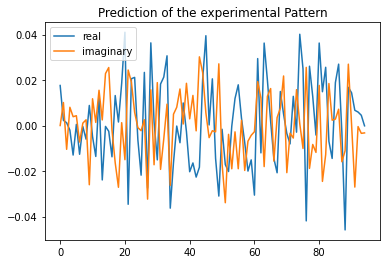

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=575.1579403877258
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 1.76001731e-02+0.00000000e+00j  1.75094983e-03+1.02835619e-02j
  1.75094983e-03-1.02835619e-02j -7.33610615e-03+7.64726242e-03j
 -9.48819285e-03+6.79325429e-04j  2.92643526e-05+1.629804

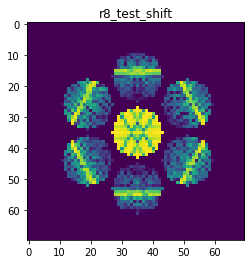

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9853602425997873
>>>replaced the 84. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 749ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.2108e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.7862e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.2349e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.7560e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 700ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 6.7889e-04 - val_acc: 1.0000


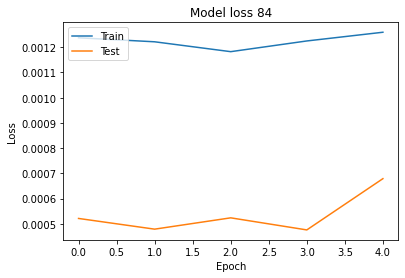

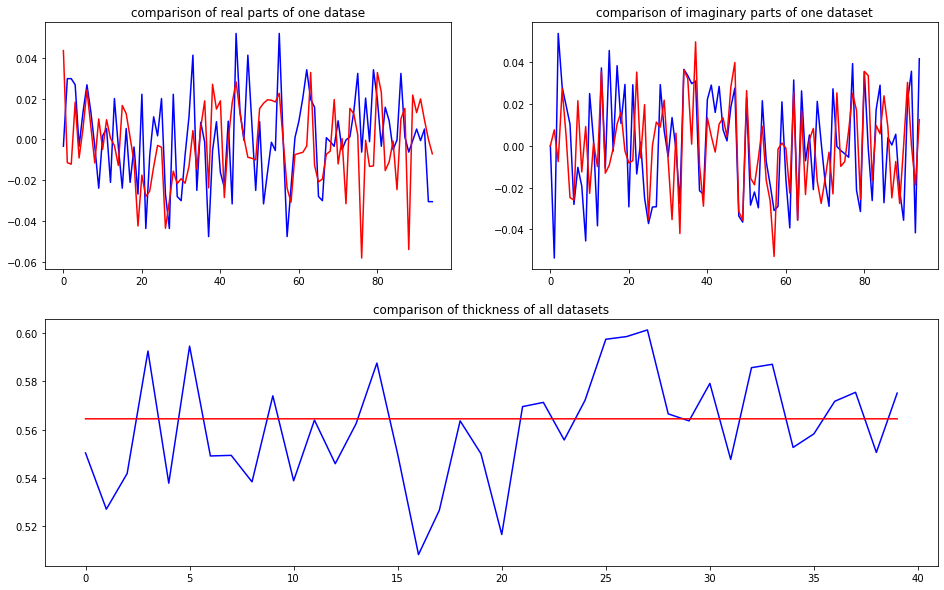

predicted thickness: 0.5644538


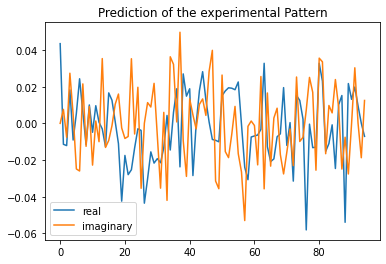

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.4537806510925
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 4.34680358e-02+0.00000000e+00j -1.17602735e-02+7.60366023e-03j
 -1.17602735e-02-7.60366023e-03j  2.12868294e-02+2.66618384e-02j
 -1.02880988e-02+8.75128270e-03j  5.79755357e-03-2.318531

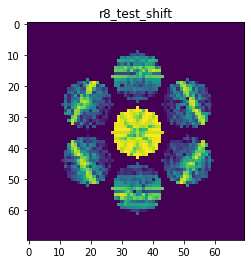

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9736936056664218
>>>replaced the 85. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 758ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.8469e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 5.2731e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.9061e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.0121e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 699ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 4.8175e-04 - val_acc: 1.0000


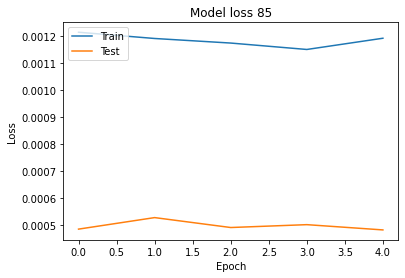

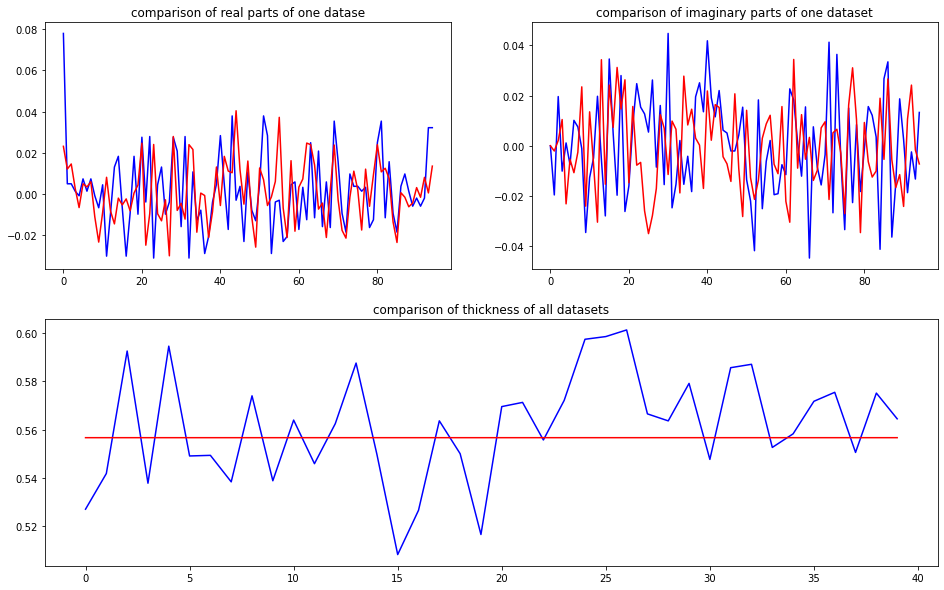

predicted thickness: 0.55660224


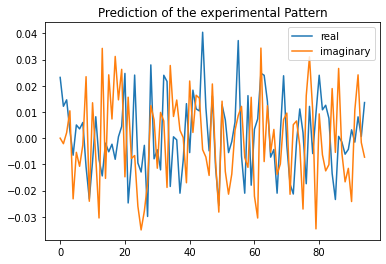

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=556.6022396087646
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02319321+0.j          0.01340443-0.00210737j  0.01340443+0.00210737j
  0.0031956 +0.01058696j -0.00874593-0.02331524j  0.00551823-0.00141466j
  0.0031956 -0.01058696j  0.00551823+0.00

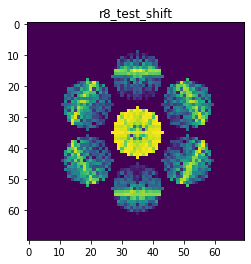

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9649045717321053
>>>replaced the 86. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 760ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.2068e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 708ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.5769e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 4.2386e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 4.4654e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 705ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 4.8716e-04 - val_acc: 1.0000


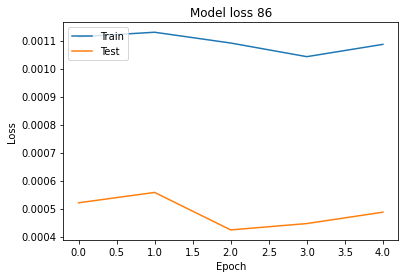

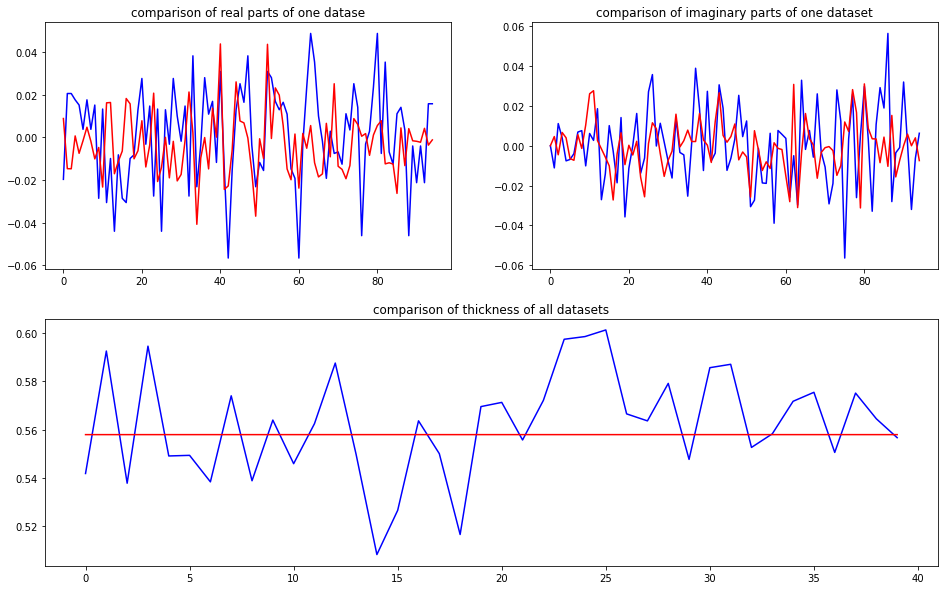

predicted thickness: 0.55787367


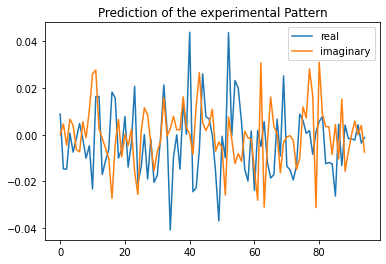

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=557.8736662864685
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00886933+0.00000000e+00j -0.01468593+4.57263901e-03j
 -0.01468593-4.57263901e-03j  0.00275168+6.98020868e-03j
 -0.00876394+2.67180009e-03j -0.00166571-5.99135365e-03j
  0.00275168-6.9

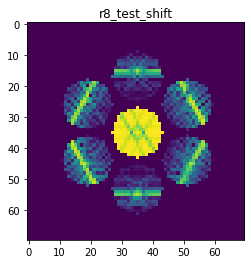

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.988150955832994
>>>replaced the 87. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 794ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 4.7479e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 713ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 5.0001e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 712ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 4.7155e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 720ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 5.3463e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 4.3314e-04 - val_acc: 1.0000


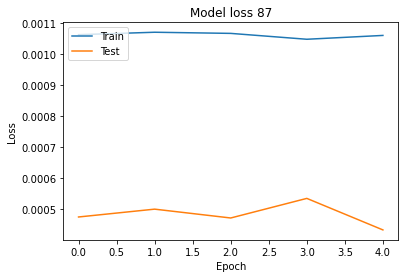

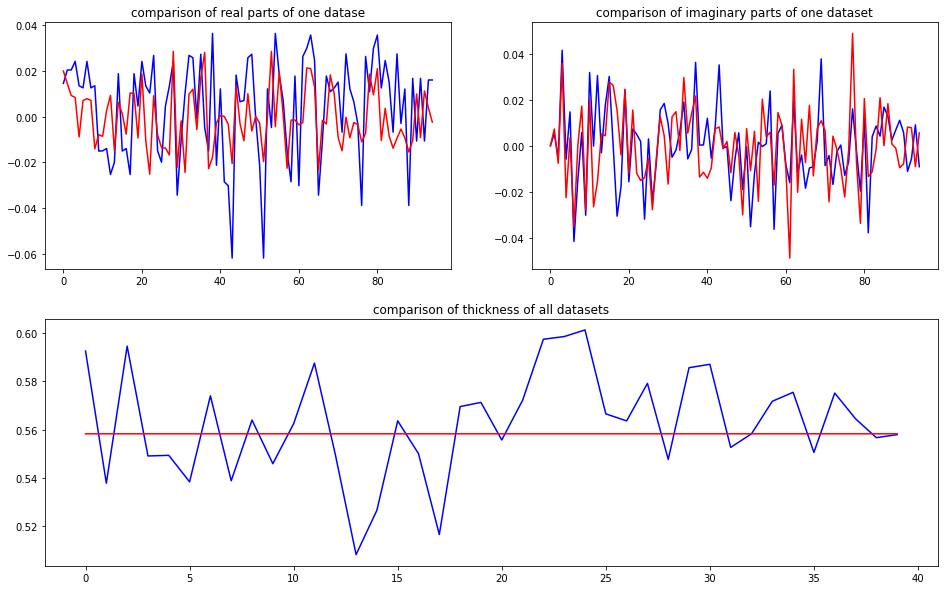

predicted thickness: 0.5582178


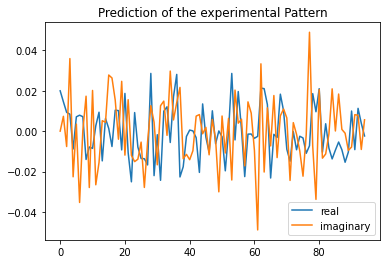

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=558.2178235054016
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02000645+0.j          0.011929  +0.00748426j  0.011929  -0.00748426j
  0.00820672+0.03564692j -0.01141752-0.01996728j  0.00714107+0.00158989j
  0.00820672-0.03564692j  0.00714107-0.00

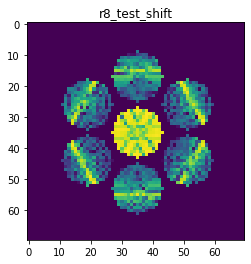

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9612047723424846
>>>replaced the 88. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 769ms/step - loss: 9.7797e-04 - acc: 1.0000 - val_loss: 4.9980e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 703ms/step - loss: 9.9323e-04 - acc: 1.0000 - val_loss: 5.4540e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 706ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 4.1408e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 706ms/step - loss: 9.8939e-04 - acc: 1.0000 - val_loss: 4.6909e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 704ms/step - loss: 9.8504e-04 - acc: 1.0000 - val_loss: 4.7202e-04 - val_acc: 1.0000


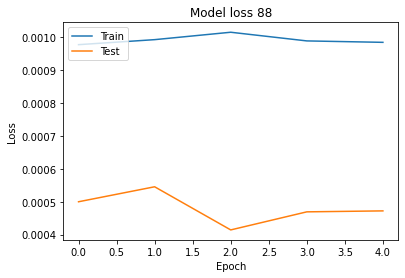

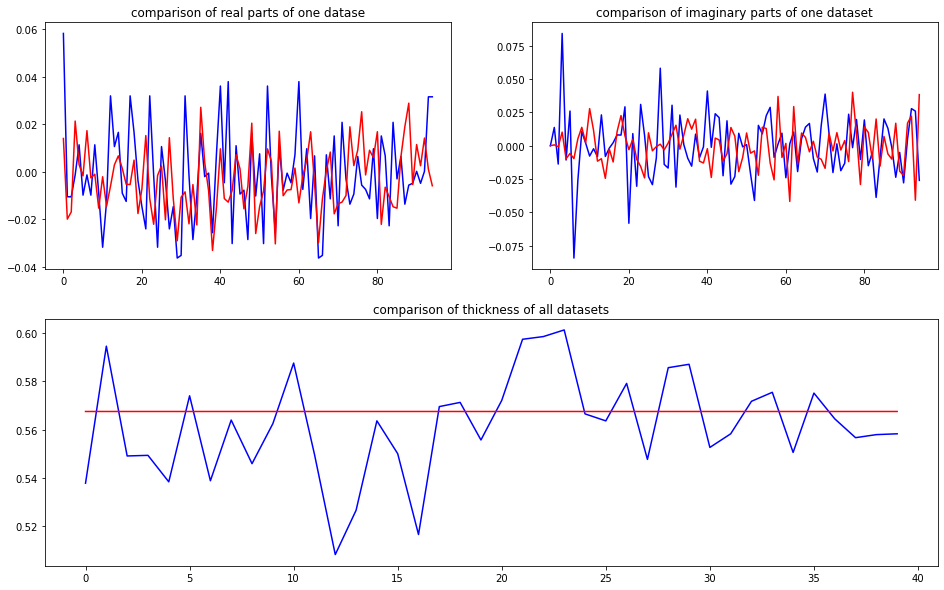

predicted thickness: 0.5675026


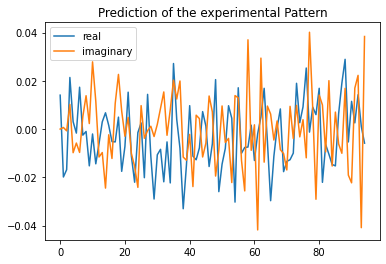

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=567.5026178359985
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01405415+0.j         -0.01835612+0.0006884j  -0.01835612-0.0006884j
  0.01936325+0.00994465j  0.00104296-0.0118087j  -0.00209011-0.00549115j
  0.01936325-0.00994465j -0.00209011+0.005

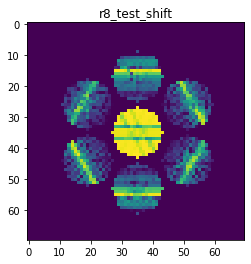

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9878773948376599
>>>replaced the 89. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 9.2305e-04 - acc: 1.0000 - val_loss: 4.2606e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 710ms/step - loss: 9.3052e-04 - acc: 1.0000 - val_loss: 4.8444e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 716ms/step - loss: 9.4032e-04 - acc: 1.0000 - val_loss: 4.7494e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 718ms/step - loss: 9.4104e-04 - acc: 1.0000 - val_loss: 5.4780e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 712ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 4.6363e-04 - val_acc: 1.0000


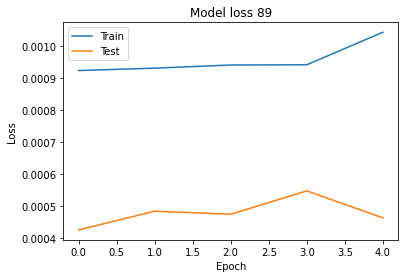

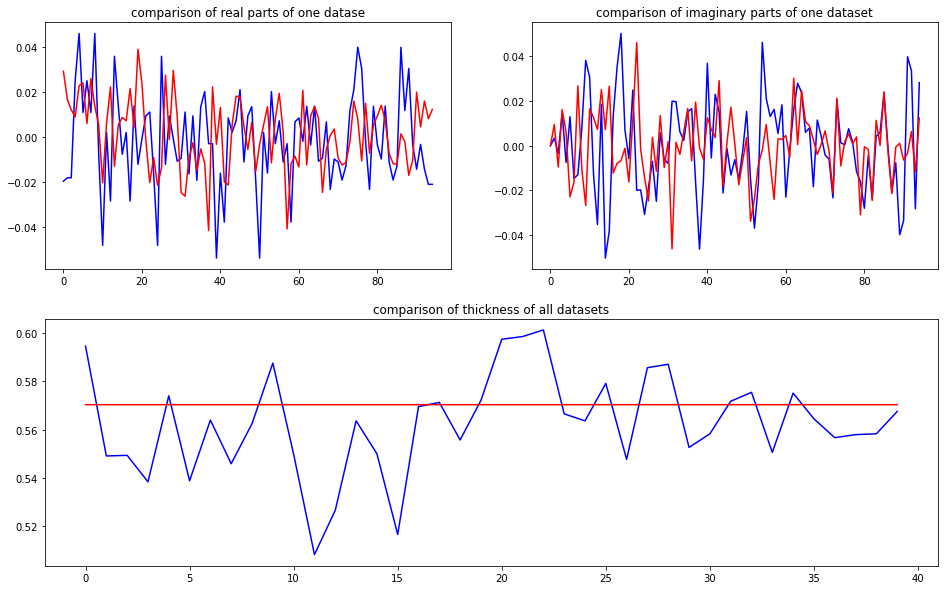

predicted thickness: 0.5703373


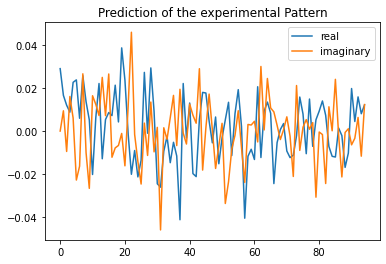

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=570.3372955322266
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02914619+0.00000000e+00j  0.01436593+9.48504126e-03j
  0.01436593-9.48504126e-03j  0.00741261+1.62550854e-02j
  0.0182276 +8.11472139e-03j  0.02485322-2.47954391e-02j
  0.00741261-1.6

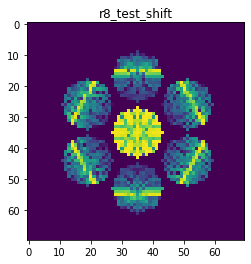

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9684672701336632
>>>replaced the 90. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 9.2023e-04 - acc: 1.0000 - val_loss: 4.4805e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 703ms/step - loss: 8.8635e-04 - acc: 1.0000 - val_loss: 4.7293e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 704ms/step - loss: 8.8389e-04 - acc: 1.0000 - val_loss: 4.2760e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 709ms/step - loss: 8.6635e-04 - acc: 1.0000 - val_loss: 4.3897e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 701ms/step - loss: 8.6752e-04 - acc: 1.0000 - val_loss: 5.1666e-04 - val_acc: 1.0000


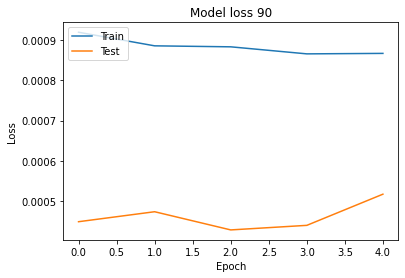

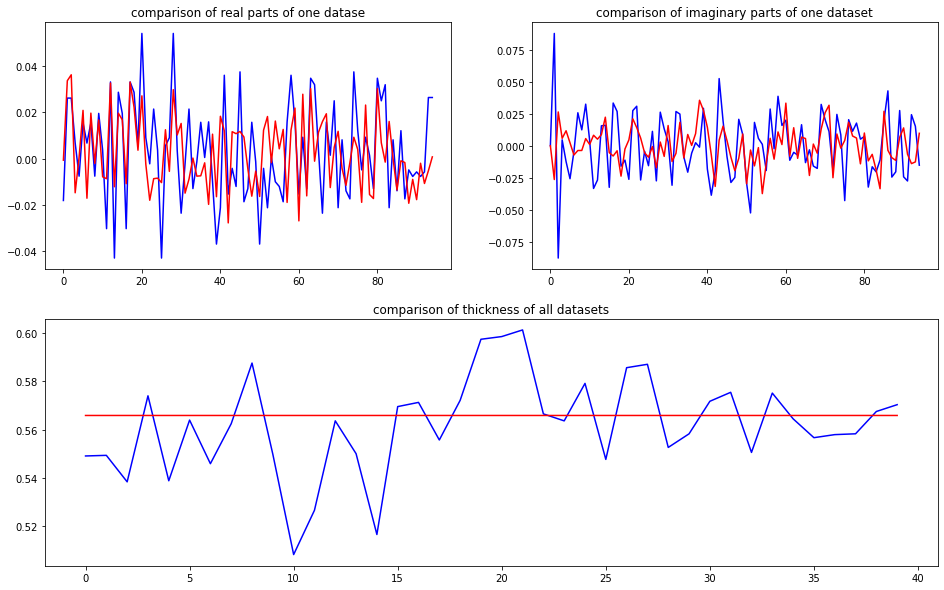

predicted thickness: 0.5658444


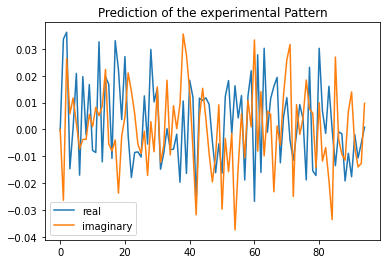

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.8444166183472
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00062505+0.j          0.03498425-0.02642546j  0.03498425+0.02642546j
 -0.01584762+0.00650758j -0.00068348+0.00770851j  0.02027465+0.0030239j
 -0.01584762-0.00650758j  0.02027465-0.003

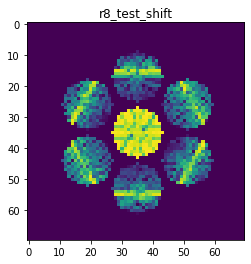

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.964559703795293
>>>replaced the 91. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 756ms/step - loss: 8.6406e-04 - acc: 1.0000 - val_loss: 4.5181e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 712ms/step - loss: 8.5500e-04 - acc: 1.0000 - val_loss: 3.8902e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 708ms/step - loss: 8.5057e-04 - acc: 1.0000 - val_loss: 4.4429e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 707ms/step - loss: 8.4023e-04 - acc: 1.0000 - val_loss: 4.6298e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 709ms/step - loss: 8.9270e-04 - acc: 1.0000 - val_loss: 4.3537e-04 - val_acc: 1.0000


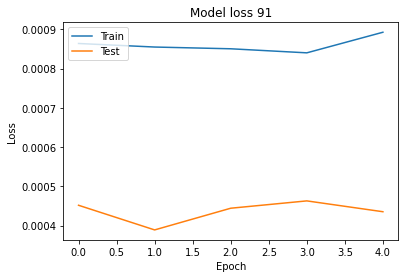

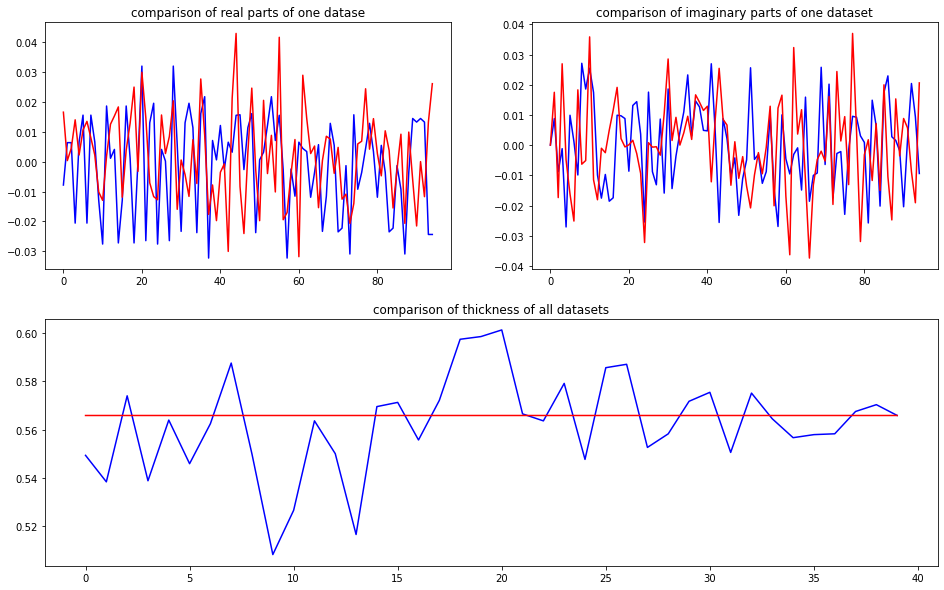

predicted thickness: 0.5658353


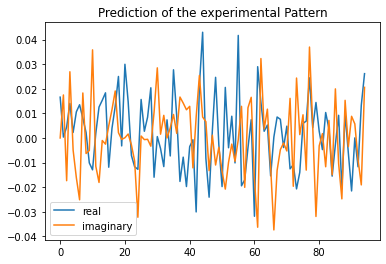

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.8352971076965
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01660677+0.00000000e+00j  0.00241983+1.74326450e-02j
  0.00241983-1.74326450e-02j  0.01379633+2.60375720e-02j
  0.00223908+6.90930290e-04j  0.00932972-1.72427725e-02j
  0.01379633-2.6

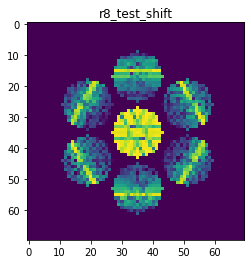

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.962571947877179
>>>replaced the 92. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 761ms/step - loss: 8.1124e-04 - acc: 1.0000 - val_loss: 3.9734e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 711ms/step - loss: 7.8654e-04 - acc: 1.0000 - val_loss: 4.0729e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 702ms/step - loss: 7.7951e-04 - acc: 1.0000 - val_loss: 4.3549e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 709ms/step - loss: 7.9340e-04 - acc: 1.0000 - val_loss: 4.3000e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 712ms/step - loss: 8.0496e-04 - acc: 1.0000 - val_loss: 4.6000e-04 - val_acc: 1.0000


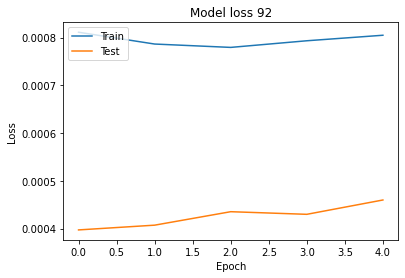

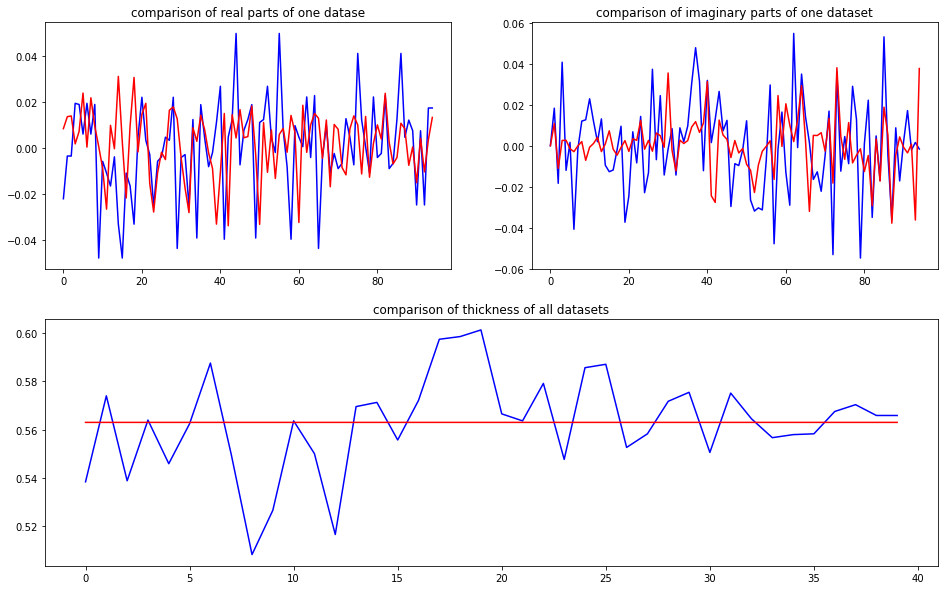

predicted thickness: 0.5629674


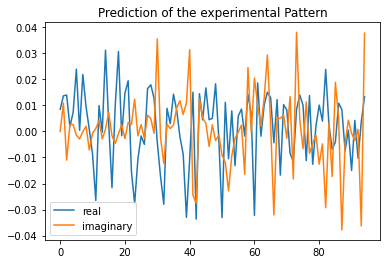

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.9674196243286
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 8.46657623e-03+0.00000000e+00j  1.38164284e-02+1.09531567e-02j
  1.38164284e-02-1.09531567e-02j  1.14803218e-03+2.74599507e-03j
  8.33706302e-03+3.24255088e-04j  2.28860928e-02-6.765716

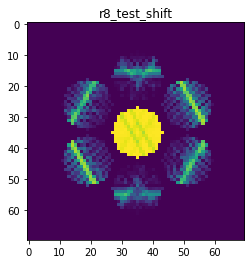

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9963045994602655
>>>replaced the 93. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 758ms/step - loss: 7.6643e-04 - acc: 1.0000 - val_loss: 4.0577e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 710ms/step - loss: 7.3582e-04 - acc: 1.0000 - val_loss: 3.5345e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 710ms/step - loss: 7.2227e-04 - acc: 1.0000 - val_loss: 4.1086e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 709ms/step - loss: 7.0948e-04 - acc: 1.0000 - val_loss: 3.7219e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 711ms/step - loss: 7.0350e-04 - acc: 1.0000 - val_loss: 4.1023e-04 - val_acc: 1.0000


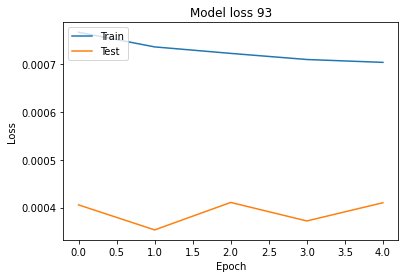

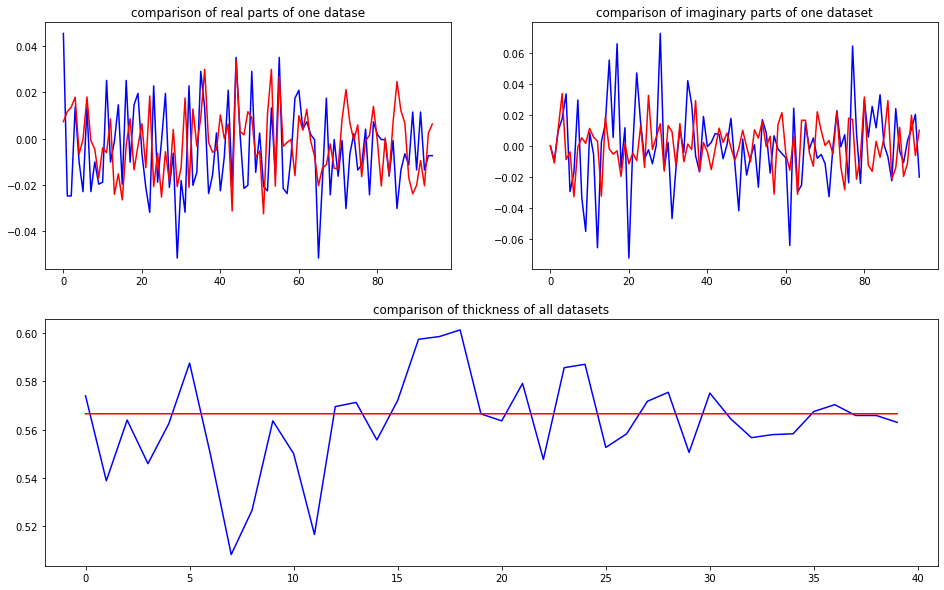

predicted thickness: 0.5665534


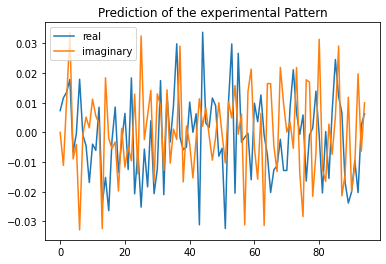

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=566.5534138679504
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.00733158+0.j          0.01260077-0.01110453j  0.01260077+0.01110453j
  0.01789067+0.03325074j -0.00561506-0.00705436j -0.00059616-0.00159042j
  0.01789067-0.03325074j -0.00059616+0.00

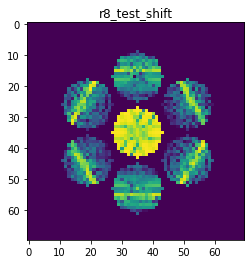

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.951209319637766
>>>replaced the 94. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 757ms/step - loss: 6.9546e-04 - acc: 1.0000 - val_loss: 4.0318e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 708ms/step - loss: 7.0828e-04 - acc: 1.0000 - val_loss: 5.0474e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 707ms/step - loss: 7.5343e-04 - acc: 1.0000 - val_loss: 3.9925e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 700ms/step - loss: 7.8374e-04 - acc: 1.0000 - val_loss: 4.9451e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 704ms/step - loss: 7.4517e-04 - acc: 1.0000 - val_loss: 4.5846e-04 - val_acc: 1.0000


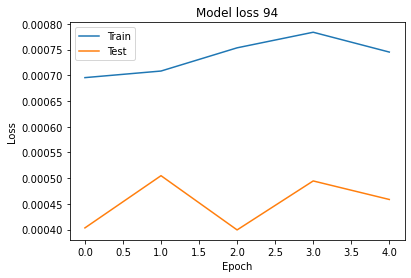

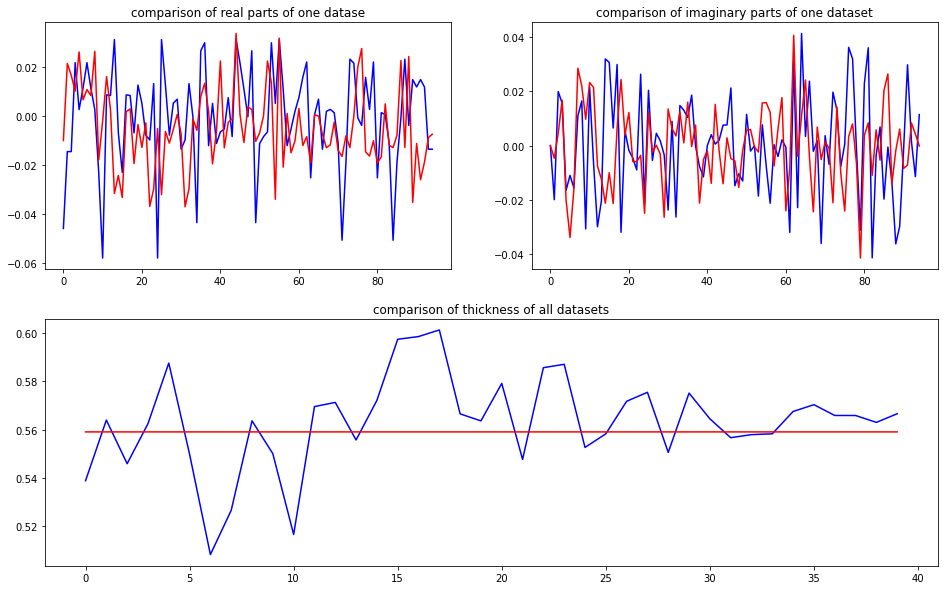

predicted thickness: 0.55900663


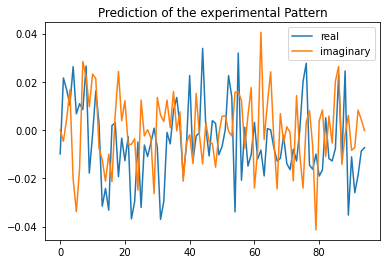

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=559.0066313743591
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00985791+0.j          0.01917645-0.00462003j  0.01917645+0.00462003j
  0.01062105+0.01628784j  0.02641699-0.02099341j  0.00761033-0.03113758j
  0.01062105-0.01628784j  0.00761033+0.03

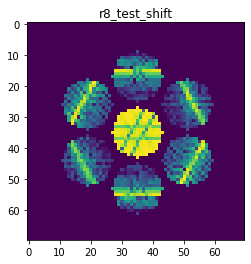

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9744622267642563
>>>replaced the 95. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 775ms/step - loss: 6.7016e-04 - acc: 1.0000 - val_loss: 5.2780e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 716ms/step - loss: 7.1693e-04 - acc: 1.0000 - val_loss: 4.1088e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 726ms/step - loss: 6.3900e-04 - acc: 1.0000 - val_loss: 3.7141e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 710ms/step - loss: 6.4676e-04 - acc: 1.0000 - val_loss: 4.4295e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 714ms/step - loss: 6.1739e-04 - acc: 1.0000 - val_loss: 3.7650e-04 - val_acc: 1.0000


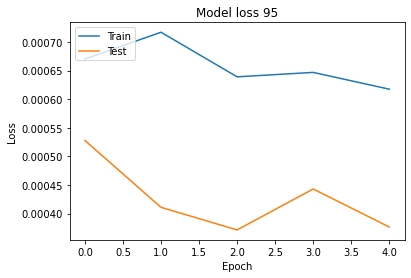

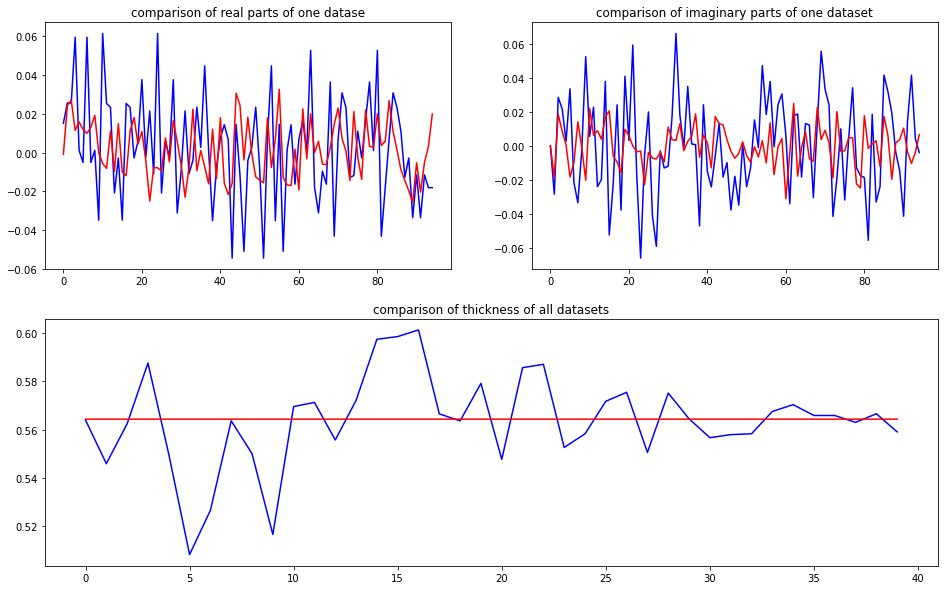

predicted thickness: 0.5643124


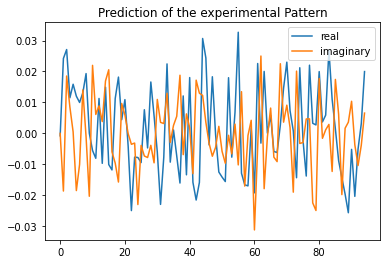

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.3123984336853
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00077559+0.j          0.02561921-0.01857662j  0.02561921+0.01857662j
  0.01074229+0.00926905j  0.01759052+0.00080955j  0.01255646-0.016261j
  0.01074229-0.00926905j  0.01255646+0.0162

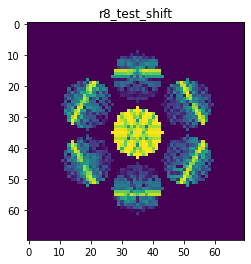

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9794684893787583
>>>replaced the 96. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 750ms/step - loss: 5.4243e-04 - acc: 1.0000 - val_loss: 3.5749e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 705ms/step - loss: 5.3835e-04 - acc: 1.0000 - val_loss: 3.9980e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 707ms/step - loss: 5.5487e-04 - acc: 1.0000 - val_loss: 3.7701e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 711ms/step - loss: 5.5312e-04 - acc: 1.0000 - val_loss: 3.3133e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 711ms/step - loss: 5.8068e-04 - acc: 1.0000 - val_loss: 3.7056e-04 - val_acc: 1.0000


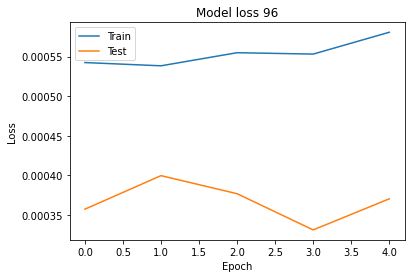

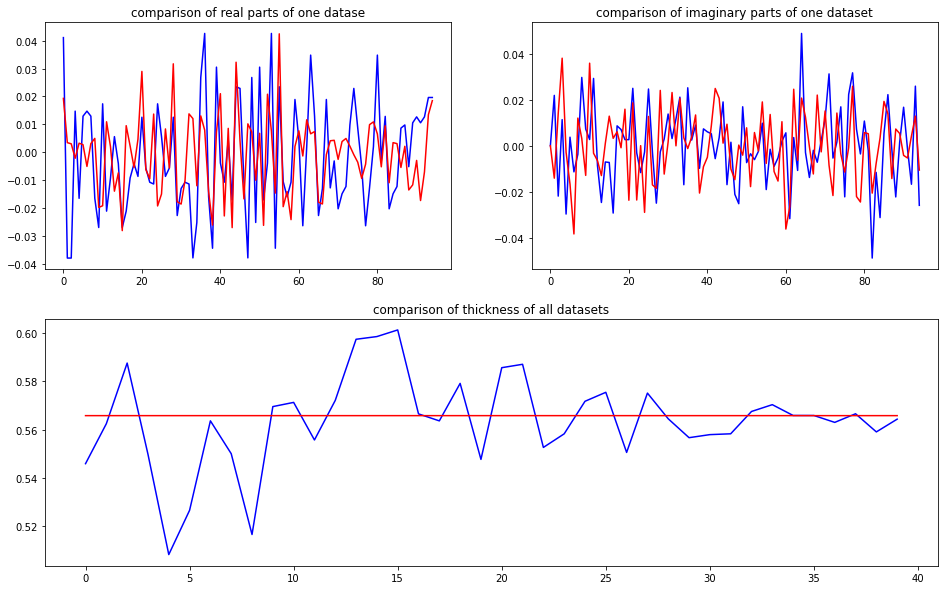

predicted thickness: 0.56577253


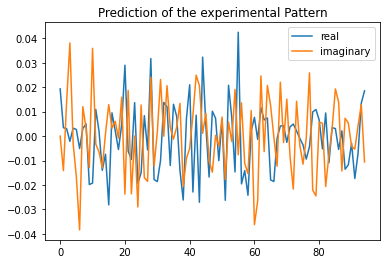

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=565.772533416748
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01930396+0.00000000e+00j  0.00321748-1.41005237e-02j
  0.00321748+1.41005237e-02j -0.00367457+3.82383186e-02j
  0.00410022-2.98474880e-03j  0.00289874-1.43585852e-02j
 -0.00367457-3.82

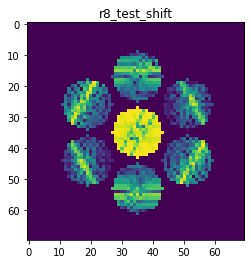

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9549232667969105
>>>replaced the 97. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 754ms/step - loss: 5.1835e-04 - acc: 1.0000 - val_loss: 3.7916e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 3s 702ms/step - loss: 5.1114e-04 - acc: 1.0000 - val_loss: 3.3813e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 711ms/step - loss: 4.8226e-04 - acc: 1.0000 - val_loss: 4.1954e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 705ms/step - loss: 5.2855e-04 - acc: 1.0000 - val_loss: 3.5700e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 710ms/step - loss: 5.3725e-04 - acc: 1.0000 - val_loss: 4.1083e-04 - val_acc: 1.0000


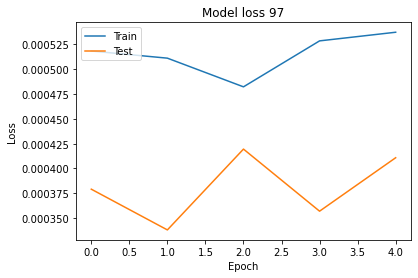

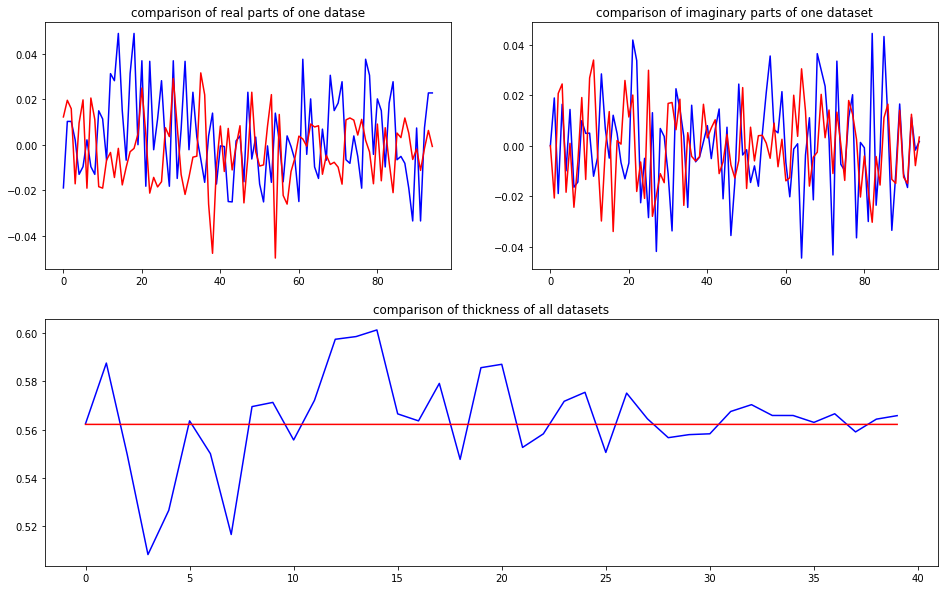

predicted thickness: 0.56213033


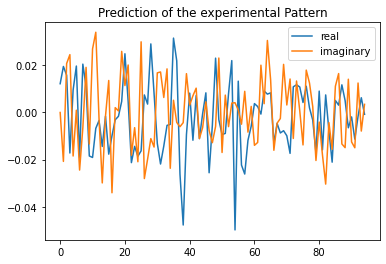

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=562.130331993103
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01219375+0.j          0.01767713-0.02074821j  0.01767713+0.02074821j
 -0.01810902+0.02446336j  0.01032765-0.01879253j  0.02010154+0.00373411j
 -0.01810902-0.02446336j  0.02010154-0.003

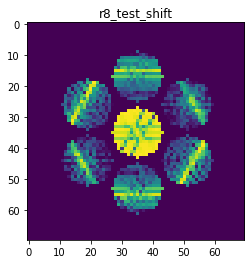

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9797827575114763
>>>replaced the 98. dataset and train: 
Epoch 1/5
5/5 [==============================] - 5s 767ms/step - loss: 5.1940e-04 - acc: 1.0000 - val_loss: 3.7388e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 719ms/step - loss: 4.6592e-04 - acc: 1.0000 - val_loss: 3.7946e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 720ms/step - loss: 4.4952e-04 - acc: 1.0000 - val_loss: 3.5429e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 709ms/step - loss: 4.6930e-04 - acc: 1.0000 - val_loss: 3.4566e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 4s 719ms/step - loss: 4.5516e-04 - acc: 1.0000 - val_loss: 3.3510e-04 - val_acc: 1.0000


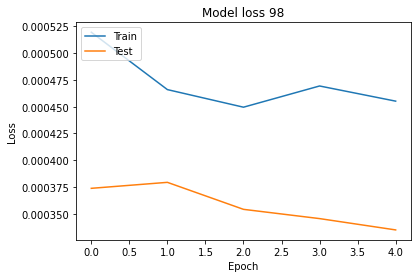

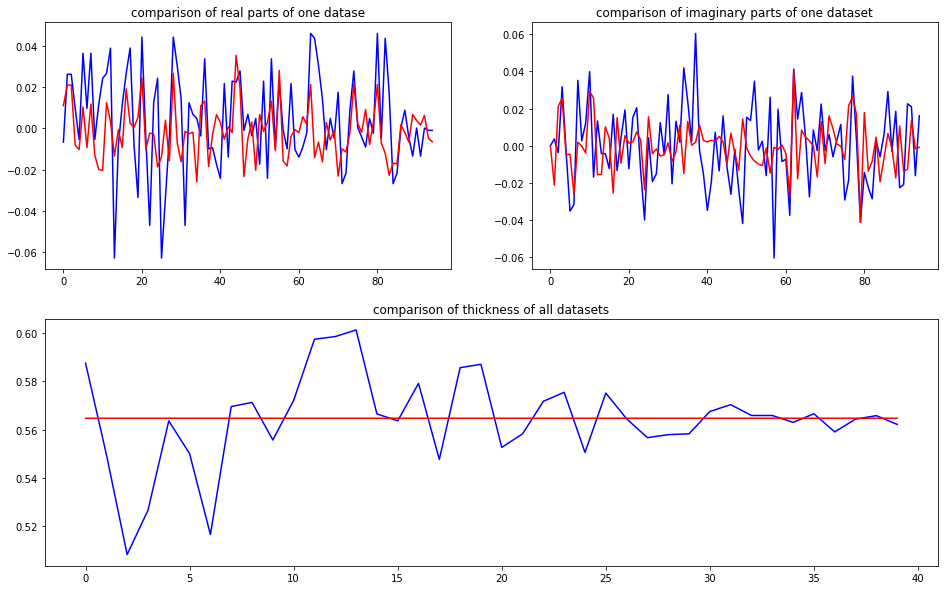

predicted thickness: 0.5646984


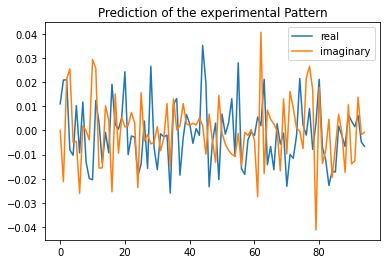

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=564.6983981132507
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.01096777+0.j          0.02086524-0.02124108j  0.02086524+0.02124108j
 -0.00873451+0.02573313j -0.01163563-0.00238099j  0.01100954-0.00321386j
 -0.00873451-0.02573313j  0.01100954+0.00

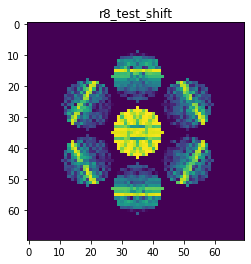

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9775092447750727
>>>replaced the 99. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 767ms/step - loss: 3.9610e-04 - acc: 1.0000 - val_loss: 3.1841e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 706ms/step - loss: 3.9672e-04 - acc: 1.0000 - val_loss: 3.0132e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 4s 716ms/step - loss: 3.7966e-04 - acc: 1.0000 - val_loss: 3.5493e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 4s 714ms/step - loss: 3.8879e-04 - acc: 1.0000 - val_loss: 3.6472e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 706ms/step - loss: 3.7816e-04 - acc: 1.0000 - val_loss: 2.9897e-04 - val_acc: 1.0000


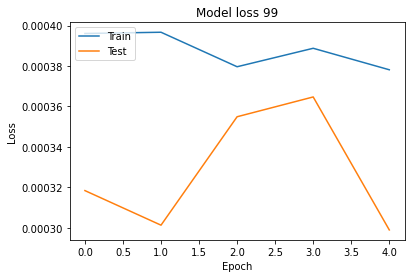

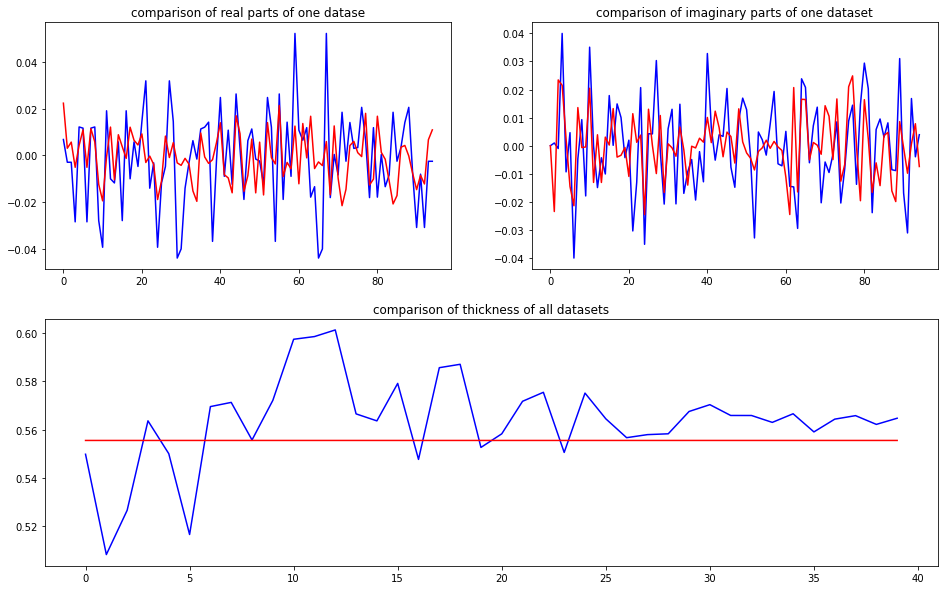

predicted thickness: 0.5554522


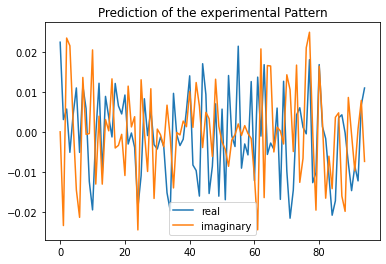

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=555.4522275924683
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[ 0.02239846+0.j          0.0043854 -0.02342834j  0.0043854 +0.02342834j
 -0.00512249+0.02144249j  0.00505155+0.00153128j  0.01122338-0.01405604j
 -0.00512249-0.02144249j  0.01122338+0.01

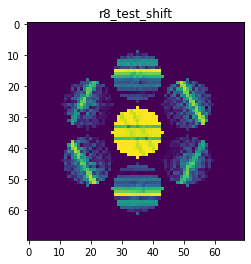

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9840883059491026
>>>replaced the 100. dataset and train: 
Epoch 1/5
5/5 [==============================] - 4s 747ms/step - loss: 3.3696e-04 - acc: 1.0000 - val_loss: 2.8027e-04 - val_acc: 1.0000
Epoch 2/5
5/5 [==============================] - 4s 709ms/step - loss: 3.1695e-04 - acc: 1.0000 - val_loss: 2.9683e-04 - val_acc: 1.0000
Epoch 3/5
5/5 [==============================] - 3s 701ms/step - loss: 3.2357e-04 - acc: 1.0000 - val_loss: 2.8336e-04 - val_acc: 1.0000
Epoch 4/5
5/5 [==============================] - 3s 703ms/step - loss: 3.2685e-04 - acc: 1.0000 - val_loss: 2.8583e-04 - val_acc: 1.0000
Epoch 5/5
5/5 [==============================] - 3s 705ms/step - loss: 3.3015e-04 - acc: 1.0000 - val_loss: 3.1517e-04 - val_acc: 1.0000


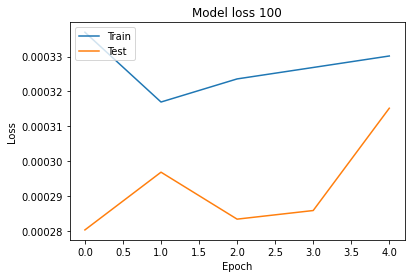

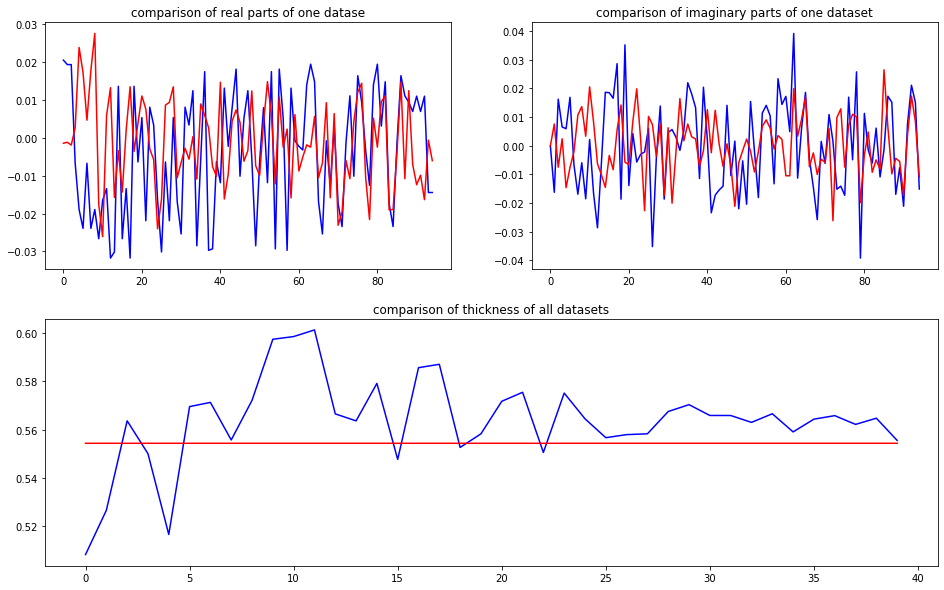

predicted thickness: 0.554274


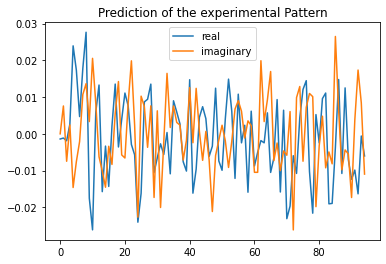

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/ZnO.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//r8_test_shift/r8_test_shift/r8_test_shift.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		100.0
max g vector = 		0.5
max sg = 		0.2
thickness = 		500.0
scan compensation = 		0.81
tilt range (mrads) = 		30.0
disc radius (pixels) = 		8
detector size x = 		70
thickness=554.2740225791931
InputUg = (95,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/ZnO.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 95 different beams

InputUg:
[-0.00141232+0.j         -0.00152407+0.00752047j -0.00152407-0.00752047j
  0.00366897+0.00226844j  0.02576394-0.01411875j  0.01756576-0.00913648j
  0.00366897-0.00226844j  0.01756576+0.00

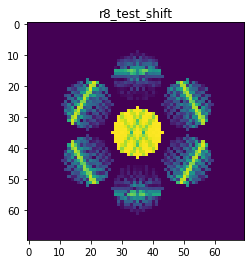

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9894159680193751
Time:  3011.9438648580003


In [13]:
Ug_t_exp_pred_matrix = [] #matrix to save the predicted {Ug,t} of the experimental pattern
Ug_exp_pred_matrix = [] #matrix to save the predicted Ug of the experimental pattern
t_exp_pred_matrix = [] #matrix to save the predicted t of the experimental pattern
simulation_pattern = [] #matrix to save the simulation pattern produced by predicted {Ug,t}
sim_Intensity_matrix = []
scale = 0.1 # scale of random offset 

DoDiverse = True

start = timeit.default_timer()
for i in range(0,trainsize+1):
    
    if i == 0:
        print('>>>train the initial training set:')
        Epochs = 20
    else:
        print('>>>replaced the {0:d}. dataset and train: '.format(i))
        Epochs = 5
    
    # load and compile the model
    model = load_model(name+"_ANN.h5")
    

    # train the model
    model.fit(X_train, y_train, validation_data=(X_test, y_test), batch_size=20, epochs=Epochs)
    #model.fit(X, y, batch_size=40, epochs=20, validation_split=0.2)
    
    # save the trained weigths of the model, delete the existing model
    model.save(name+"_ANN.h5")


    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss {0:d}'.format(i))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
    plt.show()
    plt.close()
    

    # Prediction of the testing set
    y_test_pred = model.predict(X_test)    
    Ug_test_pred_complex = y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
    Ug_test_complex = y_test[:,:2*numUg].reshape(-1,numUg,2)    
    t_test_pred = y_test_pred[:,2*numUg]
    t_test = y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r')
    ax1.set_title('comparison of real parts of one datase')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r')
    ax2.set_title('comparison of imaginary parts of one dataset')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b')
    ax3.plot(t_test_pred[:],'r')
    ax3.set_title('comparison of thickness of all datasets')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    
    # Prediction of the experimental Pattern
    y_exp_pred = model.predict(X_exp)
    Ug_t_exp_pred = y_exp_pred[0,:]
    Ug_exp_pred = Ug_t_exp_pred[0:-1]
    t_exp_pred = Ug_t_exp_pred[-1]
    
    Ug_t_exp_pred_matrix.append(Ug_t_exp_pred)
    Ug_exp_pred_matrix.append(Ug_exp_pred)
    t_exp_pred_matrix.append(t_exp_pred)
    
    if t_exp_pred < 0:
        t_exp_pred = np.random.randint(200,1001)/1000
        print("negative thickness, use random thickness: ", t_exp_pred)
        t_exp_pred = np.random.randint(200,1001)/1000
        Ug_t_exp_pred[-1] = t_exp_pred
    else:
        print("predicted thickness:", t_exp_pred)
 
    
    # plot the results
    plt.plot(Ug_t_exp_pred[0:-1:2],label='real')
    plt.plot(Ug_t_exp_pred[1:-1:2],label='imaginary')
    plt.legend()
    plt.title('Prediction of the experimental Pattern')
    plt.show()
    plt.close()
    
    # diverse the predicted Ug and thickness
    if DoDiverse == True:
        # scale will be reduced by iterations
        scale *= 0.99
        offset_Ug = (np.random.random()*2-1)*scale
        for j in range(len(Ug_t_exp_pred)-1):
            # for real part of Ug
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j]**2 + Ug_t_exp_pred[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j-1]**2 + Ug_t_exp_pred[j]**2)
    
    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(-1), Ug_t_exp_pred[-1])
    
    
    # Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(-1)
    #nlogf_X_sim = nlogf(X_sim)
    
    #load the intensities of simulation pattern from txt.files
    sim_Intensity = lif.LoadIntensity(file = File, test_simulation=True)
    sim_Intensity = sim_Intensity.reshape(-1)
    
    simulation_pattern.append(X_sim)
    sim_Intensity_matrix.append(sim_Intensity)
    print("X_sim.max():",X_sim.max())
    #print("nlogf_X_sim.max():",nlogf_X_sim.max())
        
    
    # replace the training set & testing set with new training set
    if LoadIntensityAsInput == True:
        X_train_new = sim_Intensity
    else:
        X_train_new = X_sim
        
    if i < trainsize:
        X_train[i] = X_train_new               
        y_train[i] = Ug_t_pred_normalized_2real

        if i < testsize: 
            X_test = X_train[:testsize]
            y_test = y_train[:testsize]
        else:
            X_test = X_train[i+1-testsize:i+1]
            y_test = y_train[i+1-testsize:i+1]

stop = timeit.default_timer()
print('Time: ', stop - start)

# IV. Compare

1. diffraction pattern:

Text(0.5, 1.0, 'experimental Pattern')

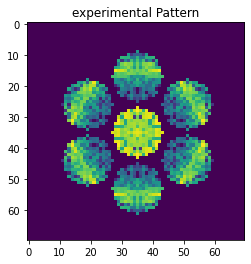

In [14]:
# plot the experimental Pattern:
plt.imshow(nlogf_exp_I[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

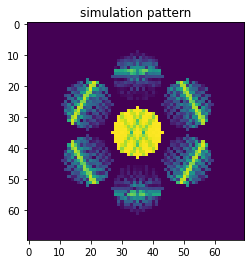

In [15]:
# plot the final simulated Pattern:
simulation_pattern = np.asarray(simulation_pattern)
plt.imshow(nlogf(simulation_pattern[-1].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

2. thickness:

Text(0.5, 0, 'iteration')

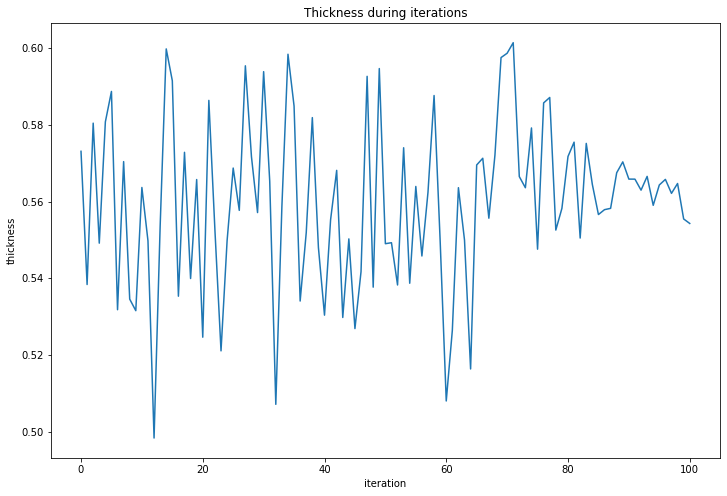

In [16]:
# plot the prediction of thickness during iterations:
plt.figure(figsize=(12,8))
plt.plot(t_exp_pred_matrix)
plt.title("Thickness during iterations")
plt.ylabel("thickness")
plt.xlabel("iteration")

3. R-factors:

In [17]:
exp_I.shape

(4900,)

In [18]:
exp_Intensity.shape

(197, 95)

Text(0.5, 0, 'Iteration')

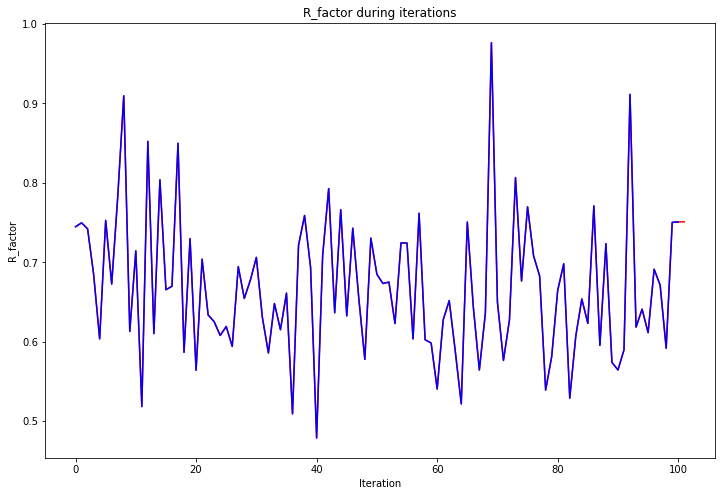

In [19]:
# plot the R-factors during iterations
sim_Intensities = []
R_factors = []
R_factors_integrated = []
    
for i in range(len(simulation_pattern)):
    sim_I_int = simulation_pattern[i].reshape(-1)
    sim_I = sim_Intensity_matrix[i].reshape(-1)
    
    R_integrated = np.sum(np.abs(sim_I_int - exp_I))/np.sum(exp_I)
    R_factors_integrated = np.append(R_factors_integrated, R_integrated)
    
    R = np.sum(np.abs(sim_I - exp_Intensity.reshape(-1)))/np.sum(exp_Intensity.reshape(-1))
    R_factors = np.append(R_factors_integrated, R)

plt.figure(figsize=(12,8))
plt.plot(R_factors[:], "r", label="R_factor")
plt.plot(R_factors_integrated[:], "b", label="R_factor_integrated")
plt.title('R_factor during iterations')
plt.ylabel('R_factor')
plt.xlabel('Iteration')

R_min: 0.4788350063511651


Text(0.5, 1.0, 'simulation pattern')

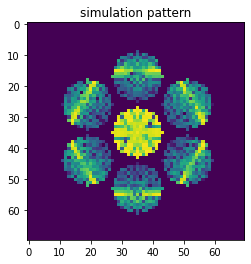

In [20]:
R_argmin = R_factors.argmin()
R_min = R_factors.min()
print("R_min:", R_min)
plt.imshow(nlogf(simulation_pattern[R_argmin].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

In [21]:
t_exp_pred_matrix[R_argmin]

0.53035283